# Preliminary reading of data from Gaelle

In [2]:
import os
import re
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import contextily as cx

Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.
Intel MKL WARNING: Support of Intel(R) Streaming SIMD Extensions 4.2 (Intel(R) SSE4.2) enabled only processors has been deprecated. Intel oneAPI Math Kernel Library 2025.0 will require Intel(R) Advanced Vector Extensions (Intel(R) AVX) instructions.


In [3]:

pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)



In [4]:
path2project = "/Users/don_giraffe/Desktop/TPF/OneDrive_1_2025-6-11"
year_month = '2024-01'

In [5]:
weird_char = {"Ã´": 'ô', "Ã¼": 'ü', "Ã©": 'é', "Ã¨": 'è', "Ãª": 'ê', "Ã¢": 'â', "Ã¶": 'ö', "Ã¤": 'ä', "Ã\xa0": 'à', }

def read_plcs_year_month(path2project: str, year_month: str):
    """
    Reads PLC files in a specific year-month
    :param path2project: path where the data folder is stored
    :param year_month: YYYY-mm
    """
    plcs_in_year_month = [os.path.join(path2project, 'data', year_month, f) for f in os.listdir(os.path.join(path2project, 'data', year_month))]
    plcs = []
    for filename in plcs_in_year_month:
        with open(filename, encoding="ISO-8859-1") as f: 
            rows = [line.replace('\n', '').split(';') for line in f]
            if rows:
                df = pd.DataFrame(rows[1:], columns=rows[0])
                plcs.append(df)
    plcs = pd.concat(plcs, ignore_index=True)
    plcs['StopName'] = plcs.StopName.str.replace('"', '')
    for old, new in weird_char.items():
        plcs['StopName'] = plcs['StopName'].str.replace(old, new, regex=False)

    return plcs

columns_translation = {'Tag': 'Day', 'Kurzbezeichnung': 'Day_Type', 'ZugNr': 'TrainNr', 'FahrtNr': 'Journey', 
                       'FahrtArt': 'Journey_Type', 'FahrtStartSekunden': 'Journey_Start_Seconds',
                       'FahrtEndeSekunden': 'Journey_End_Seconds', 'FahrtStart': 'Journey_Start_Time',
                       'FahrtEnde': 'Journey_End_Time', 'LinienNr': 'Line', 'LinienRichtungText': 'Line_Direction', 
                       'AnkunftSekunden': 'Arrival_Seconds', 'AbfahrtSekunden': 'Departure_Seconds', 
                       'Ein1Klasse': 'On_First_Class', 'Aus1Klasse': 'Off_First_Class', 'Belegung1Klasse': 'Occupancy_First_Class', 
                       'Ein2Klasse': 'On_Second_Class', 'Aus2Klasse': 'Off_Second_Class', 'Belegung2Klasse': 'Occupancy_Second_Class',
                       'DistanzMeter': 'Distance_Meters', 'Quality': 'Quality',
                       'Kurzbezeichnung1': 'Short_Name', 'DidokNr': 'Didok'}

def read_plcgtfs_csv(path2project, year_month):
    df = pd.read_csv(os.path.join(path2project, 'data', 'plcgtfs-' + re.sub("[^0-9]", "", year_month) + '01.csv'), header=1)
    df.rename(columns=columns_translation, inplace=True)

    df['Day'] = pd.to_datetime(df.Day, format="%d.%m.%Y %H:%M:%S") 
    df['Journey_Start_Time'] = pd.to_datetime(df.Journey_Start_Time, format="%d/%m/%Y %H:%M:%S") 
    df['Journey_End_Time'] = pd.to_datetime(df.Journey_End_Time, format="%d/%m/%Y %H:%M:%S") 
    df['Line_Direction'] = df['Line_Direction'].str.replace('?', 'ü')

    return df
    
# plcs = read_plcs_year_month(path2project, year_month)
# #plcs = plcs[plcs.Day.isin(['2024-01-15', '2024-01-16', '2024-01-17', '2024-01-18', '2024-01-19'])]

# occ = read_plcgtfs_csv(path2project, year_month)
# #occ = occ[occ.Day.isin(['2024-01-15', '2024-01-16', '2024-01-17', '2024-01-18', '2024-01-19'])]

In [6]:
# new_column_types = {'int': ['Vehicle', 'JourneySeq', 'Line', 'Journey', 'StopSeq', 'Stop'], 
#                     'float':  ['Longitude', 'Latitude', 'Distance']}

# for new_type, columns in new_column_types.items():
#     for column in columns:
#         if new_type == 'float':
#             plcs[column] = pd.to_numeric(plcs[column], errors='coerce')
#         elif new_type == 'int':
#             plcs[column] = pd.to_numeric(plcs[column], errors='coerce').astype('Int64') 
           
# def transform_time_to_datetime(t, day):
#     # If t is already a full datetime string, just parse it
#     if len(t) > 8:
#         return pd.to_datetime(t)
#     # Otherwise, combine with the day
#     if int(t[:2]) > 23:
#         day += pd.Timedelta('1d')
#         h = str(int(t[:2]) - 24)
#         time_str = h + t[2:]
#     else:
#         time_str = t
#     return pd.to_datetime(day.strftime('%Y-%m-%d') + ' ' + time_str)

# plcs['Day'] = pd.to_datetime(plcs.Day)
# plcs['Punctuality'] = pd.to_timedelta(plcs.Punctuality)
# plcs['Arrival'] = plcs.apply(lambda row : transform_time_to_datetime(row.Arrival, row.Day), axis=1)
# plcs['Departure'] = plcs.apply(lambda row : transform_time_to_datetime(row.Departure, row.Day), axis=1)
# plcs['Punctuality_Seconds'] = [t.total_seconds() for t in plcs.Punctuality]


In [ ]:
# plcs.to_csv('plc_files_Feb.csv', index=False)
plcs = pd.read_csv('data/plc_files.csv')
plcs['Stop'] = plcs['Stop'].replace('', np.nan)
plcs = plcs.dropna(subset=['Stop'])

plcs.head()

,Vehicle,Day,Arrival,Departure,Punctuality,Distance,Latitude,Longitude,DoorCounter,E1,E2,E3,E4,E5,E,D1,D2,D3,D4,D5,D,S1,S2,S3,S4,S5,Data,Timetable,Block,JourneySeq,Line,Journey,StopSeq,Stop,StopName,Punctuality_Seconds
0,560,2024-01-04,2024-01-04 05:41:21,2024-01-04 05:41:21,-1 days +23:57:21,4394.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,1.0,7.0,9999039.0,2.0,850488114.0,"Fribourg/Freiburg, gare routière",-159.0
1,560,2024-01-04,2024-01-04 05:41:48,2024-01-04 05:45:41,0 days 00:01:40,NaN,NaN,NaN,4,1.0,0.0,0.0,0.0,NaN,1.0,1.0,0.0,0.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,1.0,850488114.0,"Fribourg/Freiburg, gare routière",100.0
2,560,2024-01-04,2024-01-04 05:48:01,2024-01-04 05:48:01,0 days 00:02:01,663.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,2.0,858915502.0,"Fribourg, Fries",121.0
3,560,2024-01-04,2024-01-04 05:48:28,2024-01-04 05:48:28,0 days 00:01:28,230.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,3.0,858885802.0,"Fribourg, J. Vogt",88.0
4,560,2024-01-04,2024-01-04 05:49:08,2024-01-04 05:49:08,0 days 00:01:08,321.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,4.0,858915402.0,"Fribourg, Industrie",68.0


### OCC & PLC

In [88]:
# occ.to_csv('occ_files_Feb.csv', index=False)
occ = pd.read_csv('data/occ_files.csv')
occ.head()

,Day,Day_Type,TrainNr,Journey,Journey_Type,Journey_Start_Seconds,Journey_End_Seconds,Journey_Start_Time,Journey_End_Time,Line,Line_Direction,Arrival_Seconds,Departure_Seconds,On_First_Class,Off_First_Class,Occupancy_First_Class,On_Second_Class,Off_Second_Class,Occupancy_Second_Class,Distance_Meters,Quality,Short_Name,Didok,Stop
0,2024-01-01,dim,9999006,9999006,2,16620,16980,2024-01-01 04:37:00,2024-01-01 04:43:00,1,Hin,NaN,16620.0,0.0,0.0,0.0,0.0,0.0,0.0,2248,0,DEPgiv,9999800,999980002.0
1,2024-01-01,dim,9999006,9999006,2,16620,16980,2024-01-01 04:37:00,2024-01-01 04:43:00,1,Hin,16980.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,0,MCar,8587238,858723802.0
2,2024-01-01,dim,61007,61007,1,16981,17460,2024-01-01 04:43:01,2024-01-01 04:51:00,1,Hin,NaN,16981.0,0.0,0.0,0.0,0.0,0.0,0.0,212,1,MCar,8587238,858723802.0
3,2024-01-01,dim,61007,61007,1,16981,17460,2024-01-01 04:43:01,2024-01-01 04:51:00,1,Hin,17010.0,17010.0,0.0,0.0,0.0,0.0,0.0,0.0,197,1,JURcha,8592379,859237902.0
4,2024-01-01,dim,61007,61007,1,16981,17460,2024-01-01 04:43:01,2024-01-01 04:51:00,1,Hin,17040.0,17040.0,0.0,0.0,0.0,0.0,0.0,0.0,168,1,Fleu,8592370,859237002.0


In [9]:
# occ_jan = pd.read_csv('occ_files.csv')
# plcs_jan = pd.read_csv('plc_files.csv')

# # Load February data
# occ_feb = pd.read_csv('occ_files_Feb.csv')
# plcs_feb = pd.read_csv('plc_files_Feb.csv')

# Combine January and February data
# occ = pd.concat([occ_jan, occ_feb], ignore_index=True)
# plcs = pd.concat([plcs_jan, plcs_feb], ignore_index=True)

In [10]:
# occ_jan

In [11]:
# print(occ_feb)

In [12]:
# plcs_jan

In [13]:
# plcs_feb

### Only weekdays

In [14]:
# Convert Day column to datetime for occ data
occ['Day'] = pd.to_datetime(occ['Day'])

# Convert Day column to datetime for plcs data  
plcs['Day'] = pd.to_datetime(plcs['Day'])

# Filter for weekdays only (Monday=0, Sunday=6, so weekdays are 0-4)
occ = occ[occ['Day'].dt.dayofweek < 5]
plcs = plcs[plcs['Day'].dt.dayofweek < 5]

# print(f"OCC data - Original rows: {len(occ)}, Weekdays only: {len(occ_weekdays)}")
# print(f"PLCS data - Original rows: {len(plcs)}, Weekdays only: {len(plcs_weekdays)}")


In [15]:
# plcs = plcs.merge(
#     occ[['Day', 'Journey', 'Stop', 'Didok']],
#     on=['Day', 'Journey', 'Stop'],
#     how='left'
# )

# plcs['Didok'] = plcs['Stop'].astype(str).str[:-2].astype(int)
plcs['Didok'] = plcs.Stop.astype(str).str[:-4].astype(int)
# plcs['Didok'] = pd.to_numeric(plcs['Didok'], errors='coerce').astype('Int64')
plcs


,Vehicle,Day,Arrival,Departure,Punctuality,Distance,Latitude,Longitude,DoorCounter,E1,E2,E3,E4,E5,E,D1,D2,D3,D4,D5,D,S1,S2,S3,S4,S5,Data,Timetable,Block,JourneySeq,Line,Journey,StopSeq,Stop,StopName,Punctuality_Seconds,Didok
0,560,2024-01-04,2024-01-04 05:41:21,2024-01-04 05:41:21,-1 days +23:57:21,4394.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,1.0,7.0,9999039.0,2.0,850488114.0,"Fribourg/Freiburg, gare routière",-159.0,8504881
1,560,2024-01-04,2024-01-04 05:41:48,2024-01-04 05:45:41,0 days 00:01:40,NaN,NaN,NaN,4,1.0,0.0,0.0,0.0,NaN,1.0,1.0,0.0,0.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,1.0,850488114.0,"Fribourg/Freiburg, gare routière",100.0,8504881
2,560,2024-01-04,2024-01-04 05:48:01,2024-01-04 05:48:01,0 days 00:02:01,663.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,2.0,858915502.0,"Fribourg, Fries",121.0,8589155
3,560,2024-01-04,2024-01-04 05:48:28,2024-01-04 05:48:28,0 days 00:01:28,230.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,3.0,858885802.0,"Fribourg, J. Vogt",88.0,8588858
4,560,2024-01-04,2024-01-04 05:49:08,2024-01-04 05:49:08,0 days 00:01:08,321.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,4.0,858915402.0,"Fribourg, Industrie",68.0,8589154
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1967852,855,2024-01-15,2024-01-15 23:18:41,2024-01-15 23:19:04,0 days 00:00:34,140.0,46.615696,7.057483,4,1.0,0.0,0.0,0.0,NaN,1.0,0.0,0.0,1.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,11.0,859328201.0,"Bulle, St-Denis",34.0,8593282
1967853,855,2024-01-15,2024-01-15 23:19:52,2024-01-15 23:19:52,0 days 00:00:52,342.0,46.613355,7.059940,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,12.0,857773001.0,"Bulle, jardin Anglais",52.0,8577730
1967854,855,2024-01-15,2024-01-15 23:20:18,2024-01-15 23:20:26,0 days 00:00:56,233.0,46.611631,7.061700,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,1.0,0.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,13.0,859328801.0,"La Tour-de-Trême, St-Michel",56.0,8593288
1967855,855,2024-01-15,2024-01-15 23:21:28,2024-01-15 23:21:37,0 days 00:01:37,469.0,46.608675,7.065711,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,2.0,0.0,0.0,NaN,2.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,14.0,857773101.0,"La Tour-de-Trême, Centre",97.0,8577731


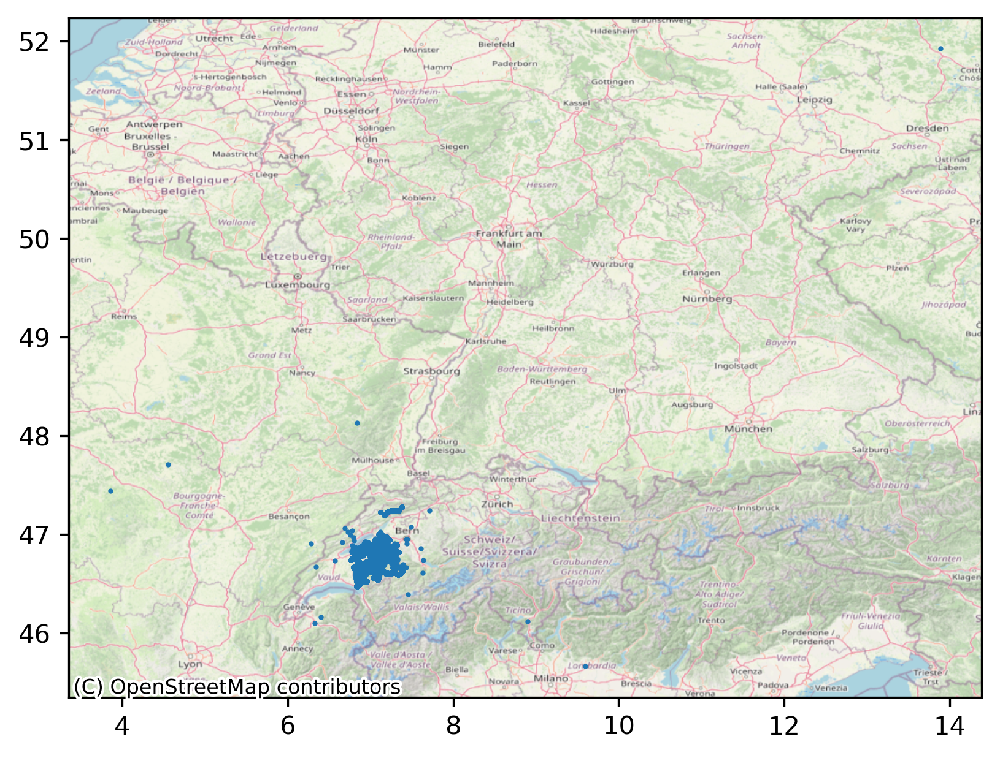

In [16]:
epsg_proj='epsg:4326'
tile_provider= 'OpenStreetMap.CH'
fig, ax = plt.subplots(dpi=300)
ax.scatter(plcs.Longitude, plcs.Latitude, s=1, zorder=2)
cx.add_basemap(ax=ax, crs=epsg_proj, source=tile_provider, zorder=1)
plt.show()

## multi LINE analysis

In [17]:
# # Lines
# ## old code， assume only 2 directions per line
# # plcs['Line'] = plcs['Line'].astype(str).str.replace(' ', '')
# from collections import Counter

# stops_per_line = {}
# journeys_per_line = {}
# for line, df_line in plcs.groupby('Line', as_index=False, group_keys=False):
#     first_stops, last_stops = [], []
#     for (day, journey_id), df_journey in df_line.groupby(['Day', 'Journey'], as_index=False, group_keys=False):
#         if str(int(journey_id))[:2] != '99':
#             first_stops.append(df_journey['StopName'].replace('', np.nan).bfill().iloc[0])
#             last_stops.append(df_journey['StopName'].replace('', np.nan).ffill().iloc[-1])
#     if first_stops + last_stops:
#         filtered_stops = [s for s in first_stops + last_stops if s]
#         most_common_stops = Counter(filtered_stops).most_common(2)
#         first_stop = most_common_stops[0][0]
#         if len(most_common_stops) == 1:
#             print(f"Line {int(line)}: {first_stop}-??")
#         else:
#             last_stop = most_common_stops[1][0]
#             print(f"Line {int(line)}: {first_stop} - {last_stop}")
    
#     stops_per_direction = {1: [] , 2: []}
#     journeys_per_direction = {1: [] , 2: []}
#     valid_journeys = [v for v in df_line.Journey.unique() if str(v)[:2] != '99']
#     for (day, journey), df_journey in df_line[df_line.Journey.isin(valid_journeys)].groupby(['Day', 'Journey'], as_index=False, group_keys=False):
#         if not valid_journeys or df_journey[~pd.isna(df_journey.Stop)].empty:
#             continue
        
#         # Direction 1
#         if df_journey[~pd.isna(df_journey.Stop)].StopName.values[0] == first_stop and df_journey[~pd.isna(df_journey.Stop)].StopName.values[-1] == last_stop:
#             stops_per_direction[1].append(df_journey[~pd.isna(df_journey.Stop)].Stop.unique())
#             journeys_per_direction[1].append((day, journey))
        
#         # Direction 2
#         if df_journey[~pd.isna(df_journey.Stop)].StopName.values[-1] == first_stop and df_journey[~pd.isna(df_journey.Stop)].StopName.values[0] == last_stop:
#             stops_per_direction[2].append(df_journey[~pd.isna(df_journey.Stop)].Stop.unique())
#             journeys_per_direction[2].append((day, journey))
    
#     for direction, list_stops in stops_per_direction.items():
#         if list_stops:
#             arr_tuples = [tuple(arr.flat) for arr in list_stops]
#             most_common = Counter(arr_tuples).most_common(1)[0][0]
#             stops_per_direction[direction] = most_common
    
#     stops_per_line[line] = stops_per_direction
#     journeys_per_line[line] = journeys_per_direction

### Stop data

In [18]:
# Stops metadata
stops_metadata = plcs[['Stop', 'StopName']].drop_duplicates()
stops_metadata['Stop'] = stops_metadata['Stop'].replace('', np.nan)
stops_metadata = stops_metadata.dropna(subset=['Stop'])

stops_metadata['Stop'] = stops_metadata.Stop.astype(int)
stops_metadata = stops_metadata.sort_values('Stop')
stops_metadata = stops_metadata.reset_index(drop=True)

# Cross data
stops_metadata['Didok'] = stops_metadata.Stop.astype(str).str[:-2].astype(int)
stops_metadata['Platform'] = stops_metadata.Stop.astype(str).str[-2:]
dict_short_names = dict(occ[['Didok', 'Short_Name']].drop_duplicates().values)
stops_metadata['Short_Name'] = stops_metadata.apply(lambda row : dict_short_names[row.Didok], axis=1)

stops_metadata['Line'] = plcs['Line']
stops_metadata
# df = stops_metadata['Line'==3]
# df

,Stop,StopName,Didok,Platform,Short_Name,Line
0,850023801,"Bulle, Verdel",8500238,01,BULrtv,7.0
1,850023802,"Bulle, Verdel",8500238,02,BULrtv,7.0
2,850072901,"Tramelan, garage CJ",8500729,01,DEPtra,7.0
3,850343501,"Riaz, CO",8503435,01,RIA-CO,7.0
4,850343502,"Riaz, CO",8503435,02,RIA-CO,7.0
...,...,...,...,...,...,...
1756,999997001,"Fiaugères, En Saubaz",9999970,01,STMsau,NaN
1757,999997401,"Givisiez, Rte de l'Epinay",9999974,01,GIVepi,NaN
1758,999998801,"Bulle, La Léchère",9999988,01,SPElec,NaN
1759,999998901,"Bulle, Rue des Baladins",9999989,01,RUEbal,NaN


In [19]:
# List to collect rows
expanded_rows = []

for r, v in stops_metadata.iterrows():
    stop_id = v.Stop
    df_stop = plcs[plcs['Stop'] == stop_id]

    if df_stop.empty:
        continue

    # General stop stats (same for all lines at this stop)
    stop_avg = df_stop['Punctuality_Seconds'].mean()
    stop_p90 = df_stop['Punctuality_Seconds'].quantile(0.9)
    stop_p50 = df_stop['Punctuality_Seconds'].median()
    stop_p10 = df_stop['Punctuality_Seconds'].quantile(0.1)
    lat = df_stop['Latitude'].mean()
    lon = df_stop['Longitude'].mean()

    # Group by Line at this stop
    for line, df_line in df_stop.groupby('Line'):
        line_avg = df_line['Punctuality_Seconds'].mean()
        line_p90 = df_line['Punctuality_Seconds'].quantile(0.9)
        line_p50 = df_line['Punctuality_Seconds'].median()
        line_p10 = df_line['Punctuality_Seconds'].quantile(0.1)

        row = {
            'Stop': stop_id,
            'StopName': v.StopName,
            'Didok': v.Didok,
            'Platform': v.Platform,
            'Short_Name': v.Short_Name,
            'Latitude': lat,
            'Longitude': lon,
            'Average_Delay_Seconds': stop_avg,
            'P90_Delay_Seconds': stop_p90,
            'P50_Delay_Seconds': stop_p50,
            'P10_Delay_Seconds': stop_p10,
            'Line': line,
            'Line_Avg_Delay_Seconds': line_avg,
            'Line_P90_Delay_Seconds': line_p90,
            'Line_P50_Delay_Seconds': line_p50,
            'Line_P10_Delay_Seconds': line_p10
        }

        expanded_rows.append(row)

# Create final expanded DataFrame
stops_metadata = pd.DataFrame(expanded_rows)
# TODO: maybe theres problem with the expanded rows, check if the columns are correct

# agg_data = plcs.groupby('Stop').agg({
#     'Punctuality_Seconds': 'mean',
#     'Latitude': 'mean',
#     'Longitude': 'mean'
# }).rename(columns={
#     'Punctuality_Seconds': 'Average_Delay_Seconds'
# }).reset_index()

# # 合并到 stops_metadata
# stops_metadata = stops_metadata.merge(agg_data, on='Stop', how='left')

In [20]:
stops_metadata11 = stops_metadata.sort_values('Stop')
stops_metadata11 = stops_metadata11.reset_index(drop=True)
stops_metadata11

,Stop,StopName,Didok,Platform,Short_Name,Latitude,Longitude,Average_Delay_Seconds,P90_Delay_Seconds,P50_Delay_Seconds,P10_Delay_Seconds,Line,Line_Avg_Delay_Seconds,Line_P90_Delay_Seconds,Line_P50_Delay_Seconds,Line_P10_Delay_Seconds
0,850023801,"Bulle, Verdel",8500238,01,BULrtv,46.625099,7.066065,189.367052,341.0,161.0,69.0,202.0,190.501837,341.0,162.0,70.0
1,850023801,"Bulle, Verdel",8500238,01,BULrtv,46.625099,7.066065,189.367052,341.0,161.0,69.0,280.0,33.555556,143.6,43.0,-73.8
2,850023801,"Bulle, Verdel",8500238,01,BULrtv,46.625099,7.066065,189.367052,341.0,161.0,69.0,331.0,179.214286,326.0,150.0,69.1
3,850023802,"Bulle, Verdel",8500238,02,BULrtv,46.624744,7.065967,132.812908,199.2,120.0,74.8,202.0,132.812908,199.2,120.0,74.8
4,850072901,"Tramelan, garage CJ",8500729,01,DEPtra,47.246393,7.233253,1015.300000,1900.4,742.5,348.7,909.0,998.888889,1973.2,478.0,348.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3902,999998801,"Bulle, La Léchère",9999988,01,SPElec,46.617665,7.045063,660.227273,952.4,573.5,371.6,901.0,660.227273,952.4,573.5,371.6
3903,999998901,"Bulle, Rue des Baladins",9999989,01,RUEbal,46.610138,7.047311,-38.058824,77.7,-63.0,-150.2,901.0,-38.058824,77.7,-63.0,-150.2
3904,999999201,"Châtel-St-Denis, Halle Triple",9999992,01,HALtri,46.536425,6.897592,26.892116,223.0,25.0,-168.0,492.0,-49.090909,224.0,-122.0,-210.0
3905,999999201,"Châtel-St-Denis, Halle Triple",9999992,01,HALtri,46.536425,6.897592,26.892116,223.0,25.0,-168.0,481.0,133.600000,479.0,94.0,-175.2


In [21]:
# df = plcs[plcs['Journey'] == 61015]
# df = df[ df['Day'] == "2024-01-01"]
# df

In [22]:
# df2 = plcs[plcs['Journey'] == 61016.0]
# df2 = df2[ df2['Day'] == "2024-01-01"]
# df2


In [23]:

# def is_approx_ordered_subset(short_seq, long_seq, tolerance=0.2):
#     """
#     Checks if `short_seq` is an approximately ordered subset of `long_seq`.
#     Allows up to `tolerance` proportion of elements in `short_seq` to be missing.
#     """
#     i, j = 0, 0
#     matched = 0
#     while i < len(short_seq) and j < len(long_seq):
#         if short_seq[i] == long_seq[j]:
#             matched += 1
#             i += 1
#         j += 1
#     return matched >= len(short_seq) * (1 - tolerance)

# def merge_direction_subsets(journeys_by_dir, stops_by_dir, min_overlap_ratio=0.8):
#     """
#     Merges directions if one direction's stops are an approximate subset of another.
#     This reduces redundancy caused by small variations between directions.
#     """
#     dir_ids = sorted(stops_by_dir.keys())
#     merged_from = {}
#     representative = {}

#     # Make deep copies to allow safe modification
#     new_journeys_by_dir = {k: list(v) for k, v in journeys_by_dir.items()}
#     new_stops_by_dir = {k: list(v) for k, v in stops_by_dir.items()}

#     for i, dir_i in enumerate(dir_ids):
#         if dir_i in merged_from:
#             continue
#         stops_i = stops_by_dir[dir_i]
#         for j in range(i + 1, len(dir_ids)):
#             dir_j = dir_ids[j]
#             if dir_j in merged_from:
#                 continue
#             stops_j = stops_by_dir[dir_j]

#             if is_approx_ordered_subset(stops_i, stops_j, 1 - min_overlap_ratio):
#                 # dir_i is a subset of dir_j → merge into dir_j
#                 new_journeys_by_dir[dir_j].extend(new_journeys_by_dir[dir_i])
#                 merged_from[dir_i] = dir_j
#                 del new_journeys_by_dir[dir_i]
#                 del new_stops_by_dir[dir_i]
#                 break
#             elif is_approx_ordered_subset(stops_j, stops_i, 1 - min_overlap_ratio):
#                 # dir_j is a subset of dir_i → merge into dir_i
#                 new_journeys_by_dir[dir_i].extend(new_journeys_by_dir[dir_j])
#                 merged_from[dir_j] = dir_i
#                 del new_journeys_by_dir[dir_j]
#                 del new_stops_by_dir[dir_j]

#     return new_journeys_by_dir, new_stops_by_dir, merged_from

# def print_line_directions(line_id, original_name_pair, merged_journeys_by_dir, merged_stops_by_dir, stop_metadata):
#     """
#     Print human-readable info about each direction of a line after merging.
#     """
#     if isinstance(line_id, float) and line_id.is_integer():
#         line_id = int(line_id)

#     stop_name_map = dict(zip(stop_metadata['Stop'], stop_metadata['StopName']))

#     if original_name_pair:
#         print(f"\nLine {line_id}: {original_name_pair[0]} - {original_name_pair[1]}")

#     for dir_id in sorted(merged_stops_by_dir.keys()):
#         stops = merged_stops_by_dir[dir_id]
#         num_journeys = len(merged_journeys_by_dir[dir_id])
#         stop_names = [stop_name_map.get(s, "Unknown") for s in stops]
#         start_name, end_name = stop_names[0], stop_names[-1]

#         print(f"\nLine {line_id} - Direction {dir_id}: {start_name} → {end_name} ({num_journeys} journeys)")
#         print("  Stops (Stop ID – Stop Name):")
#         for sid, sname in zip(stops, stop_names):
#             print(f"   • {sid} – {sname}")

# def journey_similarity(stops1, stops2):
#     """
#     Calculate similarity between two stop sequences using longest common subsequence (LCS).
#     """
#     matcher = SequenceMatcher(None, stops1, stops2)
#     match = matcher.find_longest_match(0, len(stops1), 0, len(stops2))
#     lcs = match.size
#     return lcs / min(len(stops1), len(stops2))

# def cluster_journeys_by_similarity(journey_stop_dict, threshold=0.9):
#     """
#     Group journeys into clusters (directions) based on stop sequence similarity.
#     """
#     clusters = []               # List of representative didok sequences
#     cluster_map = {}            # dir_id → list of journey IDs
#     journey_to_dir = {}         # (day, journey) → direction ID
#     stop_sequences = {}         # dir_id → representative stop sequence
#     name_pairs = {}             # dir_id → (first stop name, last stop name)

#     for jid, (didok_seq, stop_seq, first_name, last_name) in journey_stop_dict.items():
#         assigned = False
#         for i, rep_didok_seq in enumerate(clusters):
#             dir_id = i + 1
#             sim = journey_similarity(didok_seq, rep_didok_seq)
#             name_match = (first_name, last_name) == name_pairs[dir_id]
#             if sim >= threshold:
#                 journey_to_dir[jid] = dir_id
#                 cluster_map[dir_id].append(jid)
#                 assigned = True
#                 break
#         if not assigned:
#             dir_id = len(clusters) + 1
#             clusters.append(didok_seq)
#             cluster_map[dir_id] = [jid]
#             journey_to_dir[jid] = dir_id
#             stop_sequences[dir_id] = stop_seq
#             name_pairs[dir_id] = (first_name, last_name)

#     return journey_to_dir, cluster_map, stop_sequences

#     # Cluster journeys into directions
#     journey_to_dir, journeys_by_dir, stops_by_dir = cluster_journeys_by_similarity(journey_stop_dict, threshold=0.8)
#     direction_map[line] = journey_to_dir
#     # Print raw clustered direction info
#     for dir_id, stops in stops_by_dir.items():
#         print(f"Line {int(line)} - Direction {dir_id}: {stops[0]} -> {stops[-1]} ({len(journeys_by_dir[dir_id])} journeys)")

#     # Store results
#     stops_per_line[line] = stops_by_dir
#     journeys_per_line[line] = journeys_by_dir

#     # Merge similar directions
#     merged_journeys_by_dir, merged_stops_by_dir, _ = merge_direction_subsets(
#         journeys_by_dir, stops_by_dir, min_overlap_ratio=1)

#     # Print merged and cleaned-up directions
#     print_line_directions(
#         line_id=1,
#         original_name_pair=None,
#         merged_journeys_by_dir=merged_journeys_by_dir,
#         merged_stops_by_dir=merged_stops_by_dir,
#         stop_metadata=stops_metadata  # DataFrame with columns ['Stop', 'StopName']
#     )


### Similarity

In [24]:
from collections import Counter
import numpy as np
import pandas as pd
from difflib import SequenceMatcher

# Store the final stops and journeys grouped by direction for each line
stops_per_line = {}
journeys_per_line = {}

all_lines_results = {}  # Store results for each line

# ===== MAIN PROCESSING LOOP =====
direction_map = {}
for line, df_line in plcs.groupby('Line', as_index=False, group_keys=False):
    first_stops, last_stops = [], []
    journey_stop_dict = {}

    # Estimate the main direction of the line based on most common first and last stops
    for (day, journey_id), df_journey in df_line.groupby(['Day', 'Journey'], as_index=False, group_keys=False):
        if str(int(journey_id))[:2] != '99':  # Filter invalid journeys
            first = df_journey['StopName'].replace('', np.nan).bfill().iloc[0]
            last = df_journey['StopName'].replace('', np.nan).ffill().iloc[-1]
            if pd.notna(first): first_stops.append(first)
            if pd.notna(last): last_stops.append(last)

    if first_stops + last_stops:
        filtered_stops = [s for s in first_stops + last_stops if s]
        most_common_stops = Counter(filtered_stops).most_common(2)
        first_stop = most_common_stops[0][0]
        if len(most_common_stops) == 1:
            print(f"Line {int(line)}: {first_stop}-??")
        else:
            last_stop = most_common_stops[1][0]
            print(f"Line {int(line)}: {first_stop} - {last_stop}")

    # Build a dictionary of valid journey stop sequences
    valid_journeys = [v for v in df_line.Journey.unique() if str(v)[:2] != '99']
    
    for (day, journey), df_journey in df_line[df_line.Journey.isin(valid_journeys)].groupby(['Day', 'Journey'], as_index=False, group_keys=False):
        didok_list = df_journey[~pd.isna(df_journey.Didok)]['Didok'].astype(str).tolist()
        stop_list = df_journey[~pd.isna(df_journey.Stop)]['Stop'].tolist()
        stopname_list = df_journey[~pd.isna(df_journey.StopName)]['StopName'].tolist()

            # Alternative: deduplicate based on stop names, then get corresponding IDs
        deduplicated_indices = [0]  # Always keep first stop
        for i in range(1, len(stopname_list)):
            if stopname_list[i] != stopname_list[i-1]:
                deduplicated_indices.append(i)

        # Apply the same indices to all sequences
        didok_seq = [didok_list[i] for i in deduplicated_indices if i < len(didok_list)]
        stop_seq = [stop_list[i] for i in deduplicated_indices if i < len(stop_list)]
        stopname_seq = [stopname_list[i] for i in deduplicated_indices if i < len(stopname_list)]
        # Skip journeys that are too short or invalid
        if len(stop_seq) < 2 or (len(stop_seq) == 2 and stop_seq[0] == stop_seq[-1]):
            continue

        if didok_seq and stop_seq and stopname_seq:
            first_name = stopname_seq[0]
            last_name = stopname_seq[-1]
            journey_stop_dict[(day, journey)] = (didok_seq, stop_seq, first_name, last_name)
        
    all_lines_results[line] = {
        'journey_stop_dict': journey_stop_dict.copy(),  # 复制一份
        'first_stop': first_stop if len(most_common_stops) > 0 else None,
        'last_stop': last_stop if len(most_common_stops) > 1 else None
    }


#     # TODO: forget this code, but find where the problem comes for print
#     # TODO: try to acomplish the function of clustering and make them mapping the pdf

    
    # break

Line 1: Marly, Gérine - Granges-Paccot, P. de-Fribourg
Line 2: Villars-sur-Glâne, Les Dailles - Fribourg, Schönberg Dunant
Line 3: Givisiez, Mont Carmel - Fribourg, Charmettes
Line 4: Fribourg/Freiburg, gare routière - Fribourg, Auge Sous-Pont
Line 5: Villars-sur-Glâne, gare - Fribourg, Torry
Line 6: Fribourg, Guintzet - Fribourg, Musy 4
Line 7: Fribourg/Freiburg, gare routière - Villars-sur-Glâne,Petit-Moncor
Line 8: Corminboeuf, anc. poste - Marly, piscine
Line 9: Corminboeuf, Jo-Siffert - Fribourg, Plateau-de-Pérolles
Line 10: Givisiez, La Faye - Fribourg, Plateau-de-Pérolles
Line 11: Rosé, gare - Fribourg/Freiburg, gare routière
Line 12: Düdingen, Warpel - Düdingen, Zelg
Line 13: Düdingen, Leimacker - Düdingen, Bahnhof
Line 66: Piscine du Levant - Fribourg, Champ-Fleuri
Line 120: Tafers, Dorf - Schmitten FR, Bahnhof
Line 123: Schwarzsee, Campus - Fribourg/Freiburg, gare routière
Line 124: Fribourg/Freiburg, gare routière - Düdingen, Bahnhof
Line 125: Plaffeien, Dorf - Düdingen, Bah

In [25]:
# Store stops and journeys for this line
stops_per_line[line] = {
    'all_stops': list(set([didok for _, (didok_seq, _, _, _) in journey_stop_dict.items() for didok in didok_seq]))
}

journeys_per_line[line] = journey_stop_dict.copy()



In [26]:
stops_per_line[line]

{'all_stops': ['8571957',
  '8582682',
  '8511026',
  '8571938',
  '8571953',
  '8589219',
  '8582684',
  '8511056']}

In [27]:

def is_approx_ordered_subset(short_seq, long_seq, tolerance=0.2):
    """
    Checks if short_seq is an approximately ordered subset of long_seq.
    Allows up to tolerance proportion of elements in short_seq to be missing.
    """
    i, j = 0, 0
    matched = 0
    while i < len(short_seq) and j < len(long_seq):
        if short_seq[i] == long_seq[j]:
            matched += 1
            i += 1
        j += 1
    return matched >= len(short_seq) * (1 - tolerance)

In [28]:
def check_line_sequences(line_number):
    """Check how many unique sequences a line has"""
    
    # Get journey data for this line
    journey_dict = all_lines_results[line_number]['journey_stop_dict']
    # journey_dict structure: {(day, journey): (didok_seq, stop_seq, first_name, last_name)}
    # Count unique sequences
    from collections import Counter
    
    sequences = []
    for journey_id, (didok_seq, _, _, _) in journey_dict.items():
        sequences.append(tuple(didok_seq))
    
    sequence_counts = Counter(sequences)
    
    print(f"Line {line_number}:")
    print(f"  Total journeys: {len(journey_dict)}")
    print(f"  Unique sequences: {len(sequence_counts)}")
    
    # Show top sequences
    for i, (seq, count) in enumerate(sequence_counts.most_common(10), 1):
        print(f"  {i}. {count} journeys: {list(seq)[:3]}...{list(seq)[-3:]}")
    
    return len(sequence_counts)

# Usage example:
check_line_sequences(123)

Line 123:
  Total journeys: 1108
  Unique sequences: 77
  1. 357 journeys: ['8588821', '8577851', '8577850']...['8587255', '8577810', '8504881']
  2. 203 journeys: ['8504881', '8587255', '8591767']...['8577850', '8577851', '8588821']
  3. 174 journeys: ['8587255', '8591767', '8587103']...['8577850', '8577851', '8588821']
  4. 49 journeys: ['8504868', '8577844', '8504943']...['8587255', '8577810', '8504881']
  5. 40 journeys: ['8588821', '8577851', '8577850']...['8577845', '8511057', '8504868']
  6. 39 journeys: ['8504881', '8587255', '8591767']...['8504943', '8577844', '8504868']
  7. 21 journeys: ['8577851', '8577850', '8577849']...['8587255', '8577810', '8504881']
  8. 19 journeys: ['8504868', '8511057', '8577845']...['8577850', '8577851', '8588821']
  9. 19 journeys: ['8587255', '8591767', '8587103']...['8504943', '8577844', '8504868']
  10. 16 journeys: ['8504877', '8577839', '8504620']...['8577850', '8577851', '8588821']


77

In [29]:
from collections import Counter, defaultdict

# ==== Parameters ====
frequency_threshold = 10
subset_tolerance = 0  # Allowed mismatch tolerance (e.g., 0.2 for 20%)
line_to_analyze = 123  # or any line number you want

# Get the journey data for that line
selected_journey_dict = all_lines_results[line_to_analyze]['journey_stop_dict']

# ==== Step 1: Build sequence → journeys mapping ====
didok_seq_to_journeys = defaultdict(list)

for journey_id, (didok_seq, _, _, _) in selected_journey_dict.items():
    didok_seq_tuple = tuple(didok_seq)
    didok_seq_to_journeys[didok_seq_tuple].append(journey_id)

# ==== Step 2: Count and separate sequences ====
sequence_counter = Counter({seq: len(jids) for seq, jids in didok_seq_to_journeys.items()})
frequent_sequences = [seq for seq, count in sequence_counter.items() if count >= frequency_threshold]
infrequent_sequences = [seq for seq in didok_seq_to_journeys if sequence_counter[seq] < frequency_threshold]

# ==== Step 2.5: Check if any frequent sequence is a subset of another and merge them ====
print(f"\n🧩 Checking if any main (frequent) sequence is a subset of another main sequence:\n")

sequences_to_remove = set()
merged_sequences = {}

for i, seq_i in enumerate(frequent_sequences):
    if seq_i in sequences_to_remove:
        continue
        
    for j, seq_j in enumerate(frequent_sequences):
        if i == j or seq_j in sequences_to_remove:
            continue
            
        if is_approx_ordered_subset(seq_i, seq_j, tolerance=subset_tolerance):
            print(f"→ Frequent Sequence {i+1} is a SUBSET of Sequence {j+1}")
            print(f"  Subset: {list(seq_i)}")
            print(f"  Superset: {list(seq_j)}")
            
            # Merge journeys from subset to superset
            subset_journeys = didok_seq_to_journeys[seq_i]
            superset_journeys = didok_seq_to_journeys[seq_j]
            
            print(f"  Merging {len(subset_journeys)} journeys from subset to superset")
            
            # Add subset journeys to superset
            didok_seq_to_journeys[seq_j].extend(subset_journeys)
            
            # Mark subset for removal
            sequences_to_remove.add(seq_i)
            
            # Track the merge for reporting
            if seq_j not in merged_sequences:
                merged_sequences[seq_j] = []
            merged_sequences[seq_j].append((seq_i, len(subset_journeys)))
            
            break

# Remove merged sequences from frequent_sequences list
frequent_sequences = [seq for seq in frequent_sequences if seq not in sequences_to_remove]

# Remove merged sequences from didok_seq_to_journeys
for seq in sequences_to_remove:
    del didok_seq_to_journeys[seq]

# Print merge summary
if merged_sequences:
    print(f"\n📋 Merge Summary:")
    for superset_seq, merged_list in merged_sequences.items():
        total_merged_journeys = sum(count for _, count in merged_list)
        print(f"  Superset {list(superset_seq)}: absorbed {total_merged_journeys} journeys from {len(merged_list)} subset(s)")
        for subset_seq, count in merged_list:
            print(f"    - {list(subset_seq)} ({count} journeys)")
else:
    print(f"\n📋 No frequent sequences were merged (no subset relationships found)")

print(f"\n📊 After merging:")
print(f"  - Frequent sequences: {len(frequent_sequences)}")
print(f"  - Sequences removed: {len(sequences_to_remove)}")
# TODO: some of the directions are subsets of others, so we should merge them.


# ==== Step 2.6: Merge sequences with same didok names but different terminal IDs ====
didok_to_name = dict(zip(stops_metadata['Didok'].astype(str), stops_metadata['StopName']))

sequences_to_remove_terminal = set()

for i, seq_i in enumerate(frequent_sequences):
    if seq_i in sequences_to_remove_terminal:
        continue
    for j, seq_j in enumerate(frequent_sequences[i+1:], i+1):
        if seq_j in sequences_to_remove_terminal:
            continue
        
        # Get didok names for both sequences
        names_i = [didok_to_name.get(str(didok), f"Unknown({didok})") for didok in seq_i]
        names_j = [didok_to_name.get(str(didok), f"Unknown({didok})") for didok in seq_j]
        
        # Check if sequences have same length and differ by only one stop at first or last position
        if len(names_i) == len(names_j) and len(names_i) > 1:
            # Check if all middle stops are the same, only first or last differs
            if (names_i[1:] == names_j[1:]) or (names_i[:-1] == names_j[:-1]):
                # Keep the one with different first and last stops
                seq_i_different_terminals = names_i[0] != names_i[-1]
                seq_j_different_terminals = names_j[0] != names_j[-1]
                
                if seq_i_different_terminals and not seq_j_different_terminals:
                    # Keep seq_i, remove seq_j
                    didok_seq_to_journeys[seq_i].extend(didok_seq_to_journeys[seq_j])
                    sequences_to_remove_terminal.add(seq_j)
                elif seq_j_different_terminals and not seq_i_different_terminals:
                    # Keep seq_j, remove seq_i
                    didok_seq_to_journeys[seq_j].extend(didok_seq_to_journeys[seq_i])
                    sequences_to_remove_terminal.add(seq_i)

# Remove merged sequences
frequent_sequences = [seq for seq in frequent_sequences if seq not in sequences_to_remove_terminal]
for seq in sequences_to_remove_terminal:
    del didok_seq_to_journeys[seq]

# ==== Step 3: Map journeys to subset matches (if any) ====
print(f"\n✅ Frequent sequences (≥ {frequency_threshold} journeys):\n")
for i, seq in enumerate(frequent_sequences, 1):
    journey_ids = didok_seq_to_journeys[seq]
    print(f"{i}. Sequence: {list(seq)} — {len(journey_ids)} journeys")
    for jid in journey_ids:
        print(f"   - Journey {jid}")

print(f"\n🔍 Infrequent sequences (< {frequency_threshold} journeys):\n")
for seq in infrequent_sequences:
    journey_ids = didok_seq_to_journeys[seq]
    matched = False
    for freq_seq in frequent_sequences:
        if is_approx_ordered_subset(seq, freq_seq, tolerance=subset_tolerance):
            print(f"Sequence: {list(seq)} — SUBSET of {list(freq_seq)}")
            for jid in journey_ids:
                print(f"   - Journey {jid}")
            matched = True
            break
    if not matched:
        print(f"Sequence: {list(seq)} — NO MATCH found")
        for jid in journey_ids:
            print(f"   - Journey {jid}")


🧩 Checking if any main (frequent) sequence is a subset of another main sequence:

→ Frequent Sequence 2 is a SUBSET of Sequence 3
  Subset: ['8504868', '8577844', '8504943', '8577843', '8577842', '8504626', '8577841', '8577840', '8504850', '8504945', '8504620', '8577839', '8504877', '8588816', '8504628', '8504627', '8587103', '8591766', '8587255', '8577810', '8504881']
  Superset: ['8588821', '8577851', '8577850', '8577849', '8504612', '8588822', '8577848', '8504642', '8577847', '8504647', '8577846', '8504640', '8577845', '8511057', '8504868', '8577844', '8504943', '8577843', '8577842', '8504626', '8577841', '8577840', '8504850', '8504945', '8504620', '8577839', '8504877', '8588816', '8504628', '8504627', '8587103', '8591766', '8587255', '8577810', '8504881']
  Merging 49 journeys from subset to superset
→ Frequent Sequence 4 is a SUBSET of Sequence 1
  Subset: ['8587255', '8591767', '8587103', '8504627', '8504628', '8588816', '8504877', '8577839', '8504620', '8504945', '8504850', '85

In [30]:
stops_metadata

,Stop,StopName,Didok,Platform,Short_Name,Latitude,Longitude,Average_Delay_Seconds,P90_Delay_Seconds,P50_Delay_Seconds,P10_Delay_Seconds,Line,Line_Avg_Delay_Seconds,Line_P90_Delay_Seconds,Line_P50_Delay_Seconds,Line_P10_Delay_Seconds
0,850023801,"Bulle, Verdel",8500238,01,BULrtv,46.625099,7.066065,189.367052,341.0,161.0,69.0,202.0,190.501837,341.0,162.0,70.0
1,850023801,"Bulle, Verdel",8500238,01,BULrtv,46.625099,7.066065,189.367052,341.0,161.0,69.0,280.0,33.555556,143.6,43.0,-73.8
2,850023801,"Bulle, Verdel",8500238,01,BULrtv,46.625099,7.066065,189.367052,341.0,161.0,69.0,331.0,179.214286,326.0,150.0,69.1
3,850023802,"Bulle, Verdel",8500238,02,BULrtv,46.624744,7.065967,132.812908,199.2,120.0,74.8,202.0,132.812908,199.2,120.0,74.8
4,850072901,"Tramelan, garage CJ",8500729,01,DEPtra,47.246393,7.233253,1015.300000,1900.4,742.5,348.7,909.0,998.888889,1973.2,478.0,348.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3902,999998801,"Bulle, La Léchère",9999988,01,SPElec,46.617665,7.045063,660.227273,952.4,573.5,371.6,901.0,660.227273,952.4,573.5,371.6
3903,999998901,"Bulle, Rue des Baladins",9999989,01,RUEbal,46.610138,7.047311,-38.058824,77.7,-63.0,-150.2,901.0,-38.058824,77.7,-63.0,-150.2
3904,999999201,"Châtel-St-Denis, Halle Triple",9999992,01,HALtri,46.536425,6.897592,26.892116,223.0,25.0,-168.0,481.0,133.600000,479.0,94.0,-175.2
3905,999999201,"Châtel-St-Denis, Halle Triple",9999992,01,HALtri,46.536425,6.897592,26.892116,223.0,25.0,-168.0,492.0,-49.090909,224.0,-122.0,-210.0


In [31]:
# frequent_sequences
# df= stops_metadata[stops_metadata['Didok'] == 8577764]
# print(df)
# type(df['Didok'].values[0])

In [32]:

# ==== Step 4: Prepare final output with stop names ====
# Convert Didok IDs to names
didok_to_name = dict(zip(stops_metadata['Didok'].astype(str), stops_metadata['StopName']))
frequent_sequences_named = [
    [didok_to_name.get(str(didok_id), f"Unknown({didok_id})") for didok_id in seq]
    for seq in frequent_sequences
]

# Print each sequence with a bold title and 1 stop per line
print(f"\n🚍 **FINAL ROUTE SEQUENCES WITH STOP NAMES**\n")
for i, named_seq in enumerate(frequent_sequences_named, 1):
    journey_count = len(didok_seq_to_journeys[frequent_sequences[i-1]])
    print(f"**Sequence {i}** ({journey_count} journeys):")
    for stop_name in named_seq:
        print(f"  → {stop_name}")
    print()  # Blank line between sequences


# ==== Final sequences with counts ====
# Print each sequence with names, IDs, and journey counts
for i, seq in enumerate(frequent_sequences, 1):
    journey_count = len(didok_seq_to_journeys[seq])
    print(f"**Sequence {i} ({journey_count} journeys):**")
    for didok_id in seq:
        stop_name = didok_to_name.get(str(didok_id), f"Unknown({didok_id})")
        print(f"  {stop_name} (Didok ID: {didok_id})")
    print()


🚍 **FINAL ROUTE SEQUENCES WITH STOP NAMES**

**Sequence 1** (504 journeys):
  → Fribourg/Freiburg, gare routière
  → Fribourg, Tilleul/Cathédrale
  → Fribourg, Route-de-Tavel
  → Fribourg, Vieux-Chênes
  → Fribourg, Heitera
  → Menziswil
  → Tafers, Oberdorf
  → Tafers, Dorf
  → Tafers, Am Kreuz
  → Alterswil FR, Galteren
  → Alterswil FR, Beniwil
  → Alterswil FR, Dorfplatz
  → Alterswil FR, Geriwil
  → Alterswil FR, Hofmatt
  → Alterswil FR, Wengliswil
  → Alterswil FR, Wilersguet
  → Brünisried, Riedgarten
  → Zumholz, Dorf
  → Oberschrot, Büel
  → Plaffeien, Dorf
  → Plaffeien, Oberi Matta
  → Plaffeien, Telmoos
  → Plaffeien, Rufenen
  → Plaffeien, Kloster
  → Zollhaus FR
  → Schwarzsee, Buntschena
  → Schwarzsee, Lichtena
  → Schwarzsee, Tromooserli
  → Schwarzsee, Mösli
  → Schwarzsee, Kaspera
  → Schwarzsee, Gypsera
  → Schwarzsee, Hostellerie
  → Schwarzsee, Bad
  → Schwarzsee, Campus

**Sequence 2** (477 journeys):
  → Schwarzsee, Campus
  → Schwarzsee, Bad
  → Schwarzsee, H

In [33]:
df = plcs[plcs['StopName'] == 'Boltigen, Bahnhof']
df

,Vehicle,Day,Arrival,Departure,Punctuality,Distance,Latitude,Longitude,DoorCounter,E1,E2,E3,E4,E5,E,D1,D2,D3,D4,D5,D,S1,S2,S3,S4,S5,Data,Timetable,Block,JourneySeq,Line,Journey,StopSeq,Stop,StopName,Punctuality_Seconds,Didok
119472,1009,2024-01-02,2024-01-02 08:01:36,2024-01-02 08:01:36,-1 days +23:56:36,1097.0,46.628068,7.389253,2,0.0,0.0,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,0.0,ok,ok,NaN,NaN,NaN,261,15.0,2600.0,2.0,259.0,25903.0,12.0,857776401.0,"Boltigen, Bahnhof",-204.0,8577764
119491,1009,2024-01-02,2024-01-02 08:59:00,2024-01-02 08:59:00,-1 days +23:54:00,1091.0,46.628100,7.389230,2,0.0,0.0,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,0.0,ok,ok,NaN,NaN,NaN,261,15.0,2600.0,4.0,259.0,25921.0,9.0,857776401.0,"Boltigen, Bahnhof",-360.0,8577764
119493,1009,2024-01-02,2024-01-02 09:00:10,2024-01-02 09:05:17,-1 days +23:52:17,NaN,46.627420,7.389860,2,1.0,0.0,NaN,NaN,NaN,1.0,1.0,0.0,NaN,NaN,NaN,1.0,ok,ok,NaN,NaN,NaN,261,15.0,2600.0,5.0,259.0,25908.0,1.0,857776401.0,"Boltigen, Bahnhof",-463.0,8577764
119511,1009,2024-01-02,2024-01-02 10:00:24,2024-01-02 10:00:24,-1 days +23:55:24,1098.0,46.628155,7.389193,2,0.0,0.0,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,0.0,ok,ok,NaN,NaN,NaN,261,15.0,2600.0,6.0,259.0,25923.0,9.0,857776401.0,"Boltigen, Bahnhof",-276.0,8577764
119513,1009,2024-01-02,2024-01-02 10:11:03,2024-01-02 10:11:35,-1 days +23:58:35,NaN,46.627443,7.389890,2,2.0,0.0,NaN,NaN,NaN,2.0,0.0,4.0,NaN,NaN,NaN,4.0,ok,ok,NaN,NaN,NaN,261,15.0,2600.0,7.0,259.0,25910.0,1.0,857776401.0,"Boltigen, Bahnhof",-85.0,8577764
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1941676,1009,2024-01-01,2024-01-01 10:46:52,2024-01-01 11:00:56,0 days 00:47:56,NaN,46.610233,7.287506,2,2.0,0.0,NaN,NaN,NaN,2.0,2.0,0.0,NaN,NaN,NaN,2.0,ok,ok,NaN,NaN,NaN,261,14.0,2600.0,7.0,259.0,25910.0,1.0,857776401.0,"Boltigen, Bahnhof",2876.0,8577764
1941687,1009,2024-01-01,2024-01-01 11:39:14,2024-01-01 11:39:14,-1 days +23:57:14,1171.0,46.628123,7.389245,2,0.0,0.0,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,0.0,ok,ok,NaN,NaN,NaN,261,14.0,2600.0,10.0,259.0,25909.0,12.0,857776401.0,"Boltigen, Bahnhof",-166.0,8577764
1941689,1009,2024-01-01,2024-01-01 11:49:56,2024-01-01 11:53:31,-1 days +23:58:31,NaN,46.627471,7.389886,2,0.0,9.0,NaN,NaN,NaN,9.0,0.0,7.0,NaN,NaN,NaN,7.0,ok,ok,NaN,NaN,NaN,261,14.0,2600.0,11.0,259.0,25914.0,1.0,857776401.0,"Boltigen, Bahnhof",-89.0,8577764
1941712,1009,2024-01-01,2024-01-01 13:01:57,2024-01-01 13:01:57,-1 days +23:56:57,1103.0,46.628133,7.389193,2,0.0,0.0,NaN,NaN,NaN,0.0,0.0,0.0,NaN,NaN,NaN,0.0,ok,ok,NaN,NaN,NaN,261,14.0,2600.0,12.0,259.0,25911.0,12.0,857776401.0,"Boltigen, Bahnhof",-183.0,8577764


In [34]:

# ==== Side-by-side comparison ====
# Convert Didok IDs to names
didok_id_to_name = dict(zip(stops_metadata['Didok'].astype(str), stops_metadata['StopName']))
# Create sequences with both names and IDs
frequent_sequences_with_ids = [
    [(didok_id, didok_id_to_name.get(str(didok_id), "Unknown")) for didok_id in seq]
    for seq in frequent_sequences
]

a = 0
b = 1
# Get sequence a and b (Python is 0-indexed)
seq_a = frequent_sequences_with_ids[a] if len(frequent_sequences_with_ids) > a else []
seq_b = frequent_sequences_with_ids[b] if len(frequent_sequences_with_ids) > b else []

# Pad shorter sequence with empty tuples so both lists have same length
max_len = max(len(seq_a), len(seq_b))
seq_a += [("", "")] * (max_len - len(seq_a))
seq_b += [("", "")] * (max_len - len(seq_b))

# Print side-by-side with both names and IDs
print(f"\033[1m{'Sequence a':<50} | {'Sequence b':<50}\033[0m")
print("-" * 105)
for (id_a, name_a), (id_b, name_b) in zip(seq_a, seq_b):
    stop_a = f"{name_a} (Didok ID: {id_a})" if name_a else ""
    stop_b = f"{name_b} (Didok ID: {id_b})" if name_b else ""
    print(f"{stop_a:<50} | {stop_b:<50}")

Sequence a                                         | Sequence b                                        
---------------------------------------------------------------------------------------------------------
Fribourg/Freiburg, gare routière (Didok ID: 8504881) | Schwarzsee, Campus (Didok ID: 8588821)            
Fribourg, Tilleul/Cathédrale (Didok ID: 8587255)   | Schwarzsee, Bad (Didok ID: 8577851)               
Fribourg, Route-de-Tavel (Didok ID: 8591767)       | Schwarzsee, Hostellerie (Didok ID: 8577850)       
Fribourg, Vieux-Chênes (Didok ID: 8587103)         | Schwarzsee, Gypsera (Didok ID: 8577849)           
Fribourg, Heitera (Didok ID: 8504627)              | Schwarzsee, Kaspera (Didok ID: 8504612)           
Menziswil (Didok ID: 8504628)                      | Schwarzsee, Mösli (Didok ID: 8588822)             
Tafers, Oberdorf (Didok ID: 8588816)               | Schwarzsee, Tromooserli (Didok ID: 8577848)       
Tafers, Dorf (Didok ID: 8504877)                   | Schwarz

In [35]:
from collections import Counter, defaultdict

# ==== Parameters ====
frequency_threshold = 10
subset_tolerance = 0

# Initialize global mapping
journey_to_sequence = {}
line_sequences = {}

# Create didok to name mapping
didok_to_name = dict(zip(stops_metadata['Didok'].astype(str), stops_metadata['StopName']))

# Loop through all lines
for line_num in all_lines_results.keys():
   print(f"Processing Line {line_num}...")
   
   # Get journey data
   selected_journey_dict = all_lines_results[line_num]['journey_stop_dict']
   
   # Build sequence mapping
   didok_seq_to_journeys = defaultdict(list)
   for journey_id, (didok_seq, _, _, _) in selected_journey_dict.items():
       didok_seq_tuple = tuple(didok_seq)
       didok_seq_to_journeys[didok_seq_tuple].append(journey_id)
   
   # Get frequent sequences
   sequence_counter = Counter({seq: len(jids) for seq, jids in didok_seq_to_journeys.items()})
   frequent_sequences = [seq for seq, count in sequence_counter.items() if count >= frequency_threshold]
   infrequent_sequences = [seq for seq in didok_seq_to_journeys if sequence_counter[seq] < frequency_threshold]
   
   # Merge subset sequences
   sequences_to_remove = set()
   for i, seq_i in enumerate(frequent_sequences):
       if seq_i in sequences_to_remove:
           continue
       for j, seq_j in enumerate(frequent_sequences):
           if i == j or seq_j in sequences_to_remove:
               continue
           if is_approx_ordered_subset(seq_i, seq_j, tolerance=subset_tolerance):
               didok_seq_to_journeys[seq_j].extend(didok_seq_to_journeys[seq_i])
               sequences_to_remove.add(seq_i)
               break
   
   frequent_sequences = [seq for seq in frequent_sequences if seq not in sequences_to_remove]
   for seq in sequences_to_remove:
       del didok_seq_to_journeys[seq]
   
   # Merge terminal sequences
   sequences_to_remove_terminal = set()
   for i, seq_i in enumerate(frequent_sequences):
       if seq_i in sequences_to_remove_terminal:
           continue
       for j, seq_j in enumerate(frequent_sequences[i+1:], i+1):
           if seq_j in sequences_to_remove_terminal:
               continue
           
           names_i = [didok_to_name.get(str(didok), f"Unknown({didok})") for didok in seq_i]
           names_j = [didok_to_name.get(str(didok), f"Unknown({didok})") for didok in seq_j]
           
           if len(names_i) == len(names_j) and len(names_i) > 1:
               if (names_i[1:] == names_j[1:]) or (names_i[:-1] == names_j[:-1]):
                   seq_i_different_terminals = names_i[0] != names_i[-1]
                   seq_j_different_terminals = names_j[0] != names_j[-1]
                   
                   if seq_i_different_terminals and not seq_j_different_terminals:
                       didok_seq_to_journeys[seq_i].extend(didok_seq_to_journeys[seq_j])
                       sequences_to_remove_terminal.add(seq_j)
                   elif seq_j_different_terminals and not seq_i_different_terminals:
                       didok_seq_to_journeys[seq_j].extend(didok_seq_to_journeys[seq_i])
                       sequences_to_remove_terminal.add(seq_i)
   
   frequent_sequences = [seq for seq in frequent_sequences if seq not in sequences_to_remove_terminal]
   for seq in sequences_to_remove_terminal:
       del didok_seq_to_journeys[seq]
   
   # Map journeys to sequences
   line_sequences[line_num] = {}
   for seq_id, seq in enumerate(frequent_sequences, 1):
       line_sequences[line_num][seq_id] = seq
       for journey_key in didok_seq_to_journeys[seq]:
           journey_to_sequence[journey_key] = (line_num, seq_id)
   
   # Map infrequent sequences to frequent ones
   for seq in infrequent_sequences:
       journey_ids = didok_seq_to_journeys[seq]
       for freq_seq in frequent_sequences:
           if is_approx_ordered_subset(seq, freq_seq, tolerance=subset_tolerance):
               freq_seq_id = next(seq_id for seq_id, s in line_sequences[line_num].items() if s == freq_seq)
               for journey_key in journey_ids:
                   journey_to_sequence[journey_key] = (line_num, freq_seq_id)
               break
   
   print(f"  - {len(frequent_sequences)} main sequences, {len(didok_seq_to_journeys)} total sequences before merging")

print(f"\n✅ Complete! {len(journey_to_sequence)} journeys mapped across {len(line_sequences)} lines")

Processing Line 1.0...
  - 5 main sequences, 90 total sequences before merging
Processing Line 2.0...
  - 7 main sequences, 130 total sequences before merging
Processing Line 3.0...
  - 2 main sequences, 40 total sequences before merging
Processing Line 4.0...
  - 3 main sequences, 49 total sequences before merging
Processing Line 5.0...
  - 2 main sequences, 49 total sequences before merging
Processing Line 6.0...
  - 4 main sequences, 106 total sequences before merging
Processing Line 7.0...
  - 6 main sequences, 99 total sequences before merging
Processing Line 8.0...
  - 4 main sequences, 65 total sequences before merging
Processing Line 9.0...
  - 2 main sequences, 56 total sequences before merging
Processing Line 10.0...
  - 2 main sequences, 41 total sequences before merging
Processing Line 11.0...
  - 4 main sequences, 31 total sequences before merging
Processing Line 12.0...
  - 5 main sequences, 50 total sequences before merging
Processing Line 13.0...
  - 2 main sequences, 4

In [36]:
plcs.groupby(['Day', 'Journey']).ngroups

86781

## Data

In [38]:
occ

,Day,Day_Type,TrainNr,Journey,Journey_Type,Journey_Start_Seconds,Journey_End_Seconds,Journey_Start_Time,Journey_End_Time,Line,Line_Direction,Arrival_Seconds,Departure_Seconds,On_First_Class,Off_First_Class,Occupancy_First_Class,On_Second_Class,Off_Second_Class,Occupancy_Second_Class,Distance_Meters,Quality,Short_Name,Didok,Stop
0,2024-01-01,dim,9999006,9999006,2,16620,16980,2024-01-01 04:37:00,2024-01-01 04:43:00,1,Hin,NaN,16620.0,0.0,0.0,0.0,0.0,0.0,0.0,2248,0,DEPgiv,9999800,999980002.0
1,2024-01-01,dim,9999006,9999006,2,16620,16980,2024-01-01 04:37:00,2024-01-01 04:43:00,1,Hin,16980.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,0,MCar,8587238,858723802.0
2,2024-01-01,dim,61007,61007,1,16981,17460,2024-01-01 04:43:01,2024-01-01 04:51:00,1,Hin,NaN,16981.0,0.0,0.0,0.0,0.0,0.0,0.0,212,1,MCar,8587238,858723802.0
3,2024-01-01,dim,61007,61007,1,16981,17460,2024-01-01 04:43:01,2024-01-01 04:51:00,1,Hin,17010.0,17010.0,0.0,0.0,0.0,0.0,0.0,0.0,197,1,JURcha,8592379,859237902.0
4,2024-01-01,dim,61007,61007,1,16981,17460,2024-01-01 04:43:01,2024-01-01 04:51:00,1,Hin,17040.0,17040.0,0.0,0.0,0.0,0.0,0.0,0.0,168,1,Fleu,8592370,859237002.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1986656,2024-01-05,lu-ve-vac,87337,87337,1,69180,71640,2024-01-05 19:13:00,2024-01-05 19:54:00,9091,Zurück,71640.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,2,SCBgar,8511056,851105602.0
1986657,2024-01-05,lu-ve-vac,9999001,9999001,3,70201,71400,2024-01-05 19:30:01,2024-01-05 19:50:00,9091,Hin,NaN,70201.0,0.0,0.0,0.0,0.0,0.0,0.0,15000,0,MBEpos,8511026,NaN
1986658,2024-01-05,lu-ve-vac,9999001,9999001,3,70201,71400,2024-01-05 19:30:01,2024-01-05 19:50:00,9091,Hin,71400.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,0,DEPtra,8500729,NaN
1986659,2024-01-05,lu-ve-vac,9999016,9999016,3,71641,72480,2024-01-05 19:54:01,2024-01-05 20:08:00,9091,Hin,NaN,71641.0,0.0,0.0,0.0,0.0,0.0,0.0,11600,0,SCBgar,8511056,NaN


In [39]:
plcs

,Vehicle,Day,Arrival,Departure,Punctuality,Distance,Latitude,Longitude,DoorCounter,E1,E2,E3,E4,E5,E,D1,D2,D3,D4,D5,D,S1,S2,S3,S4,S5,Data,Timetable,Block,JourneySeq,Line,Journey,StopSeq,Stop,StopName,Punctuality_Seconds,Didok
0,560,2024-01-04,2024-01-04 05:41:21,2024-01-04 05:41:21,-1 days +23:57:21,4394.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,1.0,7.0,9999039.0,2.0,850488114.0,"Fribourg/Freiburg, gare routière",-159.0,8504881
1,560,2024-01-04,2024-01-04 05:41:48,2024-01-04 05:45:41,0 days 00:01:40,NaN,NaN,NaN,4,1.0,0.0,0.0,0.0,NaN,1.0,1.0,0.0,0.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,1.0,850488114.0,"Fribourg/Freiburg, gare routière",100.0,8504881
2,560,2024-01-04,2024-01-04 05:48:01,2024-01-04 05:48:01,0 days 00:02:01,663.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,2.0,858915502.0,"Fribourg, Fries",121.0,8589155
3,560,2024-01-04,2024-01-04 05:48:28,2024-01-04 05:48:28,0 days 00:01:28,230.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,3.0,858885802.0,"Fribourg, J. Vogt",88.0,8588858
4,560,2024-01-04,2024-01-04 05:49:08,2024-01-04 05:49:08,0 days 00:01:08,321.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,4.0,858915402.0,"Fribourg, Industrie",68.0,8589154
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1967852,855,2024-01-15,2024-01-15 23:18:41,2024-01-15 23:19:04,0 days 00:00:34,140.0,46.615696,7.057483,4,1.0,0.0,0.0,0.0,NaN,1.0,0.0,0.0,1.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,11.0,859328201.0,"Bulle, St-Denis",34.0,8593282
1967853,855,2024-01-15,2024-01-15 23:19:52,2024-01-15 23:19:52,0 days 00:00:52,342.0,46.613355,7.059940,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,12.0,857773001.0,"Bulle, jardin Anglais",52.0,8577730
1967854,855,2024-01-15,2024-01-15 23:20:18,2024-01-15 23:20:26,0 days 00:00:56,233.0,46.611631,7.061700,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,1.0,0.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,13.0,859328801.0,"La Tour-de-Trême, St-Michel",56.0,8593288
1967855,855,2024-01-15,2024-01-15 23:21:28,2024-01-15 23:21:37,0 days 00:01:37,469.0,46.608675,7.065711,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,2.0,0.0,0.0,NaN,2.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,14.0,857773101.0,"La Tour-de-Trême, Centre",97.0,8577731


In [40]:
# journey_to_sequence[('2024-01-01', 61015.0)]  # Example usage

In [41]:
def get_line_sequences(line_number):
   """Get all sequences for a specific line with journey counts and stop names"""
   
   if line_number not in line_sequences:
       print(f"❌ Line {line_number} not found in the dataset")
       return
   
   print(f"🚌 Line {line_number} Route Sequences:")
   print("=" * 50)
   
   # Get sequences for this line
   sequences = line_sequences[line_number]
   
   for seq_id, didok_sequence in sequences.items():
       # Count journeys for this sequence
       journey_count = sum(1 for (line, seq) in journey_to_sequence.values() if line == line_number and seq == seq_id)
       
       # Convert Didok IDs to stop names
       stop_names = []
       for didok_id in didok_sequence:
           stop_name = didok_to_name.get(str(didok_id), f"Unknown({didok_id})")
           stop_names.append(stop_name)
       
       print(f"\n**Sequence {seq_id}** ({journey_count} journeys):")
       print(f"  Route: {stop_names[0]} → {stop_names[-1]}")
       print(f"  Full path:")
       for i, stop_name in enumerate(stop_names, 1):
           print(f"    {i}. {stop_name}")
       
       print(f"  Didok IDs: {list(didok_sequence)}")

# Usage
line_to_check = 2  # Change this to any line number
get_line_sequences(line_to_check)

🚌 Line 2 Route Sequences:

**Sequence 1** (90 journeys):
  Route: Givisiez, Mont Carmel → Fribourg, St-Pierre
  Full path:
    1. Givisiez, Mont Carmel
    2. Fribourg, Jura Chassotte
    3. Fribourg, Champ-Fleuri
    4. Fribourg, Champ-des-Fontaines
    5. Fribourg, Vuille
    6. Fribourg, Ste-Thérèse
    7. Fribourg, Miséricorde
    8. Fribourg, Université
    9. Fribourg, Place Georges Python
    10. Fribourg, St-Pierre
  Didok IDs: ['8587238', '8592379', '8592370', '8592369', '8577820', '8577812', '8592382', '8577811', '8577810', '8589161']

**Sequence 2** (75 journeys):
  Route: Givisiez, Mont Carmel → Fribourg, Schönberg Dunant
  Full path:
    1. Givisiez, Mont Carmel
    2. Fribourg, Jura Chassotte
    3. Fribourg, Champ-Fleuri
    4. Fribourg, Champ-des-Fontaines
    5. Fribourg, Vuille
    6. Fribourg/Freiburg, gare/Tivoli
    7. Fribourg, St-Pierre
    8. Fribourg, Tilleul/Cathédrale
    9. Fribourg, Pont-Zaehringen
    10. Fribourg, Stadtberg
    11. Fribourg, Bellevue
    

In [42]:
line_sequences

{1.0: {1: ('8587238',
   '8592379',
   '8592370',
   '8592369',
   '8577820',
   '8577812',
   '8592382',
   '8577811',
   '8577810',
   '8589161'),
  2: ('8577743',
   '8504862',
   '8504975',
   '8577742',
   '8504631',
   '8589149',
   '8589148',
   '8577741',
   '8589154',
   '8588858',
   '8589155',
   '8592374',
   '8589161',
   '8587255',
   '8589142',
   '8589164',
   '8589163',
   '8589139',
   '8589177',
   '8589176',
   '8589175'),
  3: ('8589175',
   '8589176',
   '8589177',
   '8589139',
   '8589163',
   '8589164',
   '8589142',
   '8587255',
   '8577810',
   '8589161',
   '8592374',
   '8589155',
   '8588858',
   '8589154',
   '8577741',
   '8589148',
   '8504631',
   '8577742',
   '8504975',
   '8504862',
   '8577743'),
  4: ('8589161',
   '8577810',
   '8577811',
   '8592382',
   '8577812',
   '8592369',
   '8592370',
   '8592379',
   '8587238'),
  5: ('8503889', '8589155', '8588858', '8589154', '8577741')},
 2.0: {1: ('8587238',
   '8592379',
   '8592370',
   '8592369'

### Check line

In [43]:
# Function to get sequence for each row
def get_sequence_info(row):
    journey_key = (row['Day'], row['Journey'])
    if journey_key in journey_to_sequence:
        line, seq_id = journey_to_sequence[journey_key]
        return seq_id
    else:
        return -1  # 0 for journeys not found in any sequence

# Add Direction column to plcs
plcs['Direction'] = plcs.apply(get_sequence_info, axis=1)

In [44]:
print(plcs)

         Vehicle        Day              Arrival            Departure  \
0            560 2024-01-04  2024-01-04 05:41:21  2024-01-04 05:41:21   
1            560 2024-01-04  2024-01-04 05:41:48  2024-01-04 05:45:41   
2            560 2024-01-04  2024-01-04 05:48:01  2024-01-04 05:48:01   
3            560 2024-01-04  2024-01-04 05:48:28  2024-01-04 05:48:28   
4            560 2024-01-04  2024-01-04 05:49:08  2024-01-04 05:49:08   
...          ...        ...                  ...                  ...   
1967852      855 2024-01-15  2024-01-15 23:18:41  2024-01-15 23:19:04   
1967853      855 2024-01-15  2024-01-15 23:19:52  2024-01-15 23:19:52   
1967854      855 2024-01-15  2024-01-15 23:20:18  2024-01-15 23:20:26   
1967855      855 2024-01-15  2024-01-15 23:21:28  2024-01-15 23:21:37   
1967856      855 2024-01-15  2024-01-15 23:22:39  2024-01-15 23:22:39   

               Punctuality  Distance   Latitude  Longitude  DoorCounter   E1  \
0        -1 days +23:57:21    4394.0       

In [45]:
print(occ)

               Day   Day_Type  TrainNr  Journey  Journey_Type  \
0       2024-01-01        dim  9999006  9999006             2   
1       2024-01-01        dim  9999006  9999006             2   
2       2024-01-01        dim    61007    61007             1   
3       2024-01-01        dim    61007    61007             1   
4       2024-01-01        dim    61007    61007             1   
...            ...        ...      ...      ...           ...   
1986656 2024-01-05  lu-ve-vac    87337    87337             1   
1986657 2024-01-05  lu-ve-vac  9999001  9999001             3   
1986658 2024-01-05  lu-ve-vac  9999001  9999001             3   
1986659 2024-01-05  lu-ve-vac  9999016  9999016             3   
1986660 2024-01-05  lu-ve-vac  9999016  9999016             3   

         Journey_Start_Seconds  Journey_End_Seconds   Journey_Start_Time  \
0                        16620                16980  2024-01-01 04:37:00   
1                        16620                16980  2024-01-01 04:

In [46]:
plcs_with_on_off = plcs.merge(
    occ[['Day', 'Journey', 'Didok', 'On_Second_Class', 'Off_Second_Class']], 
    left_on=['Day', 'Journey', 'Didok'], 
    right_on=['Day', 'Journey', 'Didok'], 
    how='left'
)
plcs_with_on_off



,Vehicle,Day,Arrival,Departure,Punctuality,Distance,Latitude,Longitude,DoorCounter,E1,E2,E3,E4,E5,E,D1,D2,D3,D4,D5,D,S1,S2,S3,S4,S5,Data,Timetable,Block,JourneySeq,Line,Journey,StopSeq,Stop,StopName,Punctuality_Seconds,Didok,Direction,On_Second_Class,Off_Second_Class
0,560,2024-01-04,2024-01-04 05:41:21,2024-01-04 05:41:21,-1 days +23:57:21,4394.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,1.0,7.0,9999039.0,2.0,850488114.0,"Fribourg/Freiburg, gare routière",-159.0,8504881,-1,0.0,0.00
1,560,2024-01-04,2024-01-04 05:41:21,2024-01-04 05:41:21,-1 days +23:57:21,4394.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,1.0,7.0,9999039.0,2.0,850488114.0,"Fribourg/Freiburg, gare routière",-159.0,8504881,-1,0.0,0.00
2,560,2024-01-04,2024-01-04 05:41:21,2024-01-04 05:41:21,-1 days +23:57:21,4394.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,1.0,7.0,9999039.0,2.0,850488114.0,"Fribourg/Freiburg, gare routière",-159.0,8504881,-1,0.0,0.00
3,560,2024-01-04,2024-01-04 05:41:21,2024-01-04 05:41:21,-1 days +23:57:21,4394.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,1.0,7.0,9999039.0,2.0,850488114.0,"Fribourg/Freiburg, gare routière",-159.0,8504881,-1,8.0,0.00
4,560,2024-01-04,2024-01-04 05:41:21,2024-01-04 05:41:21,-1 days +23:57:21,4394.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,1.0,7.0,9999039.0,2.0,850488114.0,"Fribourg/Freiburg, gare routière",-159.0,8504881,-1,0.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1843583,855,2024-01-15,2024-01-15 23:18:41,2024-01-15 23:19:04,0 days 00:00:34,140.0,46.615696,7.057483,4,1.0,0.0,0.0,0.0,NaN,1.0,0.0,0.0,1.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,11.0,859328201.0,"Bulle, St-Denis",34.0,8593282,2,1.0,1.25
1843584,855,2024-01-15,2024-01-15 23:19:52,2024-01-15 23:19:52,0 days 00:00:52,342.0,46.613355,7.059940,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,12.0,857773001.0,"Bulle, jardin Anglais",52.0,8577730,2,0.0,0.00
1843585,855,2024-01-15,2024-01-15 23:20:18,2024-01-15 23:20:26,0 days 00:00:56,233.0,46.611631,7.061700,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,1.0,0.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,13.0,859328801.0,"La Tour-de-Trême, St-Michel",56.0,8593288,2,0.0,1.25
1843586,855,2024-01-15,2024-01-15 23:21:28,2024-01-15 23:21:37,0 days 00:01:37,469.0,46.608675,7.065711,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,2.0,0.0,0.0,NaN,2.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,14.0,857773101.0,"La Tour-de-Trême, Centre",97.0,8577731,2,0.0,2.50


In [47]:
plcs_with_on_off= plcs_with_on_off[plcs_with_on_off['Direction'] != -1]


### Rank the delay of stops and the responsible lines

#### ∑ delay * passenger

In [48]:
def analyze_top_delays_separated(df, n_stops=5, m_lines=3, min_occurrences=100):
    """
    Find top n delay stops with separated positive and negative impacts
    For each journey at a stop: impact = delay × (on + off passengers)
    Positive impacts (delays) and negative impacts (early arrivals) are ranked separately
    """
    
    # Count occurrences per stop
    stop_counts = df['Stop'].value_counts()
    frequent_stops = stop_counts[stop_counts > min_occurrences].index
    print(f"📊 Filtering stops with > {min_occurrences} occurrences: {len(frequent_stops)} stops qualify")
    
    # Filter data to only include frequent stops
    df_filtered = df[df['Stop'].isin(frequent_stops)].copy()
    
    # Calculate total passengers and impact for each journey
    df_filtered['Total_Passengers'] = df_filtered['On_Second_Class'].fillna(0) + df_filtered['Off_Second_Class'].fillna(0)
    df_filtered['Journey_Impact'] = df_filtered['Punctuality_Seconds'] * df_filtered['Total_Passengers']
    
    # Separate positive and negative impacts
    df_filtered['Positive_Impact'] = df_filtered['Journey_Impact'].where(df_filtered['Journey_Impact'] > 0, 0)
    df_filtered['Negative_Impact'] = df_filtered['Journey_Impact'].where(df_filtered['Journey_Impact'] < 0, 0)
    
    # Calculate stop-level impacts
    stop_stats = df_filtered.groupby(['Stop', 'StopName']).agg({
        'Positive_Impact': 'sum',      # Sum all positive impacts
        'Negative_Impact': 'sum',      # Sum all negative impacts  
        'Journey_Impact': 'sum',       # Total impact
        'Punctuality_Seconds': 'mean', # Average delay
        'Total_Passengers': 'sum'      # Total passengers
    }).reset_index()
    
    # Convert negative impact to absolute value for easier ranking
    stop_stats['Abs_Negative_Impact'] = abs(stop_stats['Negative_Impact'])
    
    # Rank by positive impacts (delays)
    positive_ranking = stop_stats.sort_values('Positive_Impact', ascending=False).head(n_stops)
    print(f"\n🚨 Top {n_stops} stops by POSITIVE impact (delays):")
    for i, row in positive_ranking.iterrows():
        count = stop_counts[row['Stop']]
        print(f"{int(row['Stop'])}: {row['StopName']} - Positive Impact: {row['Positive_Impact']:.0f} "
              f"(Avg delay: {row['Punctuality_Seconds']:.1f}s, {count} records)")
    
    # Rank by negative impacts (early arrivals) 
    negative_ranking = stop_stats.sort_values('Abs_Negative_Impact', ascending=False).head(n_stops)
    print(f"\n⚡ Top {n_stops} stops by NEGATIVE impact (early arrivals):")
    for i, row in negative_ranking.iterrows():
        count = stop_counts[row['Stop']]
        print(f"{int(row['Stop'])}: {row['StopName']} - Negative Impact: {row['Negative_Impact']:.0f} "
              f"(Avg delay: {row['Punctuality_Seconds']:.1f}s, {count} records)")
    
    # Analyze lines for top positive impact stops
    print(f"\n📋 Top {m_lines} lines by positive impact for each top delay stop:")
    for _, stop_row in positive_ranking.iterrows():
        stop_id = stop_row['Stop']
        stop_name = stop_row['StopName']
        
        # Get lines at this stop
        stop_data = df_filtered[df_filtered['Stop'] == stop_id].copy()
        
        line_stats = stop_data.groupby('Line').agg({
            'Positive_Impact': 'sum',
            'Negative_Impact': 'sum', 
            'Punctuality_Seconds': 'mean',
            'Total_Passengers': 'sum'
        }).reset_index()
        
        line_delays = line_stats.sort_values('Positive_Impact', ascending=False).head(m_lines)
        
        print(f"\n🚩 {stop_name} (Stop {int(stop_id)}) - Line Analysis:")
        for _, line_row in line_delays.iterrows():
            print(f"  Line {int(line_row['Line'])}: Positive Impact {line_row['Positive_Impact']:.0f}, "
                  f"Negative Impact {line_row['Negative_Impact']:.0f}, "
                  f"Avg delay {line_row['Punctuality_Seconds']:.1f}s")
    
    # Analyze lines for top negative impact stops  
    print(f"\n📋 Top {m_lines} lines by negative impact for each top early arrival stop:")
    for _, stop_row in negative_ranking.iterrows():
        stop_id = stop_row['Stop']
        stop_name = stop_row['StopName']
        
        # Get lines at this stop
        stop_data = df_filtered[df_filtered['Stop'] == stop_id].copy()
        
        line_stats = stop_data.groupby('Line').agg({
            'Positive_Impact': 'sum',
            'Negative_Impact': 'sum',
            'Punctuality_Seconds': 'mean', 
            'Total_Passengers': 'sum'
        }).reset_index()
        
        line_stats['Abs_Negative_Impact'] = abs(line_stats['Negative_Impact'])
        line_early = line_stats.sort_values('Abs_Negative_Impact', ascending=False).head(m_lines)
        
        print(f"\n⚡ {stop_name} (Stop {int(stop_id)}) - Line Analysis:")
        for _, line_row in line_early.iterrows():
            print(f"  Line {int(line_row['Line'])}: Positive Impact {line_row['Positive_Impact']:.0f}, "
                  f"Negative Impact {line_row['Negative_Impact']:.0f}, "
                  f"Avg delay {line_row['Punctuality_Seconds']:.1f}s")
    
    return positive_ranking, negative_ranking

# Usage:
positive_stops, negative_stops = analyze_top_delays_separated(plcs_with_on_off, n_stops=10, m_lines=5, min_occurrences=100)

📊 Filtering stops with > 100 occurrences: 1476 stops qualify

🚨 Top 10 stops by POSITIVE impact (delays):
859237413: Fribourg/Freiburg, Pl. Gare - Positive Impact: 42462413 (Avg delay: 94.1s, 15809 records)
859237411: Fribourg/Freiburg, Pl. Gare - Positive Impact: 20382608 (Avg delay: 67.6s, 7389 records)
859237412: Fribourg/Freiburg, Pl. Gare - Positive Impact: 16395164 (Avg delay: 39.0s, 9131 records)
858916102: Fribourg, St-Pierre - Positive Impact: 13624113 (Avg delay: 72.0s, 12198 records)
857774102: Fribourg, Charmettes - Positive Impact: 12774463 (Avg delay: 125.5s, 12161 records)
857774101: Fribourg, Charmettes - Positive Impact: 11524020 (Avg delay: 111.3s, 13177 records)
858916101: Fribourg, St-Pierre - Positive Impact: 9906884 (Avg delay: 83.4s, 12144 records)
858915402: Fribourg, Industrie - Positive Impact: 9823220 (Avg delay: 155.8s, 8998 records)
850488125: Fribourg/Freiburg, gare routière - Positive Impact: 8740606 (Avg delay: -24.1s, 9399 records)
858725501: Fribourg, 

#### Median * passenger flow

In [ ]:
def analyze_top_delays(df, n_stops=5, m_lines=3, min_occurrences=100):
    """
    Find top n delay stops and top m delay lines for each of those stops
    Ranking considers median delay multiplied by total passengers (on + off)
    Only considers stops that appear more than min_occurrences times
    """
    # Count occurrences per stop
    stop_counts = df['Stop'].value_counts()
    frequent_stops = stop_counts[stop_counts > min_occurrences].index
    print(f"📊 Filtering stops with > {min_occurrences} occurrences: {len(frequent_stops)} stops qualify")
    
    # Filter data to only include frequent stops
    df_filtered = df[df['Stop'].isin(frequent_stops)]
    
    # Calculate total passengers per stop (on + off)
    df_filtered['Total_Passengers'] = df_filtered['On_Second_Class'].fillna(0) + df_filtered['Off_Second_Class'].fillna(0)
    
    # Get median delay and total passengers per stop
    stop_stats = df_filtered.groupby(['Stop', 'StopName']).agg({
        'Punctuality_Seconds': 'median',
        'Total_Passengers': 'sum'
    }).reset_index()
    
    # Calculate delay impact (median delay * total passengers)
    stop_stats['Delay_Impact'] = stop_stats['Punctuality_Seconds'] * stop_stats['Total_Passengers']
    
    # Sort by delay impact and get top n stops
    stop_delays = stop_stats.sort_values('Delay_Impact', ascending=False).head(n_stops)
    
    print(f"\n🚨 Top {n_stops} delay impact stops (delay × passengers):")
    for i, row in stop_delays.iterrows():
        count = stop_counts[row['Stop']]
        print(f"{int(row['Stop'])}: {row['StopName']} - {row['Punctuality_Seconds']:.1f}s delay × {int(row['Total_Passengers'])} passengers = {row['Delay_Impact']:.0f} impact ({count} records)")
    
    print(f"\n📋 Top {m_lines} delay lines for each stop:")
    # For each top delay stop, find worst lines by delay impact
    for _, stop_row in stop_delays.iterrows():
        stop_id = stop_row['Stop']
        stop_name = stop_row['StopName']
        
        # Get lines at this stop
        stop_data = df[df['Stop'] == stop_id]
        stop_data['Total_Passengers'] = stop_data['On_Second_Class'].fillna(0) + stop_data['Off_Second_Class'].fillna(0)
        
        line_stats = stop_data.groupby('Line').agg({
            'Punctuality_Seconds': 'median',
            'Total_Passengers': 'sum'
        }).reset_index()
        
        line_stats['Delay_Impact'] = line_stats['Punctuality_Seconds'] * line_stats['Total_Passengers']
        line_delays = line_stats.sort_values('Delay_Impact', ascending=False).head(m_lines)
        
        print(f"\n🚩 {stop_name} (Stop {int(stop_id)}):")
        for _, line_row in line_delays.iterrows():
            print(f"   Line {int(line_row['Line'])}: {line_row['Punctuality_Seconds']:.1f}s delay × {int(line_row['Total_Passengers'])} passengers = {line_row['Delay_Impact']:.0f} impact")

# Usage:
analyze_top_delays(plcs_with_on_off, n_stops=10, m_lines=5, min_occurrences=100)

📊 Filtering stops with > 100 occurrences: 1476 stops qualify


/var/folders/58/tx0yktsx2rn9t9y3z4q7lcmc0000gn/T/ipykernel_1619/70051484.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_filtered['Total_Passengers'] = df_filtered['On_Second_Class'].fillna(0) + df_filtered['Off_Second_Class'].fillna(0)
/var/folders/58/tx0yktsx2rn9t9y3z4q7lcmc0000gn/T/ipykernel_1619/70051484.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  stop_data['Total_Passengers'] = stop_data['On_Second_Class'].fillna(0) + stop_data['Off_Second_Class'].fillna(0)
/var/folders/58/tx0yktsx2rn9


🚨 Top 10 delay impact stops (delay × passengers):
859237413: Fribourg/Freiburg, Pl. Gare - 63.0s delay × 346243 passengers = 21813368 impact (15809 records)
857774102: Fribourg, Charmettes - 95.0s delay × 76620 passengers = 7278945 impact (12161 records)
859237411: Fribourg/Freiburg, Pl. Gare - 30.0s delay × 210571 passengers = 6317136 impact (7389 records)
858915402: Fribourg, Industrie - 125.0s delay × 48816 passengers = 6102006 impact (8998 records)
858916102: Fribourg, St-Pierre - 45.0s delay × 121920 passengers = 5486435 impact (12198 records)
857774101: Fribourg, Charmettes - 57.0s delay × 84131 passengers = 4795475 impact (13177 records)
857774213: Marly, Grand Pré - 118.0s delay × 40189 passengers = 4742365 impact (6490 records)
858725502: Fribourg, Tilleul/Cathédrale - 72.0s delay × 62065 passengers = 4468681 impact (8961 records)
858915002: Fribourg, Musy 4 - 326.0s delay × 13611 passengers = 4437388 impact (4524 records)
857778402: Fribourg, Beauregard - 154.0s delay × 2574

/var/folders/58/tx0yktsx2rn9t9y3z4q7lcmc0000gn/T/ipykernel_1619/70051484.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  stop_data['Total_Passengers'] = stop_data['On_Second_Class'].fillna(0) + stop_data['Off_Second_Class'].fillna(0)
/var/folders/58/tx0yktsx2rn9t9y3z4q7lcmc0000gn/T/ipykernel_1619/70051484.py:43: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  stop_data['Total_Passengers'] = stop_data['On_Second_Class'].fillna(0) + stop_data['Off_Second_Class'].fillna(0)
/var/folders/58/tx0yktsx2rn9t9y3z4

In [50]:
plcs_with_on_off

,Vehicle,Day,Arrival,Departure,Punctuality,Distance,Latitude,Longitude,DoorCounter,E1,E2,E3,E4,E5,E,D1,D2,D3,D4,D5,D,S1,S2,S3,S4,S5,Data,Timetable,Block,JourneySeq,Line,Journey,StopSeq,Stop,StopName,Punctuality_Seconds,Didok,Direction,On_Second_Class,Off_Second_Class
6,560,2024-01-04,2024-01-04 05:41:48,2024-01-04 05:45:41,0 days 00:01:40,NaN,NaN,NaN,4,1.0,0.0,0.0,0.0,NaN,1.0,1.0,0.0,0.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,1.0,850488114.0,"Fribourg/Freiburg, gare routière",100.0,8504881,2,0.0,0.00
7,560,2024-01-04,2024-01-04 05:48:01,2024-01-04 05:48:01,0 days 00:02:01,663.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,2.0,858915502.0,"Fribourg, Fries",121.0,8589155,2,0.0,0.00
8,560,2024-01-04,2024-01-04 05:48:28,2024-01-04 05:48:28,0 days 00:01:28,230.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,3.0,858885802.0,"Fribourg, J. Vogt",88.0,8588858,2,0.0,0.00
9,560,2024-01-04,2024-01-04 05:49:08,2024-01-04 05:49:08,0 days 00:01:08,321.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,4.0,858915402.0,"Fribourg, Industrie",68.0,8589154,2,0.0,0.00
10,560,2024-01-04,2024-01-04 05:49:47,2024-01-04 05:49:47,-1 days +23:59:47,239.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,5.0,857774102.0,"Fribourg, Charmettes",-13.0,8577741,2,0.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1843583,855,2024-01-15,2024-01-15 23:18:41,2024-01-15 23:19:04,0 days 00:00:34,140.0,46.615696,7.057483,4,1.0,0.0,0.0,0.0,NaN,1.0,0.0,0.0,1.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,11.0,859328201.0,"Bulle, St-Denis",34.0,8593282,2,1.0,1.25
1843584,855,2024-01-15,2024-01-15 23:19:52,2024-01-15 23:19:52,0 days 00:00:52,342.0,46.613355,7.059940,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,12.0,857773001.0,"Bulle, jardin Anglais",52.0,8577730,2,0.0,0.00
1843585,855,2024-01-15,2024-01-15 23:20:18,2024-01-15 23:20:26,0 days 00:00:56,233.0,46.611631,7.061700,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,1.0,0.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,13.0,859328801.0,"La Tour-de-Trême, St-Michel",56.0,8593288,2,0.0,1.25
1843586,855,2024-01-15,2024-01-15 23:21:28,2024-01-15 23:21:37,0 days 00:01:37,469.0,46.608675,7.065711,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,2.0,0.0,0.0,NaN,2.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,14.0,857773101.0,"La Tour-de-Trême, Centre",97.0,8577731,2,0.0,2.50


#### Only stops median

In [51]:
def analyze_top_delays(df, n_stops=5, m_lines=3, min_occurrences=100):
    """
    Find top n delay stops and top m delay lines for each of those stops
    Ranking considers median delay only
    Only considers stops that appear more than min_occurrences times
    """
    # Count occurrences per stop
    stop_counts = df['Stop'].value_counts()
    frequent_stops = stop_counts[stop_counts > min_occurrences].index
    print(f"📊 Filtering stops with > {min_occurrences} occurrences: {len(frequent_stops)} stops qualify")
    
    # Filter data to only include frequent stops
    df_filtered = df[df['Stop'].isin(frequent_stops)]
    
    # Get median delay per stop
    stop_stats = df_filtered.groupby(['Stop', 'StopName']).agg({
        'Punctuality_Seconds': 'median'
    }).reset_index()
    
    # Sort by median delay and get top n stops
    stop_delays = stop_stats.sort_values('Punctuality_Seconds', ascending=False).head(n_stops)
    
    print(f"\n🚨 Top {n_stops} stops by median delay:")
    for i, row in stop_delays.iterrows():
        count = stop_counts[row['Stop']]
        print(f"{int(row['Stop'])}: {row['StopName']} - {row['Punctuality_Seconds']:.1f}s median delay ({count} records)")
    
    print(f"\n📋 Top {m_lines} delay lines for each stop:")
    
    # For each top delay stop, find worst lines by median delay
    for _, stop_row in stop_delays.iterrows():
        stop_id = stop_row['Stop']
        stop_name = stop_row['StopName']
        
        # Get lines at this stop
        stop_data = df[df['Stop'] == stop_id]
        
        line_stats = stop_data.groupby('Line').agg({
            'Punctuality_Seconds': 'median'
        }).reset_index()
        
        line_delays = line_stats.sort_values('Punctuality_Seconds', ascending=False).head(m_lines)
        
        print(f"\n🚩 {stop_name} (Stop {int(stop_id)}):")
        for _, line_row in line_delays.iterrows():
            print(f"   Line {int(line_row['Line'])}: {line_row['Punctuality_Seconds']:.1f}s median delay")

# Usage:
analyze_top_delays(plcs_with_on_off, n_stops=10, m_lines=5, min_occurrences=100)

📊 Filtering stops with > 100 occurrences: 1476 stops qualify

🚨 Top 10 stops by median delay:
857772001: Châtel-St-Denis, Les Moilles - 361.0s median delay (281 records)
857054502: Ulmiz FR, Abzw. Lurtigen - 357.0s median delay (134 records)
858915002: Fribourg, Musy 4 - 326.0s median delay (4524 records)
857054402: Ulmiz FR, Ausserdorf - 324.5s median delay (124 records)
858881601: Tafers, Oberdorf - 322.0s median delay (1014 records)
857786901: Rechthalten, Wolfeich - 311.0s median delay (467 records)
850471601: Châtel-St-Denis, Le Scé - 307.0s median delay (281 records)
857771901: Châtel-St-Denis, Les Creuses - 307.0s median delay (281 records)
850453902: Ulmiz FR, Dorf - 305.0s median delay (124 records)
850464501: St. Ursen, Struss - 304.0s median delay (467 records)

📋 Top 5 delay lines for each stop:

🚩 Châtel-St-Denis, Les Moilles (Stop 857772001):
   Line 492: 361.0s median delay

🚩 Ulmiz FR, Abzw. Lurtigen (Stop 857054502):
   Line 548: 357.0s median delay

🚩 Fribourg, Musy 4

In [52]:
plcs_with_on_off

,Vehicle,Day,Arrival,Departure,Punctuality,Distance,Latitude,Longitude,DoorCounter,E1,E2,E3,E4,E5,E,D1,D2,D3,D4,D5,D,S1,S2,S3,S4,S5,Data,Timetable,Block,JourneySeq,Line,Journey,StopSeq,Stop,StopName,Punctuality_Seconds,Didok,Direction,On_Second_Class,Off_Second_Class
6,560,2024-01-04,2024-01-04 05:41:48,2024-01-04 05:45:41,0 days 00:01:40,NaN,NaN,NaN,4,1.0,0.0,0.0,0.0,NaN,1.0,1.0,0.0,0.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,1.0,850488114.0,"Fribourg/Freiburg, gare routière",100.0,8504881,2,0.0,0.00
7,560,2024-01-04,2024-01-04 05:48:01,2024-01-04 05:48:01,0 days 00:02:01,663.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,2.0,858915502.0,"Fribourg, Fries",121.0,8589155,2,0.0,0.00
8,560,2024-01-04,2024-01-04 05:48:28,2024-01-04 05:48:28,0 days 00:01:28,230.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,3.0,858885802.0,"Fribourg, J. Vogt",88.0,8588858,2,0.0,0.00
9,560,2024-01-04,2024-01-04 05:49:08,2024-01-04 05:49:08,0 days 00:01:08,321.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,4.0,858915402.0,"Fribourg, Industrie",68.0,8589154,2,0.0,0.00
10,560,2024-01-04,2024-01-04 05:49:47,2024-01-04 05:49:47,-1 days +23:59:47,239.0,NaN,NaN,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,261,17.0,6073.0,2.0,7.0,67016.0,5.0,857774102.0,"Fribourg, Charmettes",-13.0,8577741,2,0.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1843583,855,2024-01-15,2024-01-15 23:18:41,2024-01-15 23:19:04,0 days 00:00:34,140.0,46.615696,7.057483,4,1.0,0.0,0.0,0.0,NaN,1.0,0.0,0.0,1.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,11.0,859328201.0,"Bulle, St-Denis",34.0,8593282,2,1.0,1.25
1843584,855,2024-01-15,2024-01-15 23:19:52,2024-01-15 23:19:52,0 days 00:00:52,342.0,46.613355,7.059940,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,0.0,0.0,0.0,NaN,0.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,12.0,857773001.0,"Bulle, jardin Anglais",52.0,8577730,2,0.0,0.00
1843585,855,2024-01-15,2024-01-15 23:20:18,2024-01-15 23:20:26,0 days 00:00:56,233.0,46.611631,7.061700,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,1.0,0.0,0.0,NaN,1.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,13.0,859328801.0,"La Tour-de-Trême, St-Michel",56.0,8593288,2,0.0,1.25
1843586,855,2024-01-15,2024-01-15 23:21:28,2024-01-15 23:21:37,0 days 00:01:37,469.0,46.608675,7.065711,4,0.0,0.0,0.0,0.0,NaN,0.0,0.0,2.0,0.0,0.0,NaN,2.0,ok,ok,ok,ok,NaN,262,1.0,1508.0,43.0,201.0,20924.0,14.0,857773101.0,"La Tour-de-Trême, Centre",97.0,8577731,2,0.0,2.50


### Line delays at a stop

#### Only Median

In [53]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_line_delays_at_stop(df, stop_name, top_n=None):
    """
    Plot median punctuality seconds per line at a given stop.
    
    Parameters:
    df: DataFrame with columns ['StopName', 'Line', 'Punctuality_Seconds']
    stop_name: Name of the stop to visualize
    top_n: Optional. Show only top N lines with highest median delay (sorted by median)
    """
    
    # Filter data for the specified stop
    df_filtered = df[df['StopName'] == stop_name].copy()
    
    if df_filtered.empty:
        print(f"❌ No data found for StopName = '{stop_name}'")
        return
    
    # Group by line and calculate median punctuality
    line_summary = df_filtered.groupby('Line')['Punctuality_Seconds'].median().reset_index()
    line_summary = line_summary.sort_values('Punctuality_Seconds', ascending=False)
    
    # Limit to top N if specified
    if top_n:
        line_summary = line_summary.head(top_n)
    
    # Create the plot
    plt.figure(figsize=(10, 6))
    sns.barplot(
        data=line_summary,
        x='Line',
        y='Punctuality_Seconds',
        palette='Reds_d'
    )
    plt.ylabel('Median Punctuality (Seconds)')
    plt.xlabel('Line')
    plt.title(f"Median Punctuality by Line at Stop: {stop_name}")
    plt.tight_layout()
    plt.grid(axis='y')
    plt.show()
    
    # Print summary
    print(f"Median Punctuality by Line at {stop_name}:")
    print(line_summary)

# Usage example:
# plot_line_delays_at_stop(plcs_with_on_off, 'Fribourg/Freiburg, Pl. Gare', top_n=10)

#### Median * passenger

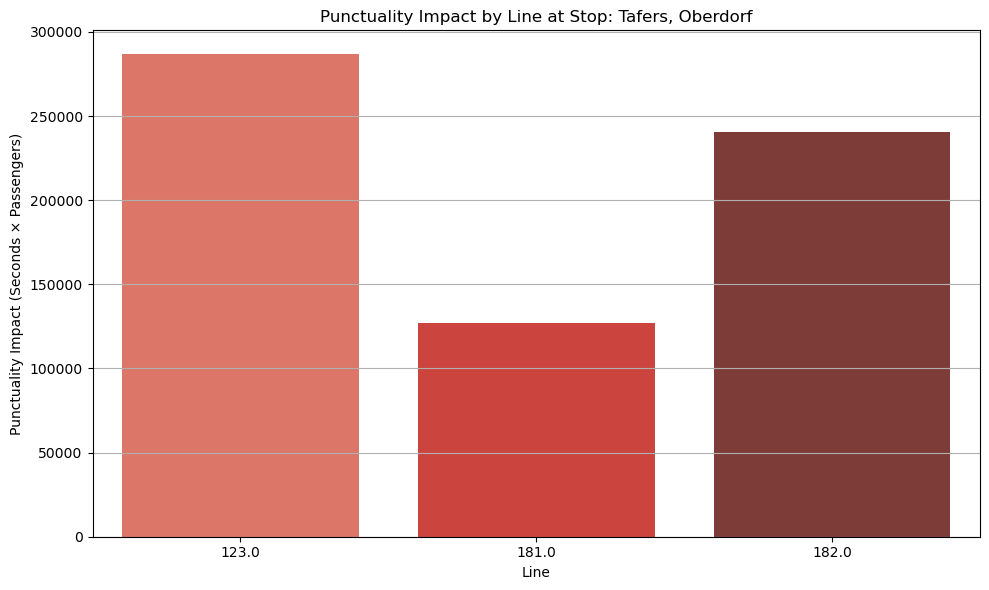

Punctuality Impact by Line at Tafers, Oberdorf:
    Line  Punctuality_Impact
0  123.0           286625.16
2  182.0           240449.01
1  181.0           127293.76


In [54]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

def plot_line_delays_at_stop(df, stop_name, top_n=None):
    """
    Plot punctuality impact (Punctuality_Seconds * total passengers) per line at a given stop.
    
    Parameters:
    df: DataFrame with columns ['StopName', 'Line', 'Punctuality_Seconds', 'On_Second_Class', 'Off_Second_Class']
    stop_name: Name of the stop to visualize
    top_n: Optional. Show only top N lines with highest impact (sorted by impact)
    """
    
    # Filter data for the specified stop
    df_filtered = df[df['StopName'] == stop_name].copy()
    
    if df_filtered.empty:
        print(f"❌ No data found for StopName = '{stop_name}'")
        return
    
    # Calculate punctuality impact
    df_filtered['Punctuality_Impact'] = (
        df_filtered['Punctuality_Seconds'] * 
        (df_filtered['On_Second_Class'] + df_filtered['Off_Second_Class'])
    )
    
    # Group by line and sum the impact
    line_summary = df_filtered.groupby('Line')['Punctuality_Impact'].sum().reset_index()
    line_summary = line_summary.sort_values('Punctuality_Impact', ascending=False)
    
    # Limit to top N if specified
    if top_n:
        line_summary = line_summary.head(top_n)
    
    # Create the plot
    plt.figure(figsize=(10, 6))
    sns.barplot(
        data=line_summary,
        x='Line',
        y='Punctuality_Impact',
        palette='Reds_d'
    )
    plt.ylabel('Punctuality Impact (Seconds × Passengers)')
    plt.xlabel('Line')
    plt.title(f"Punctuality Impact by Line at Stop: {stop_name}")
    plt.tight_layout()
    plt.grid(axis='y')
    plt.show()
    
    # Print summary
    print(f"Punctuality Impact by Line at {stop_name}:")
    print(line_summary)

# Usage example:
plot_line_delays_at_stop(plcs_with_on_off, 'Tafers, Oberdorf', top_n=10)

In [55]:
stops_metadata

,Stop,StopName,Didok,Platform,Short_Name,Latitude,Longitude,Average_Delay_Seconds,P90_Delay_Seconds,P50_Delay_Seconds,P10_Delay_Seconds,Line,Line_Avg_Delay_Seconds,Line_P90_Delay_Seconds,Line_P50_Delay_Seconds,Line_P10_Delay_Seconds
0,850023801,"Bulle, Verdel",8500238,01,BULrtv,46.625099,7.066065,189.367052,341.0,161.0,69.0,202.0,190.501837,341.0,162.0,70.0
1,850023801,"Bulle, Verdel",8500238,01,BULrtv,46.625099,7.066065,189.367052,341.0,161.0,69.0,280.0,33.555556,143.6,43.0,-73.8
2,850023801,"Bulle, Verdel",8500238,01,BULrtv,46.625099,7.066065,189.367052,341.0,161.0,69.0,331.0,179.214286,326.0,150.0,69.1
3,850023802,"Bulle, Verdel",8500238,02,BULrtv,46.624744,7.065967,132.812908,199.2,120.0,74.8,202.0,132.812908,199.2,120.0,74.8
4,850072901,"Tramelan, garage CJ",8500729,01,DEPtra,47.246393,7.233253,1015.300000,1900.4,742.5,348.7,909.0,998.888889,1973.2,478.0,348.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3902,999998801,"Bulle, La Léchère",9999988,01,SPElec,46.617665,7.045063,660.227273,952.4,573.5,371.6,901.0,660.227273,952.4,573.5,371.6
3903,999998901,"Bulle, Rue des Baladins",9999989,01,RUEbal,46.610138,7.047311,-38.058824,77.7,-63.0,-150.2,901.0,-38.058824,77.7,-63.0,-150.2
3904,999999201,"Châtel-St-Denis, Halle Triple",9999992,01,HALtri,46.536425,6.897592,26.892116,223.0,25.0,-168.0,481.0,133.600000,479.0,94.0,-175.2
3905,999999201,"Châtel-St-Denis, Halle Triple",9999992,01,HALtri,46.536425,6.897592,26.892116,223.0,25.0,-168.0,492.0,-49.090909,224.0,-122.0,-210.0


In [56]:
stops_metadata

,Stop,StopName,Didok,Platform,Short_Name,Latitude,Longitude,Average_Delay_Seconds,P90_Delay_Seconds,P50_Delay_Seconds,P10_Delay_Seconds,Line,Line_Avg_Delay_Seconds,Line_P90_Delay_Seconds,Line_P50_Delay_Seconds,Line_P10_Delay_Seconds
0,850023801,"Bulle, Verdel",8500238,01,BULrtv,46.625099,7.066065,189.367052,341.0,161.0,69.0,202.0,190.501837,341.0,162.0,70.0
1,850023801,"Bulle, Verdel",8500238,01,BULrtv,46.625099,7.066065,189.367052,341.0,161.0,69.0,280.0,33.555556,143.6,43.0,-73.8
2,850023801,"Bulle, Verdel",8500238,01,BULrtv,46.625099,7.066065,189.367052,341.0,161.0,69.0,331.0,179.214286,326.0,150.0,69.1
3,850023802,"Bulle, Verdel",8500238,02,BULrtv,46.624744,7.065967,132.812908,199.2,120.0,74.8,202.0,132.812908,199.2,120.0,74.8
4,850072901,"Tramelan, garage CJ",8500729,01,DEPtra,47.246393,7.233253,1015.300000,1900.4,742.5,348.7,909.0,998.888889,1973.2,478.0,348.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3902,999998801,"Bulle, La Léchère",9999988,01,SPElec,46.617665,7.045063,660.227273,952.4,573.5,371.6,901.0,660.227273,952.4,573.5,371.6
3903,999998901,"Bulle, Rue des Baladins",9999989,01,RUEbal,46.610138,7.047311,-38.058824,77.7,-63.0,-150.2,901.0,-38.058824,77.7,-63.0,-150.2
3904,999999201,"Châtel-St-Denis, Halle Triple",9999992,01,HALtri,46.536425,6.897592,26.892116,223.0,25.0,-168.0,481.0,133.600000,479.0,94.0,-175.2
3905,999999201,"Châtel-St-Denis, Halle Triple",9999992,01,HALtri,46.536425,6.897592,26.892116,223.0,25.0,-168.0,492.0,-49.090909,224.0,-122.0,-210.0


#### Median * passengers

In [57]:
stops_metadata.nlargest(10, 'Average_Delay_Seconds')

,Stop,StopName,Didok,Platform,Short_Name,Latitude,Longitude,Average_Delay_Seconds,P90_Delay_Seconds,P50_Delay_Seconds,P10_Delay_Seconds,Line,Line_Avg_Delay_Seconds,Line_P90_Delay_Seconds,Line_P50_Delay_Seconds,Line_P10_Delay_Seconds
3375,859328404,"Bulle, Saucens",8593284,04,BULsau,46.613431,7.041742,1298.500000,3690.1,32.5,-80.3,901.0,1298.500000,3690.1,32.5,-80.3
4,850072901,"Tramelan, garage CJ",8500729,01,DEPtra,47.246393,7.233253,1015.300000,1900.4,742.5,348.7,909.0,998.888889,1973.2,478.0,348.1
5,850072901,"Tramelan, garage CJ",8500729,01,DEPtra,47.246393,7.233253,1015.300000,1900.4,742.5,348.7,9091.0,1163.000000,1289.4,1163.0,1036.6
3687,999426001,"Bulle, Bâtiment des sociétés",9994260,01,BULbso,46.614180,7.046657,736.714286,2168.8,21.0,-90.8,901.0,736.714286,2168.8,21.0,-90.8
3898,999996801,"Morat, piscine",9999968,01,MORpis,46.909936,7.077908,721.888889,3314.6,38.0,-195.8,904.0,721.888889,3314.6,38.0,-195.8
3693,999550001,"Bulle, ch. du Repou",9995500,01,BULrep,46.616835,7.048947,680.774194,928.0,662.0,519.0,901.0,680.774194,928.0,662.0,519.0
3902,999998801,"Bulle, La Léchère",9999988,01,SPElec,46.617665,7.045063,660.227273,952.4,573.5,371.6,901.0,660.227273,952.4,573.5,371.6
3896,999996201,"Châtel-St-Denis, Bourg",9999962,01,CSDbou,46.530628,6.909042,635.292308,1965.8,74.0,-59.4,902.0,635.292308,1965.8,74.0,-59.4
3704,999931001,"Bulle, Citards",9999310,01,BULcyt,46.614539,7.049647,595.727273,694.6,579.0,404.2,901.0,595.727273,694.6,579.0,404.2
2011,857776401,"Boltigen, Bahnhof",8577764,01,BOLbah,46.624000,7.367368,485.345833,2080.7,-104.5,-357.3,259.0,485.345833,2080.7,-104.5,-357.3


In [58]:
# stops_metadata.nsmallest(10, 'Average_Delay_Seconds')

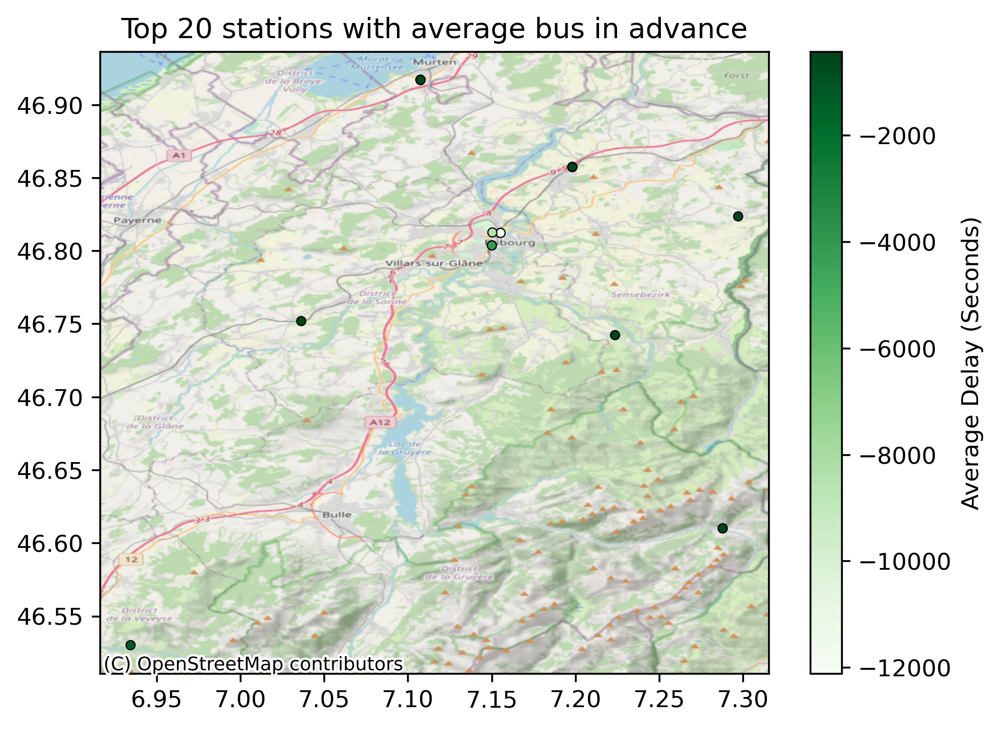

In [59]:
fig, ax = plt.subplots(dpi=300)

scatter = ax.scatter(stops_metadata.nsmallest(20, 'Average_Delay_Seconds').Longitude,
                     stops_metadata.nsmallest(20, 'Average_Delay_Seconds').Latitude, s=15, zorder=2, cmap='Greens',
                     c=stops_metadata.nsmallest(20, 'Average_Delay_Seconds').Average_Delay_Seconds, edgecolors='k', linewidths=0.5)
cbar = plt.colorbar(scatter)
cbar.set_label("Average Delay (Seconds)")
cx.add_basemap(ax=ax, crs=epsg_proj, source=tile_provider, zorder=1)
ax.set_title("Top 20 stations with average bus in advance")
plt.show()

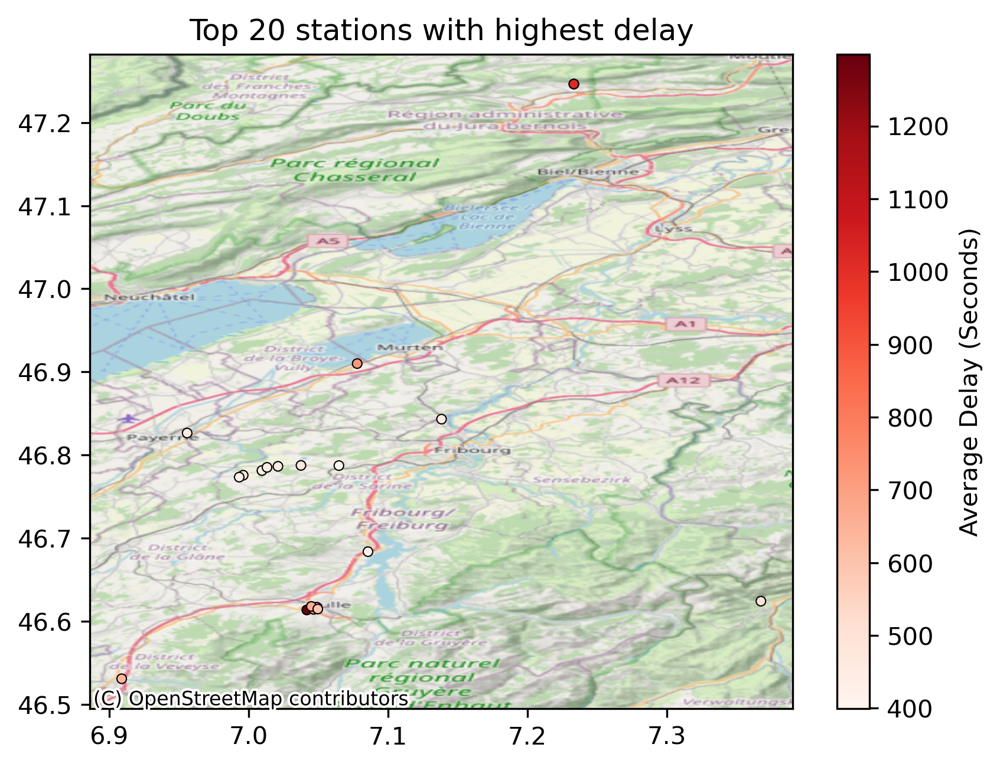

In [60]:
fig, ax = plt.subplots(dpi=300)

scatter = ax.scatter(stops_metadata.nlargest(20, 'Average_Delay_Seconds').Longitude,
                     stops_metadata.nlargest(20, 'Average_Delay_Seconds').Latitude, s=15, zorder=2, cmap='Reds',
                     c=stops_metadata.nlargest(20, 'Average_Delay_Seconds').Average_Delay_Seconds, edgecolors='k', linewidths=0.5)
cbar = plt.colorbar(scatter)
cbar.set_label("Average Delay (Seconds)")
cx.add_basemap(ax=ax, crs=epsg_proj, source=tile_provider, zorder=1)
ax.set_title("Top 20 stations with highest delay")
plt.show()

/var/folders/58/tx0yktsx2rn9t9y3z4q7lcmc0000gn/T/ipykernel_1619/1965519772.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  plcs_with_on_off['Punctuality_Impact'] = (


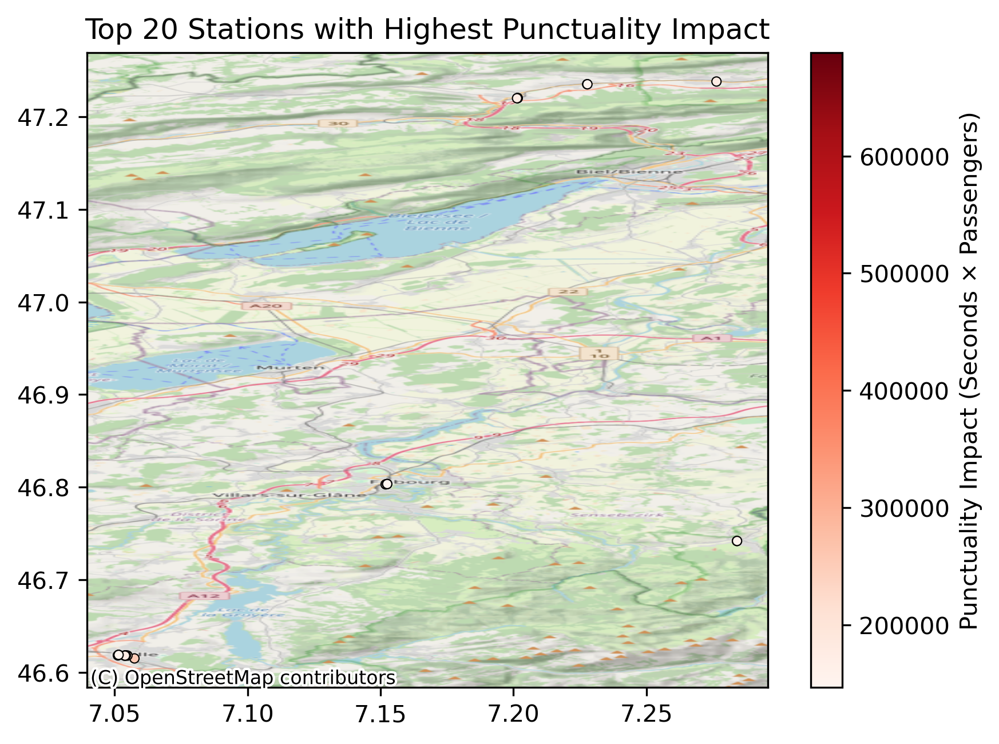

Top 20 Stations by Punctuality Impact:
                                 StopName  Punctuality_Impact
935240                  Reconvilier, gare           688112.16
1039992                    Tavannes, gare           364811.33
641628   Fribourg/Freiburg, gare routière           255089.00
641586   Fribourg/Freiburg, gare routière           245746.00
1039991                    Tavannes, gare           236696.48
641624   Fribourg/Freiburg, gare routière           230592.00
641605   Fribourg/Freiburg, gare routière           215290.53
642732   Fribourg/Freiburg, gare routière           214383.00
641515   Fribourg/Freiburg, gare routière           213130.33
641513   Fribourg/Freiburg, gare routière           204195.84
641525   Fribourg/Freiburg, gare routière           182322.36
800715     Malleray-Bévilard, gare/Gd-Rue           176094.80
1039715                    Tavannes, gare           173517.50
641551   Fribourg/Freiburg, gare routière           172384.28
640024        Fribourg/Freiburg

In [61]:
import matplotlib.pyplot as plt
import contextily as cx

# Calculate Punctuality Impact
plcs_with_on_off['Punctuality_Impact'] = (
    plcs_with_on_off['Punctuality_Seconds'] * 
    (plcs_with_on_off['On_Second_Class'] + plcs_with_on_off['Off_Second_Class'])
)

# Group by stop and calculate total punctuality impact
stop_impact = plcs_with_on_off.groupby(['StopName', 'Longitude', 'Latitude']).agg({
    'Punctuality_Impact': 'sum'
}).reset_index()

# Get top 20 stations with highest punctuality impact
top_20_impact = stop_impact.nlargest(20, 'Punctuality_Impact')

# Create the map
fig, ax = plt.subplots(dpi=300)
scatter = ax.scatter(top_20_impact['Longitude'],
                    top_20_impact['Latitude'], 
                    s=15, 
                    zorder=2, 
                    cmap='Reds',
                    c=top_20_impact['Punctuality_Impact'], 
                    edgecolors='k', 
                    linewidths=0.5)

cbar = plt.colorbar(scatter)
cbar.set_label("Punctuality Impact (Seconds × Passengers)")
cx.add_basemap(ax=ax, crs=epsg_proj, source=tile_provider, zorder=1)
ax.set_title("Top 20 Stations with Highest Punctuality Impact")
plt.show()

# Print the top 20 stations
print("Top 20 Stations by Punctuality Impact:")
print(top_20_impact[['StopName', 'Punctuality_Impact']].sort_values('Punctuality_Impact', ascending=False))

In [62]:
# We need to add the stop ID into the occupancy dataframe. This can be done with the journey ID
journeys_stops = plcs[['Journey', 'Stop']].drop_duplicates().dropna().reset_index(drop=True)
journeys_stops['Stop'] = journeys_stops.Stop.astype(int)
journeys_stops['Didok'] = journeys_stops.Stop.astype(str).str[:-2].astype(int)

journeys_stops_dict = {(int(v.Journey), int(v.Didok)): int(v.Stop) for r, v in journeys_stops.iterrows()}
occ['Stop'] = [journeys_stops_dict[(int(j), int(d))] if (int(j), int(d)) in journeys_stops_dict else np.nan  for j, d in occ[['Journey', 'Didok']].values]

In [63]:
journeys_stops

,Journey,Stop,Didok
0,9999039.0,850488114,8504881
1,67016.0,850488114,8504881
2,67016.0,858915502,8589155
3,67016.0,858885802,8588858
4,67016.0,858915402,8589154
...,...,...,...
129050,72057.0,850664402,8506644
129051,67574.0,858916801,8589168
129052,9999040.0,999980901,9999809
129053,9999043.0,850485801,8504858


In [64]:
# Prepare base: filter plcs for valid delay values
valid_plcs = plcs[~plcs['Punctuality_Seconds'].isna() & ~plcs['Didok'].isna()]

# Aggregate delay stats by (Line, Direction, Didok)
delay_stats = (
    valid_plcs.groupby(['Line', 'Direction', 'Didok'])
    .agg(
        Average_Delay_Seconds=('Punctuality_Seconds', 'mean'),
        P90_Delay_Seconds=('Punctuality_Seconds', lambda x: x.quantile(0.9)),
        P50_Delay_Seconds=('Punctuality_Seconds', 'median'),
        P10_Delay_Seconds=('Punctuality_Seconds', lambda x: x.quantile(0.1))
    )
    .reset_index()
)

# Merge stop name and Stop ID
delay_stats = delay_stats.merge(
    stops_metadata[['Didok', 'StopName', 'Stop']],
    how='left',
    on='Didok'
)

# Final tidy order of columns
delay_stats = delay_stats[[
    'Line', 'Direction', 'StopName', 'Didok', 'Stop',
    'Average_Delay_Seconds', 'P90_Delay_Seconds', 'P50_Delay_Seconds', 'P10_Delay_Seconds'
]]

# Sort by Line, Direction, and Didok
delay_stats = delay_stats.sort_values(['Line', 'Direction', 'Didok'])

# Output result
stop_line_direction_delay_df = delay_stats

In [65]:
stop_line_direction_delay_df

,Line,Direction,StopName,Didok,Stop,Average_Delay_Seconds,P90_Delay_Seconds,P50_Delay_Seconds,P10_Delay_Seconds
0,1.0,-1,"Fribourg/Freiburg, gare/Colisée",8503889,850388901,118.250000,272.8,105.0,-25.7
1,1.0,-1,"Fribourg/Freiburg, gare/Colisée",8503889,850388901,118.250000,272.8,105.0,-25.7
2,1.0,-1,"Fribourg/Freiburg, gare/Colisée",8503889,850388901,118.250000,272.8,105.0,-25.7
3,1.0,-1,"Marly, Les Rittes",8504631,850463101,165.400000,415.9,78.5,6.4
4,1.0,-1,"Marly, Les Rittes",8504631,850463101,165.400000,415.9,78.5,6.4
...,...,...,...,...,...,...,...,...,...
55236,9091.0,2,"Sorvilier, gare",8582684,858268402,-19.500000,60.0,-26.5,-93.6
55237,9091.0,2,"Pontenet, gare",8589219,858921901,43.571429,134.8,63.5,-86.4
55238,9091.0,2,"Pontenet, gare",8589219,858921901,43.571429,134.8,63.5,-86.4
55239,9091.0,2,"Pontenet, gare",8589219,858921902,43.571429,134.8,63.5,-86.4


In [66]:
unique_directions = stop_line_direction_delay_df[stop_line_direction_delay_df['Line'] == 123]['Direction'].nunique()
print(f"Line has {unique_directions} unique directions")

##TODO: stop_line_direction_delay_df has some problems

Line has 3 unique directions


In [67]:
line_sequences

{1.0: {1: ('8587238',
   '8592379',
   '8592370',
   '8592369',
   '8577820',
   '8577812',
   '8592382',
   '8577811',
   '8577810',
   '8589161'),
  2: ('8577743',
   '8504862',
   '8504975',
   '8577742',
   '8504631',
   '8589149',
   '8589148',
   '8577741',
   '8589154',
   '8588858',
   '8589155',
   '8592374',
   '8589161',
   '8587255',
   '8589142',
   '8589164',
   '8589163',
   '8589139',
   '8589177',
   '8589176',
   '8589175'),
  3: ('8589175',
   '8589176',
   '8589177',
   '8589139',
   '8589163',
   '8589164',
   '8589142',
   '8587255',
   '8577810',
   '8589161',
   '8592374',
   '8589155',
   '8588858',
   '8589154',
   '8577741',
   '8589148',
   '8504631',
   '8577742',
   '8504975',
   '8504862',
   '8577743'),
  4: ('8589161',
   '8577810',
   '8577811',
   '8592382',
   '8577812',
   '8592369',
   '8592370',
   '8592379',
   '8587238'),
  5: ('8503889', '8589155', '8588858', '8589154', '8577741')},
 2.0: {1: ('8587238',
   '8592379',
   '8592370',
   '8592369'

### Stop delays on a line

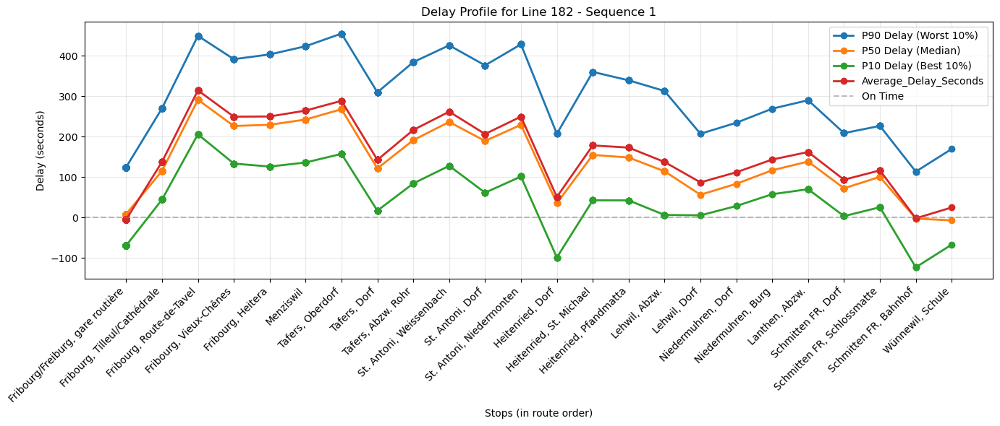

📊 Summary for Line 182 Sequence 1
  - Stops plotted: 305
  - Average P50 delay: 85.7 seconds
  - Worst stop (P90): Tafers, Oberdorf (454.6s)


In [68]:
import matplotlib.pyplot as plt

def plot_delay_profile_for_line(df, line_sequences, line, sequence_id=None):
    """
    Plot delay profile (P90, P50, P10) along the stops of a given line sequence.
    
    Parameters:
    df: DataFrame like stop_line_direction_delay_df
    line_sequences: Your line_sequences dictionary from sequence analysis
    line: Line number to visualize
    sequence_id: Optional. If specified, filters on this sequence/direction only
    
    Returns:
    Matplotlib plot showing delay profiles per stop
    """
    df_filtered = df[df['Line'] == line].copy()
    
    if sequence_id is not None:
        df_filtered = df_filtered[df_filtered['Direction'] == sequence_id]
    
    if df_filtered.empty:
        print("❌ No data found for the given line (and sequence if specified).")
        return
    
    # Get the correct order from sequence
    if sequence_id is not None and line in line_sequences and sequence_id in line_sequences[line]:
        # Get the sequence order using Didok IDs
        didok_sequence = line_sequences[line][sequence_id]
        
        # Create a mapping of Didok to position
        didok_to_position = {str(didok): i for i, didok in enumerate(didok_sequence)}
        
        # Add position column and sort by it
        df_filtered['Position'] = df_filtered['Didok'].astype(str).map(didok_to_position)
        df_filtered = df_filtered.dropna(subset=['Position']).sort_values('Position')
    else:
        # If no sequence specified, just sort by Didok (fallback)
        df_filtered = df_filtered.sort_values('Didok')
    
    if df_filtered.empty:
        print("❌ No matching stops found in the sequence data.")
        return
    
    # Plot
    plt.figure(figsize=(14, 6))
    plt.plot(df_filtered['StopName'], df_filtered['P90_Delay_Seconds'], 
             marker='o', linewidth=2, markersize=6, label='P90 Delay (Worst 10%)')
    plt.plot(df_filtered['StopName'], df_filtered['P50_Delay_Seconds'], 
             marker='o', linewidth=2, markersize=6, label='P50 Delay (Median)')
    plt.plot(df_filtered['StopName'], df_filtered['P10_Delay_Seconds'], 
             marker='o', linewidth=2, markersize=6, label='P10 Delay (Best 10%)')
    plt.plot(df_filtered['StopName'], df_filtered['Average_Delay_Seconds'],
             marker='o', linewidth=2, markersize=6, label='Average_Delay_Seconds')
    
    # Add zero line for reference
    plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5, label='On Time')
    
    plt.title(f"Delay Profile for Line {line}" + 
              (f" - Sequence {sequence_id}" if sequence_id is not None else " (All Sequences)"))
    plt.xlabel("Stops (in route order)")
    plt.ylabel("Delay (seconds)")
    plt.xticks(rotation=45, ha='right')
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.tight_layout()
    plt.show()
    
    # Print summary
    print(f"📊 Summary for Line {line}" + (f" Sequence {sequence_id}" if sequence_id else ""))
    print(f"  - Stops plotted: {len(df_filtered)}")
    print(f"  - Average P50 delay: {df_filtered['P50_Delay_Seconds'].mean():.1f} seconds")
    print(f"  - Worst stop (P90): {df_filtered.loc[df_filtered['P90_Delay_Seconds'].idxmax(), 'StopName']} ({df_filtered['P90_Delay_Seconds'].max():.1f}s)")

# Usage examples:
# Show all sequences for a line
# plot_delay_profile_for_line(stop_line_direction_delay_df, line_sequences, line=259)

# Show specific sequence
plot_delay_profile_for_line(stop_line_direction_delay_df, line_sequences, line=182, sequence_id=1)
# Ulmiz FR, Abzw. Lurtigen
# Châtel-St-Denis, Les Moilles 492
# Tafers, Oberdorf 123 182 917 181
# Ulmiz FR, Abzw. Lurtigen

In [69]:
stop_line_direction_delay_df

,Line,Direction,StopName,Didok,Stop,Average_Delay_Seconds,P90_Delay_Seconds,P50_Delay_Seconds,P10_Delay_Seconds
0,1.0,-1,"Fribourg/Freiburg, gare/Colisée",8503889,850388901,118.250000,272.8,105.0,-25.7
1,1.0,-1,"Fribourg/Freiburg, gare/Colisée",8503889,850388901,118.250000,272.8,105.0,-25.7
2,1.0,-1,"Fribourg/Freiburg, gare/Colisée",8503889,850388901,118.250000,272.8,105.0,-25.7
3,1.0,-1,"Marly, Les Rittes",8504631,850463101,165.400000,415.9,78.5,6.4
4,1.0,-1,"Marly, Les Rittes",8504631,850463101,165.400000,415.9,78.5,6.4
...,...,...,...,...,...,...,...,...,...
55236,9091.0,2,"Sorvilier, gare",8582684,858268402,-19.500000,60.0,-26.5,-93.6
55237,9091.0,2,"Pontenet, gare",8589219,858921901,43.571429,134.8,63.5,-86.4
55238,9091.0,2,"Pontenet, gare",8589219,858921901,43.571429,134.8,63.5,-86.4
55239,9091.0,2,"Pontenet, gare",8589219,858921902,43.571429,134.8,63.5,-86.4


In [70]:
get_line_sequences(123)

🚌 Line 123 Route Sequences:

**Sequence 1** (559 journeys):
  Route: Fribourg/Freiburg, gare routière → Schwarzsee, Campus
  Full path:
    1. Fribourg/Freiburg, gare routière
    2. Fribourg, Tilleul/Cathédrale
    3. Fribourg, Route-de-Tavel
    4. Fribourg, Vieux-Chênes
    5. Fribourg, Heitera
    6. Menziswil
    7. Tafers, Oberdorf
    8. Tafers, Dorf
    9. Tafers, Am Kreuz
    10. Alterswil FR, Galteren
    11. Alterswil FR, Beniwil
    12. Alterswil FR, Dorfplatz
    13. Alterswil FR, Geriwil
    14. Alterswil FR, Hofmatt
    15. Alterswil FR, Wengliswil
    16. Alterswil FR, Wilersguet
    17. Brünisried, Riedgarten
    18. Zumholz, Dorf
    19. Oberschrot, Büel
    20. Plaffeien, Dorf
    21. Plaffeien, Oberi Matta
    22. Plaffeien, Telmoos
    23. Plaffeien, Rufenen
    24. Plaffeien, Kloster
    25. Zollhaus FR
    26. Schwarzsee, Buntschena
    27. Schwarzsee, Lichtena
    28. Schwarzsee, Tromooserli
    29. Schwarzsee, Mösli
    30. Schwarzsee, Kaspera
    31. Schwarzse

In [71]:
occ

,Day,Day_Type,TrainNr,Journey,Journey_Type,Journey_Start_Seconds,Journey_End_Seconds,Journey_Start_Time,Journey_End_Time,Line,Line_Direction,Arrival_Seconds,Departure_Seconds,On_First_Class,Off_First_Class,Occupancy_First_Class,On_Second_Class,Off_Second_Class,Occupancy_Second_Class,Distance_Meters,Quality,Short_Name,Didok,Stop
0,2024-01-01,dim,9999006,9999006,2,16620,16980,2024-01-01 04:37:00,2024-01-01 04:43:00,1,Hin,NaN,16620.0,0.0,0.0,0.0,0.0,0.0,0.0,2248,0,DEPgiv,9999800,999980002.0
1,2024-01-01,dim,9999006,9999006,2,16620,16980,2024-01-01 04:37:00,2024-01-01 04:43:00,1,Hin,16980.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,0,MCar,8587238,858723801.0
2,2024-01-01,dim,61007,61007,1,16981,17460,2024-01-01 04:43:01,2024-01-01 04:51:00,1,Hin,NaN,16981.0,0.0,0.0,0.0,0.0,0.0,0.0,212,1,MCar,8587238,858723802.0
3,2024-01-01,dim,61007,61007,1,16981,17460,2024-01-01 04:43:01,2024-01-01 04:51:00,1,Hin,17010.0,17010.0,0.0,0.0,0.0,0.0,0.0,0.0,197,1,JURcha,8592379,859237902.0
4,2024-01-01,dim,61007,61007,1,16981,17460,2024-01-01 04:43:01,2024-01-01 04:51:00,1,Hin,17040.0,17040.0,0.0,0.0,0.0,0.0,0.0,0.0,168,1,Fleu,8592370,859237002.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1986656,2024-01-05,lu-ve-vac,87337,87337,1,69180,71640,2024-01-05 19:13:00,2024-01-05 19:54:00,9091,Zurück,71640.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,2,SCBgar,8511056,851105602.0
1986657,2024-01-05,lu-ve-vac,9999001,9999001,3,70201,71400,2024-01-05 19:30:01,2024-01-05 19:50:00,9091,Hin,NaN,70201.0,0.0,0.0,0.0,0.0,0.0,0.0,15000,0,MBEpos,8511026,NaN
1986658,2024-01-05,lu-ve-vac,9999001,9999001,3,70201,71400,2024-01-05 19:30:01,2024-01-05 19:50:00,9091,Hin,71400.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,0,DEPtra,8500729,NaN
1986659,2024-01-05,lu-ve-vac,9999016,9999016,3,71641,72480,2024-01-05 19:54:01,2024-01-05 20:08:00,9091,Hin,NaN,71641.0,0.0,0.0,0.0,0.0,0.0,0.0,11600,0,SCBgar,8511056,NaN


In [72]:
print(occ)

               Day   Day_Type  TrainNr  Journey  Journey_Type  \
0       2024-01-01        dim  9999006  9999006             2   
1       2024-01-01        dim  9999006  9999006             2   
2       2024-01-01        dim    61007    61007             1   
3       2024-01-01        dim    61007    61007             1   
4       2024-01-01        dim    61007    61007             1   
...            ...        ...      ...      ...           ...   
1986656 2024-01-05  lu-ve-vac    87337    87337             1   
1986657 2024-01-05  lu-ve-vac  9999001  9999001             3   
1986658 2024-01-05  lu-ve-vac  9999001  9999001             3   
1986659 2024-01-05  lu-ve-vac  9999016  9999016             3   
1986660 2024-01-05  lu-ve-vac  9999016  9999016             3   

         Journey_Start_Seconds  Journey_End_Seconds   Journey_Start_Time  \
0                        16620                16980  2024-01-01 04:37:00   
1                        16620                16980  2024-01-01 04:

In [73]:
merged_df = occ.merge(
    stops_metadata[[ 'Short_Name', 'StopName']].drop_duplicates(),
    left_on=['Short_Name'],
    right_on=['Short_Name'],
    how='left'
)
merged_df

,Day,Day_Type,TrainNr,Journey,Journey_Type,Journey_Start_Seconds,Journey_End_Seconds,Journey_Start_Time,Journey_End_Time,Line,Line_Direction,Arrival_Seconds,Departure_Seconds,On_First_Class,Off_First_Class,Occupancy_First_Class,On_Second_Class,Off_Second_Class,Occupancy_Second_Class,Distance_Meters,Quality,Short_Name,Didok,Stop,StopName
0,2024-01-01,dim,9999006,9999006,2,16620,16980,2024-01-01 04:37:00,2024-01-01 04:43:00,1,Hin,NaN,16620.0,0.0,0.0,0.0,0.0,0.0,0.0,2248,0,DEPgiv,9999800,999980002.0,Dépôt Givisiez (G7 route)
1,2024-01-01,dim,9999006,9999006,2,16620,16980,2024-01-01 04:37:00,2024-01-01 04:43:00,1,Hin,16980.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,0,MCar,8587238,858723801.0,"Givisiez, Mont Carmel"
2,2024-01-01,dim,61007,61007,1,16981,17460,2024-01-01 04:43:01,2024-01-01 04:51:00,1,Hin,NaN,16981.0,0.0,0.0,0.0,0.0,0.0,0.0,212,1,MCar,8587238,858723802.0,"Givisiez, Mont Carmel"
3,2024-01-01,dim,61007,61007,1,16981,17460,2024-01-01 04:43:01,2024-01-01 04:51:00,1,Hin,17010.0,17010.0,0.0,0.0,0.0,0.0,0.0,0.0,197,1,JURcha,8592379,859237902.0,"Fribourg, Jura Chassotte"
4,2024-01-01,dim,61007,61007,1,16981,17460,2024-01-01 04:43:01,2024-01-01 04:51:00,1,Hin,17040.0,17040.0,0.0,0.0,0.0,0.0,0.0,0.0,168,1,Fleu,8592370,859237002.0,"Fribourg, Champ-Fleuri"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1600689,2024-01-05,lu-ve-vac,87337,87337,1,69180,71640,2024-01-05 19:13:00,2024-01-05 19:54:00,9091,Zurück,71640.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,2,SCBgar,8511056,851105602.0,"Sonceboz-Sombeval, gare"
1600690,2024-01-05,lu-ve-vac,9999001,9999001,3,70201,71400,2024-01-05 19:30:01,2024-01-05 19:50:00,9091,Hin,NaN,70201.0,0.0,0.0,0.0,0.0,0.0,0.0,15000,0,MBEpos,8511026,NaN,"Malleray-Bévilard, gare/Gd-Rue"
1600691,2024-01-05,lu-ve-vac,9999001,9999001,3,70201,71400,2024-01-05 19:30:01,2024-01-05 19:50:00,9091,Hin,71400.0,NaN,0.0,0.0,0.0,0.0,0.0,0.0,0,0,DEPtra,8500729,NaN,"Tramelan, garage CJ"
1600692,2024-01-05,lu-ve-vac,9999016,9999016,3,71641,72480,2024-01-05 19:54:01,2024-01-05 20:08:00,9091,Hin,NaN,71641.0,0.0,0.0,0.0,0.0,0.0,0.0,11600,0,SCBgar,8511056,NaN,"Sonceboz-Sombeval, gare"


### On, off, & balanced

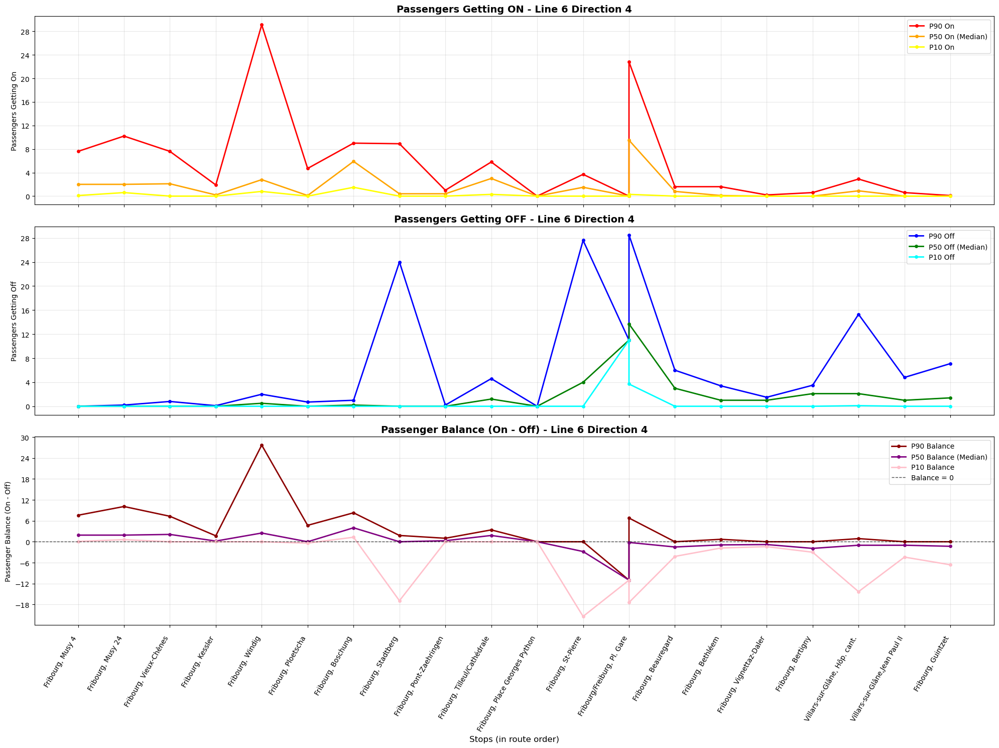

📊 Comprehensive Passenger Analysis for Line 6 Direction 4
  - Stops analyzed: 21
  - Boarding-dominant stops (P50 > 0): 8
  - Alighting-dominant stops (P50 < 0): 10
  - Highest net boarding: Fribourg, Boschung (+4.0 median)
  - Highest total boarding: Fribourg/Freiburg, Pl. Gare (9.5 median)
  - Highest net alighting: Fribourg/Freiburg, Pl. Gare (-11.0 median)
  - Highest total alighting: Fribourg/Freiburg, Pl. Gare (13.7 median)


In [74]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_passenger_comprehensive_profile(occ_df, line_sequences, line, direction=None):
    """
    Plot comprehensive passenger profile: ON, OFF, and Balance (On - Off) 
    in a single figure with three subplots.
    
    Parameters:
    occ_df: DataFrame (your occ data)
    line_sequences: Your line_sequences dictionary
    line: Line number to visualize
    direction: Direction ID (from your sequence analysis)
    """
    
    # Filter by line
    df_filtered = occ_df[occ_df['Line'] == line].copy()
    
    if df_filtered.empty:
        print(f"❌ No data found for line {line}.")
        return
    
    # Add Direction column using journey_to_sequence mapping
    def get_direction(row):
        journey_key = (row['Day'], row['Journey'])
        if journey_key in journey_to_sequence:
            _, seq_id = journey_to_sequence[journey_key]
            return seq_id
        return 0
    
    df_filtered['Direction'] = df_filtered.apply(get_direction, axis=1)
    
    # Filter by direction if specified
    if direction is not None:
        df_filtered = df_filtered[df_filtered['Direction'] == direction]
        if df_filtered.empty:
            print(f"❌ No data found for line {line}, direction {direction}.")
            return
    
    # Calculate total passengers and balance
    df_filtered['Total_On'] = df_filtered['On_First_Class'] + df_filtered['On_Second_Class']
    df_filtered['Total_Off'] = df_filtered['Off_First_Class'] + df_filtered['Off_Second_Class']
    df_filtered['Total_Balance'] = df_filtered['Total_On'] - df_filtered['Total_Off']
    
    # Add stop names and Didok using the mapping
    stop_id_to_name = dict(zip(stops_metadata['Stop'], stops_metadata['StopName']))
    stop_id_to_didok = dict(zip(stops_metadata['Stop'], stops_metadata['Didok'].astype(str)))
    
    df_filtered['StopName'] = df_filtered['Stop'].map(stop_id_to_name)
    df_filtered['Didok'] = df_filtered['Stop'].map(stop_id_to_didok)
    
    # Group by stop and calculate percentiles
    stop_stats = df_filtered.groupby(['Stop', 'StopName', 'Didok']).agg({
        'Total_On': [lambda x: x.quantile(0.1), lambda x: x.quantile(0.5), lambda x: x.quantile(0.9)],
        'Total_Off': [lambda x: x.quantile(0.1), lambda x: x.quantile(0.5), lambda x: x.quantile(0.9)],
        'Total_Balance': [lambda x: x.quantile(0.1), lambda x: x.quantile(0.5), lambda x: x.quantile(0.9)]
    }).round(1)
    
    # Flatten column names
    stop_stats.columns = [
        'On_P10', 'On_P50', 'On_P90', 
        'Off_P10', 'Off_P50', 'Off_P90',
        'Balance_P10', 'Balance_P50', 'Balance_P90'
    ]
    stop_stats = stop_stats.reset_index()
    
    # Get sequence order using Didok IDs if direction specified
    if direction is not None and line in line_sequences and direction in line_sequences[line]:
        # Get the sequence order (Didok IDs)
        didok_sequence = line_sequences[line][direction]
        
        # Create a mapping of Didok to position
        didok_to_position = {str(didok): i for i, didok in enumerate(didok_sequence)}
        
        # Add position column and sort by it
        stop_stats['Position'] = stop_stats['Didok'].map(didok_to_position)
        stop_stats = stop_stats.dropna(subset=['Position'])
        stop_stats = stop_stats.sort_values('Position')
    else:
        # If no direction specified, sort by Stop (fallback)
        stop_stats = stop_stats.sort_values('Stop')
    
    if stop_stats.empty:
        print("❌ No stops found after filtering and ordering.")
        return
    
    # Create three subplots
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(20, 15))
    
    # Plot 1: Passengers getting ON
    ax1.plot(stop_stats['StopName'], stop_stats['On_P90'], marker='o', label='P90 On', color='red', linewidth=2, markersize=4)
    ax1.plot(stop_stats['StopName'], stop_stats['On_P50'], marker='o', label='P50 On (Median)', color='orange', linewidth=2, markersize=4)
    ax1.plot(stop_stats['StopName'], stop_stats['On_P10'], marker='o', label='P10 On', color='yellow', linewidth=2, markersize=4)
    ax1.set_title(f"Passengers Getting ON - Line {line}" + (f" Direction {direction}" if direction else ""), fontsize=14, fontweight='bold')
    ax1.set_ylabel("Passengers Getting On")
    ax1.tick_params(axis='x', rotation=60, which='major', pad=10)
    ax1.grid(True, alpha=0.3)
    ax1.legend()
    ax1.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    
    # Plot 2: Passengers getting OFF
    ax2.plot(stop_stats['StopName'], stop_stats['Off_P90'], marker='o', label='P90 Off', color='blue', linewidth=2, markersize=4)
    ax2.plot(stop_stats['StopName'], stop_stats['Off_P50'], marker='o', label='P50 Off (Median)', color='green', linewidth=2, markersize=4)
    ax2.plot(stop_stats['StopName'], stop_stats['Off_P10'], marker='o', label='P10 Off', color='cyan', linewidth=2, markersize=4)
    ax2.set_title(f"Passengers Getting OFF - Line {line}" + (f" Direction {direction}" if direction else ""), fontsize=14, fontweight='bold')
    ax2.set_ylabel("Passengers Getting Off")
    ax2.tick_params(axis='x', rotation=60, which='major', pad=10)
    ax2.grid(True, alpha=0.3)
    ax2.legend()
    ax2.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    
    # Plot 3: Passenger Balance (On - Off)
    ax3.plot(stop_stats['StopName'], stop_stats['Balance_P90'], marker='o', label='P90 Balance', color='darkred', linewidth=2, markersize=4)
    ax3.plot(stop_stats['StopName'], stop_stats['Balance_P50'], marker='o', label='P50 Balance (Median)', color='purple', linewidth=2, markersize=4)
    ax3.plot(stop_stats['StopName'], stop_stats['Balance_P10'], marker='o', label='P10 Balance', color='pink', linewidth=2, markersize=4)
    
    # Zero line for balance reference
    ax3.axhline(y=0, color='black', linestyle='--', alpha=0.7, linewidth=1, label='Balance = 0')
    
    ax3.set_title(f"Passenger Balance (On - Off) - Line {line}" + (f" Direction {direction}" if direction else ""), fontsize=14, fontweight='bold')
    ax3.set_xlabel("Stops (in route order)", fontsize=12)
    ax3.set_ylabel("Passenger Balance (On - Off)")
    ax3.tick_params(axis='x', rotation=60, which='major', pad=10)
    ax3.grid(True, alpha=0.3)
    ax3.legend()
    ax3.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    
    # Align x-tick labels for all subplots
    for ax in [ax1, ax2, ax3]:
        for label in ax.get_xticklabels():
            label.set_horizontalalignment('right')
    
    # Only show x-labels on the bottom plot
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    
    plt.tight_layout()
    plt.show()
    
    # Print comprehensive summary
    print(f"📊 Comprehensive Passenger Analysis for Line {line}" + (f" Direction {direction}" if direction else ""))
    print(f"  - Stops analyzed: {len(stop_stats)}")
    
    # Analyze boarding vs alighting patterns
    boarding_stops = stop_stats[stop_stats['Balance_P50'] > 0]
    alighting_stops = stop_stats[stop_stats['Balance_P50'] < 0]
    
    print(f"  - Boarding-dominant stops (P50 > 0): {len(boarding_stops)}")
    print(f"  - Alighting-dominant stops (P50 < 0): {len(alighting_stops)}")
    
    if len(boarding_stops) > 0:
        max_boarding = boarding_stops.loc[boarding_stops['Balance_P50'].idxmax()]
        print(f"  - Highest net boarding: {max_boarding['StopName']} (+{max_boarding['Balance_P50']:.1f} median)")
        
        max_on = stop_stats.loc[stop_stats['On_P50'].idxmax()]
        print(f"  - Highest total boarding: {max_on['StopName']} ({max_on['On_P50']:.1f} median)")
    
    if len(alighting_stops) > 0:
        max_alighting = alighting_stops.loc[alighting_stops['Balance_P50'].idxmin()]
        print(f"  - Highest net alighting: {max_alighting['StopName']} ({max_alighting['Balance_P50']:.1f} median)")
        
        max_off = stop_stats.loc[stop_stats['Off_P50'].idxmax()]
        print(f"  - Highest total alighting: {max_off['StopName']} ({max_off['Off_P50']:.1f} median)")

# Usage:
plot_passenger_comprehensive_profile(merged_df, line_sequences, line=6, direction=4)

#### take the average if there's more than 1 value for a stop

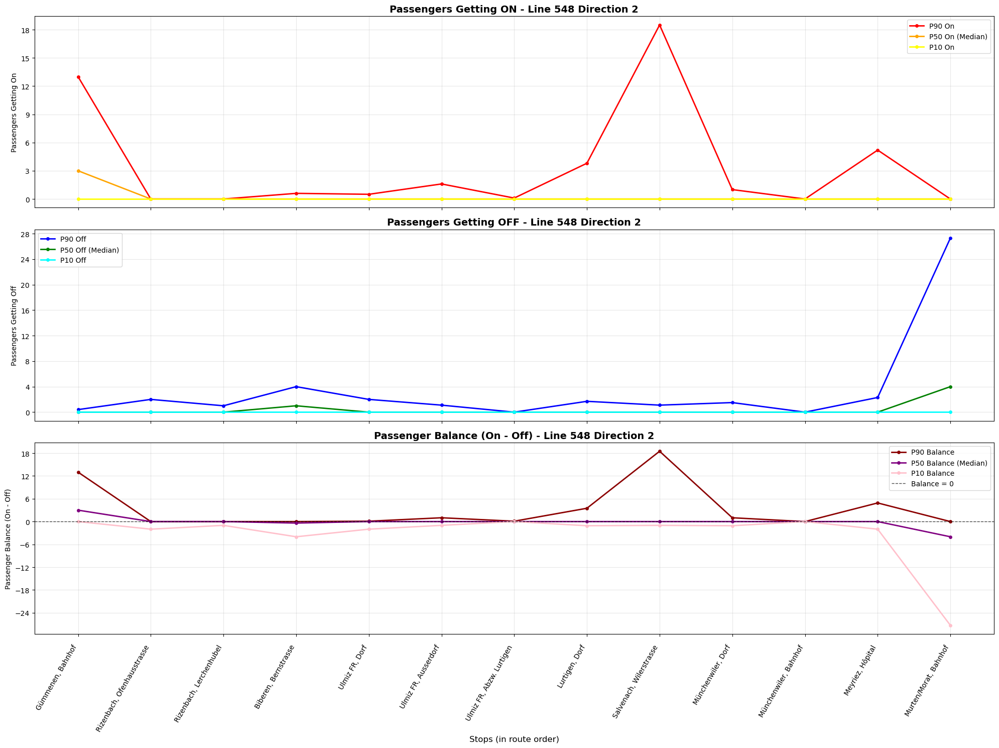

📊 Comprehensive Passenger Analysis for Line 548 Direction 2
  - Stops analyzed: 13
  - Boarding-dominant stops (P50 > 0): 1
  - Alighting-dominant stops (P50 < 0): 2
  - Highest net boarding: Gümmenen, Bahnhof (+3.0 median)
  - Highest total boarding: Gümmenen, Bahnhof (3.0 median)
  - Highest net alighting: Murten/Morat, Bahnhof (-4.0 median)
  - Highest total alighting: Murten/Morat, Bahnhof (4.0 median)


In [75]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_passenger_comprehensive_profile(occ_df, line_sequences, line, direction=None):
    """
    Plot comprehensive passenger profile: ON, OFF, and Balance (On - Off) 
    in a single figure with three subplots.
    
    Parameters:
    occ_df: DataFrame (your occ data)
    line_sequences: Your line_sequences dictionary
    line: Line number to visualize
    direction: Direction ID (from your sequence analysis)
    """
    
    # Filter by line
    df_filtered = occ_df[occ_df['Line'] == line].copy()
    
    if df_filtered.empty:
        print(f"❌ No data found for line {line}.")
        return
    
    # Add Direction column using journey_to_sequence mapping
    def get_direction(row):
        journey_key = (row['Day'], row['Journey'])
        if journey_key in journey_to_sequence:
            _, seq_id = journey_to_sequence[journey_key]
            return seq_id
        return 0
    
    df_filtered['Direction'] = df_filtered.apply(get_direction, axis=1)
    
    # Filter by direction if specified
    if direction is not None:
        df_filtered = df_filtered[df_filtered['Direction'] == direction]
        if df_filtered.empty:
            print(f"❌ No data found for line {line}, direction {direction}.")
            return
    
    # Calculate total passengers and balance
    df_filtered['Total_On'] = df_filtered['On_First_Class'] + df_filtered['On_Second_Class']
    df_filtered['Total_Off'] = df_filtered['Off_First_Class'] + df_filtered['Off_Second_Class']
    df_filtered['Total_Balance'] = df_filtered['Total_On'] - df_filtered['Total_Off']
    
    # Add stop names and Didok using the mapping
    stop_id_to_name = dict(zip(stops_metadata['Stop'], stops_metadata['StopName']))
    stop_id_to_didok = dict(zip(stops_metadata['Stop'], stops_metadata['Didok'].astype(str)))
    
    df_filtered['StopName'] = df_filtered['Stop'].map(stop_id_to_name)
    df_filtered['Didok'] = df_filtered['Stop'].map(stop_id_to_didok)
    
    # Group by stop and calculate percentiles
    stop_stats = df_filtered.groupby(['Stop', 'StopName', 'Didok']).agg({
        'Total_On': [lambda x: x.quantile(0.1), lambda x: x.quantile(0.5), lambda x: x.quantile(0.9)],
        'Total_Off': [lambda x: x.quantile(0.1), lambda x: x.quantile(0.5), lambda x: x.quantile(0.9)],
        'Total_Balance': [lambda x: x.quantile(0.1), lambda x: x.quantile(0.5), lambda x: x.quantile(0.9)]
    }).round(1)
    
    # Flatten column names
    stop_stats.columns = [
        'On_P10', 'On_P50', 'On_P90', 
        'Off_P10', 'Off_P50', 'Off_P90',
        'Balance_P10', 'Balance_P50', 'Balance_P90'
    ]
    stop_stats = stop_stats.reset_index()
    
    # Handle duplicate StopNames by averaging numeric columns
    numeric_cols = ['On_P10', 'On_P50', 'On_P90', 'Off_P10', 'Off_P50', 'Off_P90', 
                    'Balance_P10', 'Balance_P50', 'Balance_P90']
    other_cols = ['Stop', 'Didok']
    
    agg_dict = {col: 'mean' for col in numeric_cols}
    agg_dict.update({col: 'first' for col in other_cols})
    
    stop_stats = stop_stats.groupby('StopName').agg(agg_dict).reset_index()
    
    # Get sequence order using Didok IDs if direction specified
    if direction is not None and line in line_sequences and direction in line_sequences[line]:
        # Get the sequence order (Didok IDs)
        didok_sequence = line_sequences[line][direction]
        
        # Create a mapping of Didok to position
        didok_to_position = {str(didok): i for i, didok in enumerate(didok_sequence)}
        
        # Add position column and sort by it
        stop_stats['Position'] = stop_stats['Didok'].map(didok_to_position)
        stop_stats = stop_stats.dropna(subset=['Position'])
        stop_stats = stop_stats.sort_values('Position')
    else:
        # If no direction specified, sort by Stop (fallback)
        stop_stats = stop_stats.sort_values('Stop')
    
    if stop_stats.empty:
        print("❌ No stops found after filtering and ordering.")
        return
    
    # Create three subplots
    fig, (ax1, ax2, ax3) = plt.subplots(3, 1, figsize=(20, 15))
    
    # Plot 1: Passengers getting ON
    ax1.plot(stop_stats['StopName'], stop_stats['On_P90'], marker='o', label='P90 On', color='red', linewidth=2, markersize=4)
    ax1.plot(stop_stats['StopName'], stop_stats['On_P50'], marker='o', label='P50 On (Median)', color='orange', linewidth=2, markersize=4)
    ax1.plot(stop_stats['StopName'], stop_stats['On_P10'], marker='o', label='P10 On', color='yellow', linewidth=2, markersize=4)
    ax1.set_title(f"Passengers Getting ON - Line {line}" + (f" Direction {direction}" if direction else ""), fontsize=14, fontweight='bold')
    ax1.set_ylabel("Passengers Getting On")
    ax1.tick_params(axis='x', rotation=60, which='major', pad=10)
    ax1.grid(True, alpha=0.3)
    ax1.legend()
    ax1.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    
    # Plot 2: Passengers getting OFF
    ax2.plot(stop_stats['StopName'], stop_stats['Off_P90'], marker='o', label='P90 Off', color='blue', linewidth=2, markersize=4)
    ax2.plot(stop_stats['StopName'], stop_stats['Off_P50'], marker='o', label='P50 Off (Median)', color='green', linewidth=2, markersize=4)
    ax2.plot(stop_stats['StopName'], stop_stats['Off_P10'], marker='o', label='P10 Off', color='cyan', linewidth=2, markersize=4)
    ax2.set_title(f"Passengers Getting OFF - Line {line}" + (f" Direction {direction}" if direction else ""), fontsize=14, fontweight='bold')
    ax2.set_ylabel("Passengers Getting Off")
    ax2.tick_params(axis='x', rotation=60, which='major', pad=10)
    ax2.grid(True, alpha=0.3)
    ax2.legend()
    ax2.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    
    # Plot 3: Passenger Balance (On - Off)
    ax3.plot(stop_stats['StopName'], stop_stats['Balance_P90'], marker='o', label='P90 Balance', color='darkred', linewidth=2, markersize=4)
    ax3.plot(stop_stats['StopName'], stop_stats['Balance_P50'], marker='o', label='P50 Balance (Median)', color='purple', linewidth=2, markersize=4)
    ax3.plot(stop_stats['StopName'], stop_stats['Balance_P10'], marker='o', label='P10 Balance', color='pink', linewidth=2, markersize=4)
    
    # Zero line for balance reference
    ax3.axhline(y=0, color='black', linestyle='--', alpha=0.7, linewidth=1, label='Balance = 0')
    
    ax3.set_title(f"Passenger Balance (On - Off) - Line {line}" + (f" Direction {direction}" if direction else ""), fontsize=14, fontweight='bold')
    ax3.set_xlabel("Stops (in route order)", fontsize=12)
    ax3.set_ylabel("Passenger Balance (On - Off)")
    ax3.tick_params(axis='x', rotation=60, which='major', pad=10)
    ax3.grid(True, alpha=0.3)
    ax3.legend()
    ax3.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    
    # Align x-tick labels for all subplots
    for ax in [ax1, ax2, ax3]:
        for label in ax.get_xticklabels():
            label.set_horizontalalignment('right')
    
    # Only show x-labels on the bottom plot
    ax1.set_xticklabels([])
    ax2.set_xticklabels([])
    
    plt.tight_layout()
    plt.show()
    
    # Print comprehensive summary
    print(f"📊 Comprehensive Passenger Analysis for Line {line}" + (f" Direction {direction}" if direction else ""))
    print(f"  - Stops analyzed: {len(stop_stats)}")
    
    # Analyze boarding vs alighting patterns
    boarding_stops = stop_stats[stop_stats['Balance_P50'] > 0]
    alighting_stops = stop_stats[stop_stats['Balance_P50'] < 0]
    
    print(f"  - Boarding-dominant stops (P50 > 0): {len(boarding_stops)}")
    print(f"  - Alighting-dominant stops (P50 < 0): {len(alighting_stops)}")
    
    if len(boarding_stops) > 0:
        max_boarding = boarding_stops.loc[boarding_stops['Balance_P50'].idxmax()]
        print(f"  - Highest net boarding: {max_boarding['StopName']} (+{max_boarding['Balance_P50']:.1f} median)")
        
        max_on = stop_stats.loc[stop_stats['On_P50'].idxmax()]
        print(f"  - Highest total boarding: {max_on['StopName']} ({max_on['On_P50']:.1f} median)")
    
    if len(alighting_stops) > 0:
        max_alighting = alighting_stops.loc[alighting_stops['Balance_P50'].idxmin()]
        print(f"  - Highest net alighting: {max_alighting['StopName']} ({max_alighting['Balance_P50']:.1f} median)")
        
        max_off = stop_stats.loc[stop_stats['Off_P50'].idxmax()]
        print(f"  - Highest total alighting: {max_off['StopName']} ({max_off['Off_P50']:.1f} median)")

# Usage:
plot_passenger_comprehensive_profile(merged_df, line_sequences, line=548, direction=2)

### On and Off

🔍 Debugging Line 259, Direction 1:
Total filtered records: 1332
Unique Stops in filtered data: 12
Sample Didok IDs in data: ['8504729', '8504730', '8504731', '8504732', '8504861']
Sequence Didok IDs: ['8504938', '8577760', '8577761', '8504861', '8577762']...
Didok matches found: 12/12
Stops after sequence ordering: 12


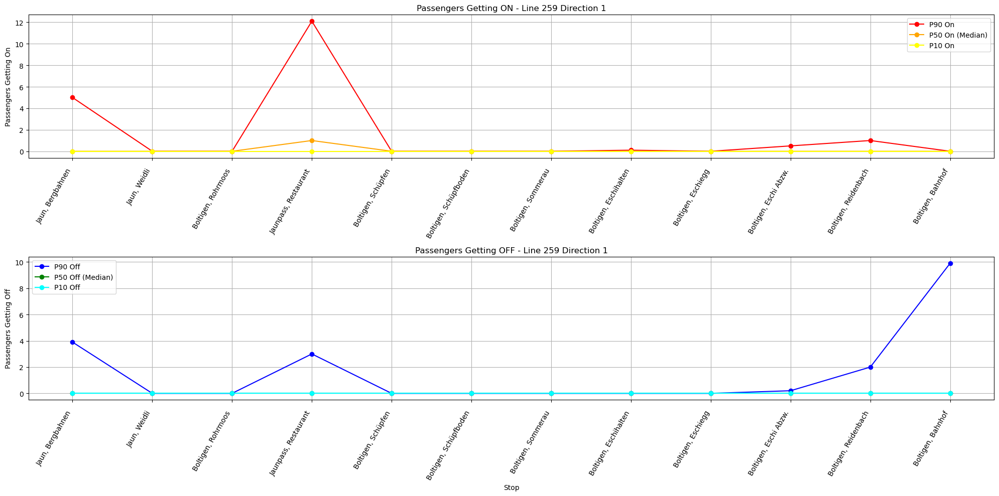

In [76]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_passenger_profile_for_line(occ_df, line_sequences, line, direction=None):
    """
    Plot passenger on/off profile (P90, P50, P10) along the stops of a given line and direction.
    Parameters:
    occ_df: DataFrame (your occ data)
    line_sequences: Your line_sequences dictionary
    line: Line number to visualize
    direction: Direction ID (from your sequence analysis)
    """
    
    # Filter by line
    df_filtered = occ_df[occ_df['Line'] == line].copy()
    
    if df_filtered.empty:
        print(f"❌ No data found for line {line}.")
        return
    
    # Add Direction column using journey_to_sequence mapping
    def get_direction(row):
        journey_key = (row['Day'], row['Journey'])
        if journey_key in journey_to_sequence:
            _, seq_id = journey_to_sequence[journey_key]
            return seq_id
        return 0
    
    df_filtered['Direction'] = df_filtered.apply(get_direction, axis=1)
    
    # Filter by direction if specified
    if direction is not None:
        df_filtered = df_filtered[df_filtered['Direction'] == direction]
        if df_filtered.empty:
            print(f"❌ No data found for line {line}, direction {direction}.")
            return
    
    # Calculate total passengers (first + second class)
    df_filtered['Total_On'] = df_filtered['On_First_Class'] + df_filtered['On_Second_Class']
    df_filtered['Total_Off'] = df_filtered['Off_First_Class'] + df_filtered['Off_Second_Class']
    
    # Add stop names and Didok using the mapping
    stop_id_to_name = dict(zip(stops_metadata['Stop'], stops_metadata['StopName']))
    stop_id_to_didok = dict(zip(stops_metadata['Stop'], stops_metadata['Didok'].astype(str)))
    
    df_filtered['StopName'] = df_filtered['Stop'].map(stop_id_to_name)
    df_filtered['Didok'] = df_filtered['Stop'].map(stop_id_to_didok)
    
    # Group by stop and calculate percentiles
    stop_stats = df_filtered.groupby(['Stop', 'StopName', 'Didok']).agg({
        'Total_On': ['mean', lambda x: x.quantile(0.1), lambda x: x.quantile(0.5), lambda x: x.quantile(0.9)],
        'Total_Off': ['mean', lambda x: x.quantile(0.1), lambda x: x.quantile(0.5), lambda x: x.quantile(0.9)]
    }).round(1)
    
    # Flatten column names
    stop_stats.columns = ['On_Mean', 'On_P10', 'On_P50', 'On_P90', 'Off_Mean', 'Off_P10', 'Off_P50', 'Off_P90']
    stop_stats = stop_stats.reset_index()
    
    # Debug info
    print(f"🔍 Debugging Line {line}, Direction {direction}:")
    print(f"Total filtered records: {len(df_filtered)}")
    print(f"Unique Stops in filtered data: {len(stop_stats)}")
    print(f"Sample Didok IDs in data: {stop_stats['Didok'].head().tolist()}")
    
    # Get the correct order from sequence using Didok IDs
    if direction is not None and line in line_sequences and direction in line_sequences[line]:
        # Get the sequence order (Didok IDs)
        didok_sequence = line_sequences[line][direction]
        print(f"Sequence Didok IDs: {list(didok_sequence)[:5]}...")  # Show first 5
        
        # Create a mapping of Didok to position
        didok_to_position = {str(didok): i for i, didok in enumerate(didok_sequence)}
        
        # Add position column and sort by it
        stop_stats['Position'] = stop_stats['Didok'].map(didok_to_position)
        
        # Debug: Show matching
        matched = stop_stats['Position'].notna().sum()
        print(f"Didok matches found: {matched}/{len(stop_stats)}")
        
        # **NEW: Identify the unmatched Didok**
        unmatched_stops = stop_stats[stop_stats['Position'].isna()]
        if not unmatched_stops.empty:
            print(f"🚨 UNMATCHED DIDOK IDs:")
            for _, row in unmatched_stops.iterrows():
                print(f"   - Didok: {row['Didok']}, Stop: {row['Stop']}, Name: {row['StopName']}")
        
        # **NEW: Check if any sequence Didoks are missing from data**
        data_didoks = set(stop_stats['Didok'].dropna())
        sequence_didoks = set(str(d) for d in didok_sequence)
        missing_in_data = sequence_didoks - data_didoks
        if missing_in_data:
            print(f"🚨 SEQUENCE DIDOKS NOT IN DATA:")
            for didok in missing_in_data:
                print(f"   - Didok: {didok}")
        
        stop_stats = stop_stats.dropna(subset=['Position'])  # Remove stops not in sequence
        stop_stats = stop_stats.sort_values('Position')
        print(f"Stops after sequence ordering: {len(stop_stats)}")
    else:
        # If no direction specified, just sort by Stop (fallback)
        stop_stats = stop_stats.sort_values('Stop')
    
    if stop_stats.empty:
        print("❌ No stops found after filtering and ordering.")
        return
    
    # Plot (rest of the plotting code remains the same)
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(20, 10))
    
    # Plot passengers getting ON
    ax1.plot(stop_stats['StopName'], stop_stats['On_P90'], marker='o', label='P90 On', color='red')
    ax1.plot(stop_stats['StopName'], stop_stats['On_P50'], marker='o', label='P50 On (Median)', color='orange')
    ax1.plot(stop_stats['StopName'], stop_stats['On_P10'], marker='o', label='P10 On', color='yellow')
    ax1.set_title(f"Passengers Getting ON - Line {line}" + (f" Direction {direction}" if direction else ""))
    ax1.set_ylabel("Passengers Getting On")
    ax1.tick_params(axis='x', rotation=60)
    ax1.grid(True)
    ax1.legend()
    
    # Plot passengers getting OFF
    ax2.plot(stop_stats['StopName'], stop_stats['Off_P90'], marker='o', label='P90 Off', color='blue')
    ax2.plot(stop_stats['StopName'], stop_stats['Off_P50'], marker='o', label='P50 Off (Median)', color='green')
    ax2.plot(stop_stats['StopName'], stop_stats['Off_P10'], marker='o', label='P10 Off', color='cyan')
    ax2.set_title(f"Passengers Getting OFF - Line {line}" + (f" Direction {direction}" if direction else ""))
    ax2.set_xlabel("Stop")
    ax2.set_ylabel("Passengers Getting Off")
    ax2.tick_params(axis='x', rotation=60)
    ax2.grid(True)
    ax2.legend()
    
    # Force integer y-axis for both plots
    ax1.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    ax2.yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    
    # Align x-tick labels so their right end aligns with grid lines
    for ax in [ax1, ax2]:
        ax.tick_params(axis='x', rotation=60, which='major', pad=10)
        # Set horizontal alignment to 'right' so text tails align with grid lines
        for label in ax.get_xticklabels():
            label.set_horizontalalignment('right')
    
    plt.tight_layout()
    plt.show()

# Usage:
plot_passenger_profile_for_line(merged_df, line_sequences, line=259, direction=1)

### balanced

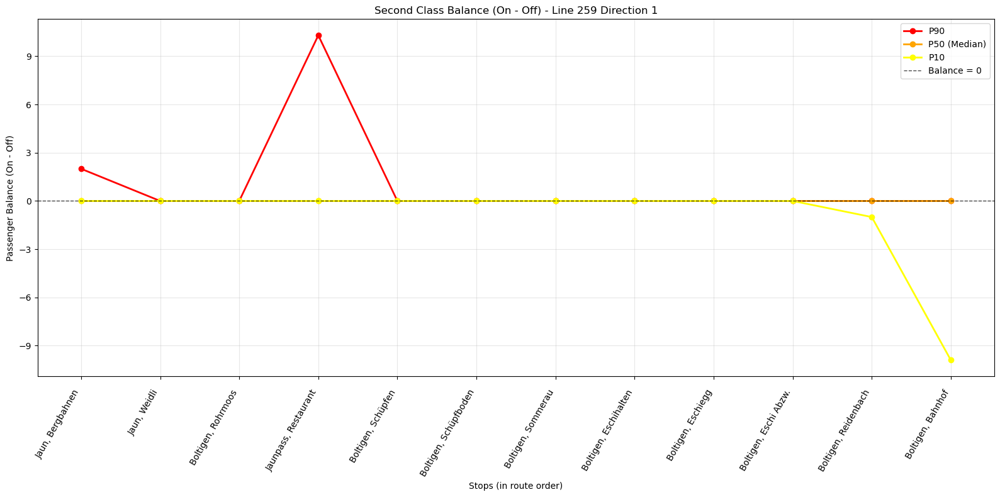

📊 Balance Summary for Line 259 Direction 1
  - Stops analyzed: 12
  - Boarding-dominant stops (P50 > 0): 0
  - Alighting-dominant stops (P50 < 0): 0


In [77]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_passenger_balance_for_line(occ_df, line_sequences, line, direction=None):
    """
    Plot passenger balance (on - off) profile for second class.
    Positive values = more getting on, Negative values = more getting off
    
    Parameters:
    occ_df: DataFrame (your occ data)
    line_sequences: Your line_sequences dictionary
    line: Line number to visualize
    direction: Direction ID (from your sequence analysis)
    """
    
    # Filter by line
    df_filtered = occ_df[occ_df['Line'] == line].copy()
    
    if df_filtered.empty:
        print(f"❌ No data found for line {line}.")
        return
    
    # Add Direction column using journey_to_sequence mapping
    def get_direction(row):
        journey_key = (row['Day'], row['Journey'])
        if journey_key in journey_to_sequence:
            _, seq_id = journey_to_sequence[journey_key]
            return seq_id
        return 0
    
    df_filtered['Direction'] = df_filtered.apply(get_direction, axis=1)
    
    # Filter by direction if specified
    if direction is not None:
        df_filtered = df_filtered[df_filtered['Direction'] == direction]
        if df_filtered.empty:
            print(f"❌ No data found for line {line}, direction {direction}.")
            return
    
    # Calculate balance (on - off) for second class
    df_filtered['Second_Balance'] = df_filtered['On_Second_Class'] - df_filtered['Off_Second_Class']
    
    # Add stop names and Didok using the mapping
    stop_id_to_name = dict(zip(stops_metadata['Stop'], stops_metadata['StopName']))
    stop_id_to_didok = dict(zip(stops_metadata['Stop'], stops_metadata['Didok'].astype(str)))
    
    df_filtered['StopName'] = df_filtered['Stop'].map(stop_id_to_name)
    df_filtered['Didok'] = df_filtered['Stop'].map(stop_id_to_didok)
    
    # Group by stop and calculate percentiles
    stop_stats = df_filtered.groupby(['Stop', 'StopName', 'Didok']).agg({
        'Second_Balance': [lambda x: x.quantile(0.1), lambda x: x.quantile(0.5), lambda x: x.quantile(0.9)]
    }).round(1)
    
    # Flatten column names
    stop_stats.columns = ['Second_P10', 'Second_P50', 'Second_P90']
    stop_stats = stop_stats.reset_index()
    
    # Get sequence order using Didok IDs if direction specified
    if direction is not None and line in line_sequences and direction in line_sequences[line]:
        # Get the sequence order (Didok IDs)
        didok_sequence = line_sequences[line][direction]
        
        # Create a mapping of Didok to position
        didok_to_position = {str(didok): i for i, didok in enumerate(didok_sequence)}
        
        # Add position column and sort by it
        stop_stats['Position'] = stop_stats['Didok'].map(didok_to_position)
        stop_stats = stop_stats.dropna(subset=['Position'])
        stop_stats = stop_stats.sort_values('Position')
    else:
        # If no direction specified, sort by Stop (fallback)
        stop_stats = stop_stats.sort_values('Stop')
    
    if stop_stats.empty:
        print("❌ No stops found after filtering and ordering.")
        return
    
    # Create single plot for second class
    plt.figure(figsize=(16, 8))
    
    plt.plot(stop_stats['StopName'], stop_stats['Second_P90'], marker='o', label='P90', color='red', linewidth=2, markersize=6)
    plt.plot(stop_stats['StopName'], stop_stats['Second_P50'], marker='o', label='P50 (Median)', color='orange', linewidth=2, markersize=6)
    plt.plot(stop_stats['StopName'], stop_stats['Second_P10'], marker='o', label='P10', color='yellow', linewidth=2, markersize=6)
    
    # Zero line for reference
    plt.axhline(y=0, color='black', linestyle='--', alpha=0.7, linewidth=1, label='Balance = 0')
    
    plt.title(f"Second Class Balance (On - Off) - Line {line}" + (f" Direction {direction}" if direction else ""))
    plt.xlabel("Stops (in route order)")
    plt.ylabel("Passenger Balance (On - Off)")
    plt.xticks(rotation=60)
    plt.grid(True, alpha=0.3)
    plt.legend()
    
    # Align x-tick labels so their right end aligns with grid lines
    plt.gca().tick_params(axis='x', rotation=60, which='major', pad=10)
    for label in plt.gca().get_xticklabels():
        label.set_horizontalalignment('right')
    
    plt.gca().yaxis.set_major_locator(plt.MaxNLocator(integer=True))
    plt.tight_layout()
    plt.show()
    
    # Print summary
    print(f"📊 Balance Summary for Line {line}" + (f" Direction {direction}" if direction else ""))
    print(f"  - Stops analyzed: {len(stop_stats)}")
    
    # Identify boarding vs alighting dominant stops
    boarding_stops = stop_stats[stop_stats['Second_P50'] > 0]
    alighting_stops = stop_stats[stop_stats['Second_P50'] < 0]
    
    print(f"  - Boarding-dominant stops (P50 > 0): {len(boarding_stops)}")
    print(f"  - Alighting-dominant stops (P50 < 0): {len(alighting_stops)}")
    
    if len(boarding_stops) > 0:
        max_boarding = boarding_stops.loc[boarding_stops['Second_P50'].idxmax()]
        print(f"  - Highest boarding: {max_boarding['StopName']} (+{max_boarding['Second_P50']:.1f} median)")
    
    if len(alighting_stops) > 0:
        max_alighting = alighting_stops.loc[alighting_stops['Second_P50'].idxmin()]
        print(f"  - Highest alighting: {max_alighting['StopName']} ({max_alighting['Second_P50']:.1f} median)")

# Usage:
plot_passenger_balance_for_line(merged_df, line_sequences, line=259, direction=1)

In [78]:
# Demand per stop on a regular day (lu-ve-scol)
on_per_stop = {stop_id: df_stop.On_Second_Class.sum() for stop_id, df_stop in occ.groupby('Stop', as_index=False, group_keys=False)}
off_per_stop = {stop_id: df_stop.Off_Second_Class.sum() for stop_id, df_stop in occ.groupby('Stop', as_index=False, group_keys=False)}
stops_metadata["On_Second_Class"] = stops_metadata["Stop"].map(on_per_stop)
stops_metadata["Off_Second_Class"] = stops_metadata["Stop"].map(off_per_stop)

In [79]:
stops_metadata.nlargest(20, 'On_Second_Class')

,Stop,StopName,Didok,Platform,Short_Name,Latitude,Longitude,Average_Delay_Seconds,P90_Delay_Seconds,P50_Delay_Seconds,P10_Delay_Seconds,Line,Line_Avg_Delay_Seconds,Line_P90_Delay_Seconds,Line_P50_Delay_Seconds,Line_P10_Delay_Seconds,On_Second_Class,Off_Second_Class
3270,859237413,"Fribourg/Freiburg, Pl. Gare",8592374,13,Gare,46.803035,7.151739,94.260339,217.0,61.0,-12.0,1.0,73.480127,195.0,43.0,-8.0,162051.34,187337.30
3271,859237413,"Fribourg/Freiburg, Pl. Gare",8592374,13,Gare,46.803035,7.151739,94.260339,217.0,61.0,-12.0,2.0,96.852729,225.0,67.0,-8.0,162051.34,187337.30
3272,859237413,"Fribourg/Freiburg, Pl. Gare",8592374,13,Gare,46.803035,7.151739,94.260339,217.0,61.0,-12.0,3.0,98.210648,199.0,91.0,-2.3,162051.34,187337.30
3273,859237413,"Fribourg/Freiburg, Pl. Gare",8592374,13,Gare,46.803035,7.151739,94.260339,217.0,61.0,-12.0,4.0,28.500000,59.3,28.5,-2.3,162051.34,187337.30
3274,859237413,"Fribourg/Freiburg, Pl. Gare",8592374,13,Gare,46.803035,7.151739,94.260339,217.0,61.0,-12.0,5.0,34.314873,120.0,17.0,-30.0,162051.34,187337.30
3275,859237413,"Fribourg/Freiburg, Pl. Gare",8592374,13,Gare,46.803035,7.151739,94.260339,217.0,61.0,-12.0,6.0,143.604330,286.8,63.0,-23.8,162051.34,187337.30
3276,859237413,"Fribourg/Freiburg, Pl. Gare",8592374,13,Gare,46.803035,7.151739,94.260339,217.0,61.0,-12.0,8.0,82.845708,189.0,68.0,1.0,162051.34,187337.30
3277,859237413,"Fribourg/Freiburg, Pl. Gare",8592374,13,Gare,46.803035,7.151739,94.260339,217.0,61.0,-12.0,9.0,169.438150,309.6,135.0,7.0,162051.34,187337.30
3278,859237413,"Fribourg/Freiburg, Pl. Gare",8592374,13,Gare,46.803035,7.151739,94.260339,217.0,61.0,-12.0,10.0,196.895954,393.6,171.0,14.4,162051.34,187337.30
3279,859237413,"Fribourg/Freiburg, Pl. Gare",8592374,13,Gare,46.803035,7.151739,94.260339,217.0,61.0,-12.0,123.0,467.500000,802.3,467.5,132.7,162051.34,187337.30


In [80]:
# fig, ax = plt.subplots(dpi=300)

# scatter = ax.scatter(stops_metadata.nlargest(20, 'On_Second_Class').Longitude,
#                      stops_metadata.nlargest(20, 'On_Second_Class').Latitude, s=15, zorder=2, cmap='Reds',
#                      c=stops_metadata.nlargest(20, 'On_Second_Class').On_Second_Class, edgecolors='k', linewidths=0.5)
# cbar = plt.colorbar(scatter)
# cbar.set_label("Passengers (pax)")
# cx.add_basemap(ax=ax, crs=epsg_proj, source=tile_provider, zorder=1)
# ax.set_title("Top 20 stations with more people boarding")
# plt.show()

In [81]:
# fig, ax = plt.subplots(dpi=300)

# scatter = ax.scatter(stops_metadata.nlargest(20, 'Off_Second_Class').Longitude,
#                      stops_metadata.nlargest(20, 'Off_Second_Class').Latitude, s=15, zorder=2, cmap='Reds',
#                      c=stops_metadata.nlargest(20, 'Off_Second_Class').Off_Second_Class, edgecolors='k', linewidths=0.5)
# cbar = plt.colorbar(scatter)
# cbar.set_label("Passengers (pax)")
# cx.add_basemap(ax=ax, crs=epsg_proj, source=tile_provider, zorder=1)
# ax.set_title("Top 20 stations with more people alighting")
# plt.show()

In [82]:
# Which lines have the highest delays?
delay_per_line = {}
for line, df_line in plcs.groupby('Line', as_index=False, group_keys=False):
    valid_journeys = [v for v in df_line.Journey.unique() if str(v)[:2] != '99']
    if valid_journeys:
        delay_per_line[line] = df_line[df_line.Journey.isin(valid_journeys)].Punctuality_Seconds.mean()


In [83]:
delay_per_line = {str(int(k)): v for k, v in delay_per_line.items()} # Convert keys to strings
delay_per_line = dict(sorted(delay_per_line.items(), key=lambda item: item[1], reverse=True))  # Sort by values in descending order

In [84]:
delay_per_line

{'904': 561.2777777777778,
 '361': 373.16759493670884,
 '541': 243.19281045751634,
 '331': 224.3357142857143,
 '245': 221.44055798459297,
 '917': 215.77805800756622,
 '142': 213.62,
 '223': 197.19004524886878,
 '559': 195.05574912891987,
 '470': 177.38243323004278,
 '555': 177.35600073515897,
 '6': 176.89982935382878,
 '545': 173.82370038199633,
 '336': 172.89844264093003,
 '337': 168.67073170731706,
 '259': 165.1718875502008,
 '145': 155.80913978494624,
 '362': 155.368,
 '472': 155.07814313346228,
 '11': 151.66599114313593,
 '544': 150.8699249198986,
 '10': 149.87663345171188,
 '120': 148.2280701754386,
 '471': 145.78183050847457,
 '258': 144.57597831611045,
 '123': 143.95867269984916,
 '9': 141.953541575011,
 '234': 140.8193936462836,
 '922': 139.04580152671755,
 '233': 136.4928509406657,
 '473': 134.1619294096649,
 '552': 134.04683698296836,
 '182': 133.5987766572987,
 '124': 133.37740718681755,
 '141': 131.06572769953053,
 '202': 128.77184241377182,
 '181': 127.50932418320156,
 '23

/var/folders/58/tx0yktsx2rn9t9y3z4q7lcmc0000gn/T/ipykernel_1619/2176486565.py:6: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_xticklabels(ax.get_xticklabels(), rotation=45,  ha='right')


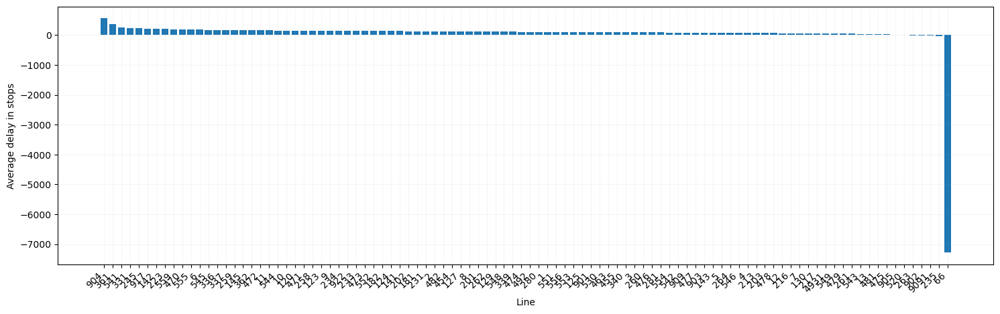

In [85]:
# Create bar plot
fig, ax = plt.subplots(figsize=(18, 5))
ax.bar(delay_per_line.keys(), delay_per_line.values())
ax.set_xlabel("Line")
ax.set_ylabel("Average delay in stops")
ax.set_xticklabels(ax.get_xticklabels(), rotation=45,  ha='right')
ax.grid(alpha=0.1)
plt.show()

## LINE analysis

### Print information

In [86]:
line = 1  

print(f"\n========== Line {line} Direction Duration Summary ==========\n")

# enumerate
for direction in sorted(journeys_per_line.get(line, {}).keys()):
    print(f"🧭 Direction {direction}:")

    journeys = journeys_per_line.get(line, {}).get(direction, [])
    stops = stops_per_line.get(line, {}).get(direction, [])
    if not journeys or not stops:
        print("  🚫 No data for this direction.\n")
        continue

    durations = []
    for day, journey in journeys:
        df_j = plcs[
            (plcs['Line'] == line) &
            (plcs['Day'] == day) &
            (plcs['Journey'] == journey)
        ]
        df_j = df_j.sort_values('StopSeq')  # or 'StopOrder'

        # begin and end stop
        df_start = df_j[df_j['Stop'] == stops[0]]
        df_end = df_j[df_j['Stop'] == stops[-1]]

        if df_start.empty or df_end.empty:
            continue  

        try:
            t_depart = pd.to_datetime(df_start['Departure'].values[0])
            t_arrive = pd.to_datetime(df_end['Arrival'].values[0])
            duration = (t_arrive - t_depart).total_seconds() / 60
            durations.append(duration)
            print(f"    - {day}, Journey {int(journey)}: {duration:.1f} min")
        except Exception as e:
            print(f"    ⚠️ Error in {day}, Journey {int(journey)}: {e}")

    if durations:
        print(f"\n  ✅ Summary for Direction {direction}:")
        print(f"    • Avg duration: {np.mean(durations):.1f} min")
        print(f"    • Min duration: {np.min(durations):.1f} min")
        print(f"    • Max duration: {np.max(durations):.1f} min")
        print(f"    • Journey count: {len(durations)}")
    else:
        print("  ⚠️ No valid time data available.")

    print("\n" + "="*50 + "\n")


========== Line 1 Direction Duration Summary ==========



### Blue plot

In [87]:
line = 259
directions = sorted(stops_per_line[line].keys())
num_directions = len(directions)

fig, axes = plt.subplots(num_directions, 1, dpi=300, figsize=(15, 5 * num_directions), squeeze=False)

for i, direction in enumerate(directions):
    ax = axes[i][0]  # 2D array from subplots
    xticks, xtickslabels = [], []

    stop_seq = stops_per_line[line][direction]
    if stop_seq:
        # filter for journeys
        filter_journeys = plcs[['Day', 'Journey']].apply(tuple, axis=1).isin(journeys_per_line[line][direction])
        filter_mask = plcs['Line'] == line & filter_journeys

        for j, stop_id in enumerate(stop_seq):
            avg_delay = plcs[
                (plcs['Line'] == line) &
                (plcs['Stop'] == stop_id) &
                filter_journeys
            ]['Punctuality_Seconds'].mean()

            ax.bar(j, avg_delay, color='tab:blue')

            # get stop name
            name_match = stops_metadata[stops_metadata.Stop == stop_id]
            if not name_match.empty:
                xtickslabels.append(name_match.StopName.values[0])
            else:
                xtickslabels.append(str(stop_id))  # fallback

            xticks.append(j)

        ax.set_xticks(xticks)
        ax.set_xticklabels(xtickslabels, rotation=45, ha='right')
        ax.set_ylabel('Average delay (s)')
        ax.set_title(f"Direction {direction}: {xtickslabels[0]} → {xtickslabels[-1]}")

fig.suptitle(f'Line {line}: Average delay at each stop (All Directions)', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

KeyError: 259

In [ ]:
stops_per_line[1]
# journeys_per_line[904]

{1: [858723802.0,
  859237902.0,
  859237002.0,
  859236902.0,
  857782002.0,
  857781202.0,
  859238202.0,
  857781102.0,
  857781002.0,
  858916102.0],
 2: [858916102.0,
  859237412.0,
  858915502.0,
  858885802.0,
  858915402.0,
  857774102.0,
  858914802.0,
  850463102.0,
  857774211.0,
  850497502.0,
  850486202.0,
  857774301.0],
 3: [857774301.0,
  850486201.0,
  850497501.0,
  857774213.0,
  850463101.0,
  858914901.0,
  858914801.0,
  857774101.0,
  857774101.0,
  858915401.0,
  858885801.0,
  858915501.0,
  859237413.0,
  858916101.0,
  858725501.0,
  858914201.0,
  858916401.0,
  858916305.0,
  858913901.0,
  858917701.0,
  858917601.0,
  858917502.0],
 4: [857774301.0,
  850486201.0,
  850497501.0,
  857774213.0,
  850463101.0,
  858914901.0,
  858914801.0,
  857774101.0,
  858915401.0,
  858885801.0,
  858915501.0,
  859237413.0,
  858916101.0,
  858725501.0,
  858914201.0,
  858916401.0,
  858916305.0,
  858913901.0,
  858917701.0,
  858917601.0],
 5: [858917502.0,
  8589

In [ ]:
print(plcs[plcs.Line == 1]['Journey'])

1999       61114.0
2000       61114.0
2001       61114.0
2002       61114.0
2003       61114.0
            ...   
2085010    61822.0
2085011    61822.0
2085012    61822.0
2085013    61822.0
2085014    61822.0
Name: Journey, Length: 152696, dtype: float64


### Green & Red Plot

In [ ]:


line = 1
directions = sorted(stops_per_line[line].keys())
num_directions = len(directions)

fig, axes = plt.subplots(num_directions, 1, dpi=300, figsize=(15, 5 * num_directions), squeeze=False)

for i, direction in enumerate(directions):
    ax = axes[i][0]
    xticks, xtickslabels = [], []

    stop_seq = stops_per_line[line][direction]
    if stop_seq:

        filter_journeys = occ[['Day', 'Journey']].apply(tuple, axis=1).isin(journeys_per_line[line][direction])

        for j, stop_id in enumerate(stop_seq):
            on_val = occ[(occ['Stop'] == stop_id) & filter_journeys]['On_Second_Class'].mean()
            off_val = occ[(occ['Stop'] == stop_id) & filter_journeys]['Off_Second_Class'].mean()

            ax.bar(j - 0.1, on_val, color='tab:green', width=0.2, label='Boarding' if j == 0 else "")
            ax.bar(j + 0.1, off_val, color='tab:red', width=0.2, label='Alighting' if j == 0 else "")

            # get stop name
            name_match = stops_metadata[stops_metadata.Stop == stop_id]
            if not name_match.empty:
                xtickslabels.append(name_match.StopName.values[0])
            else:
                xtickslabels.append(str(stop_id))
            xticks.append(j)

        ax.set_xticks(xticks)
        ax.set_xticklabels(xtickslabels, rotation=45, ha='right')
        ax.set_ylabel('Passengers (pax)')
        ax.set_title(f"Direction {direction}: {xtickslabels[0]} → {xtickslabels[-1]}")
        ax.legend()

fig.suptitle(f'Line {line}: Avg passengers boarding & alighting at each stop (all directions)', fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

KeyError: 1

### Geographical plot

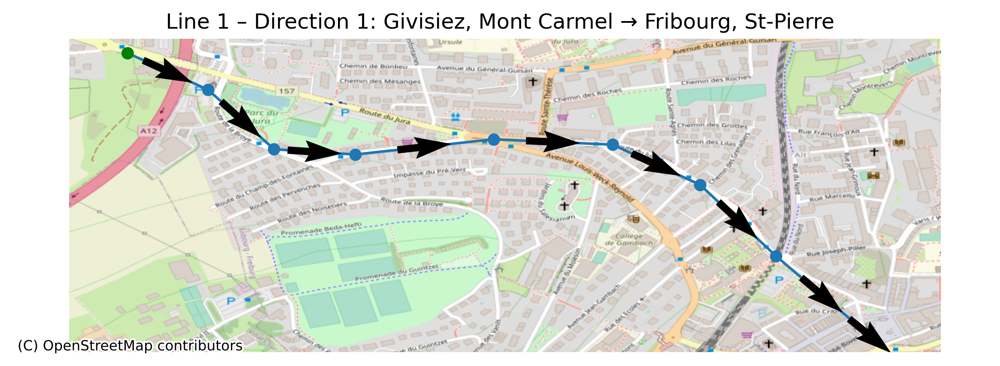

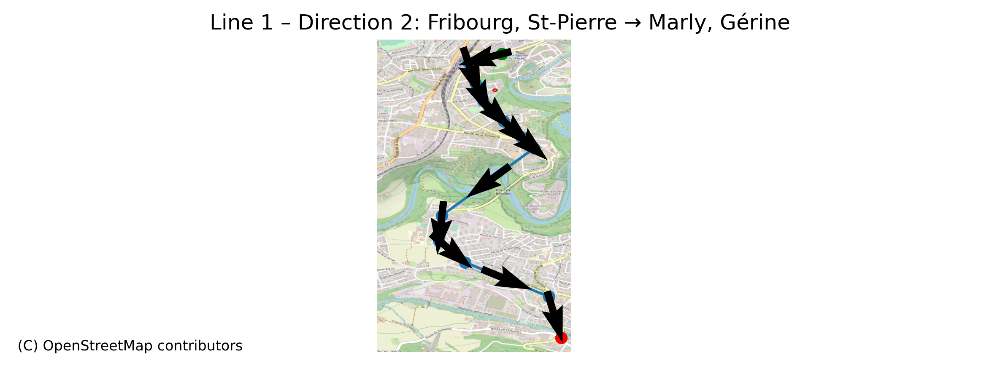

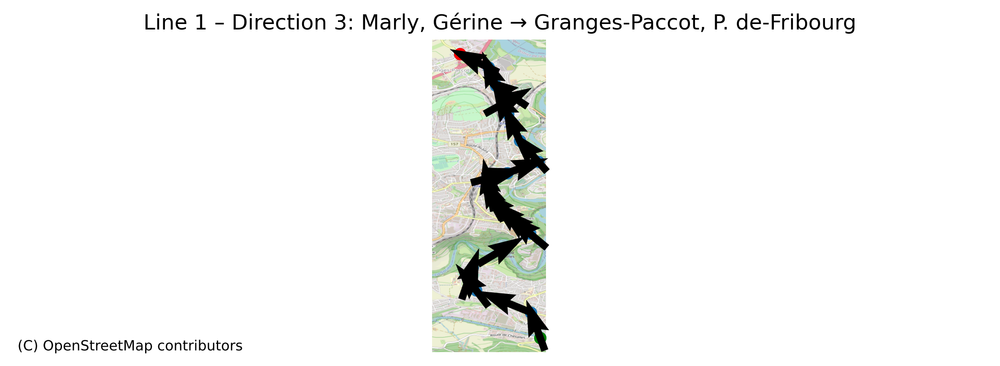

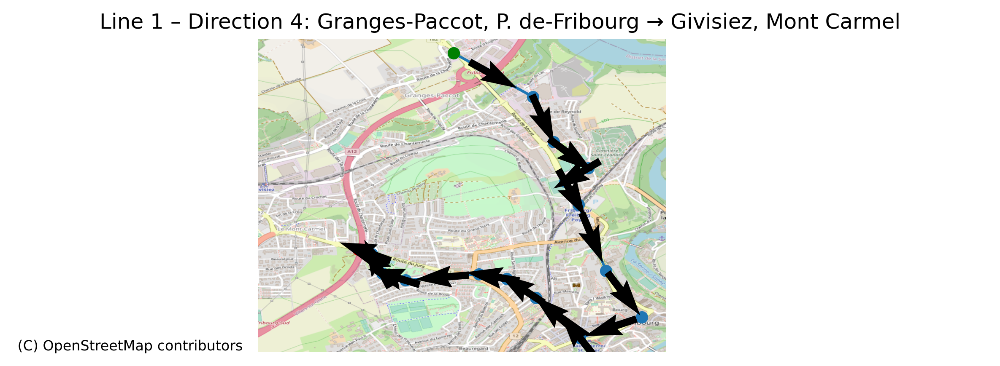

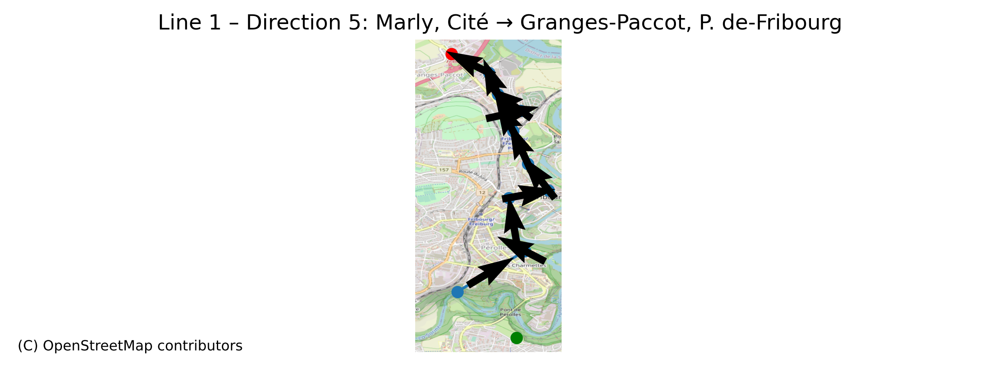

...

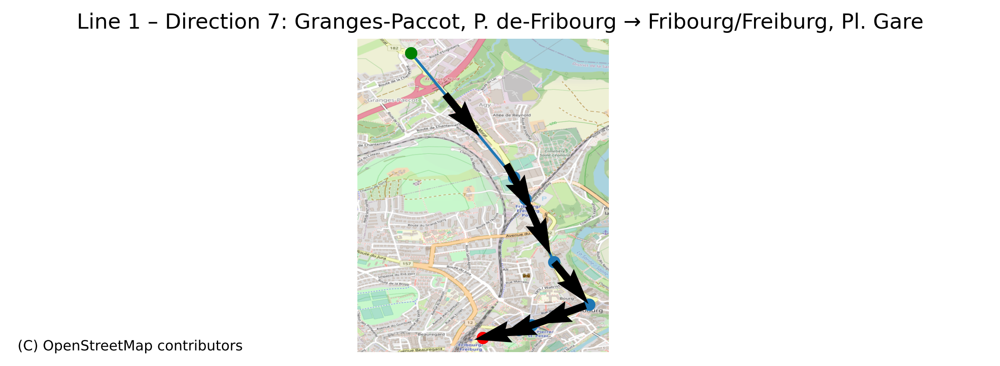

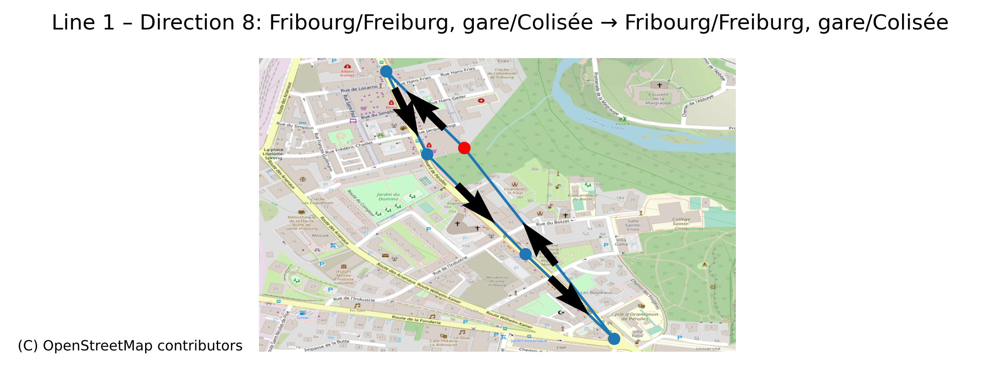

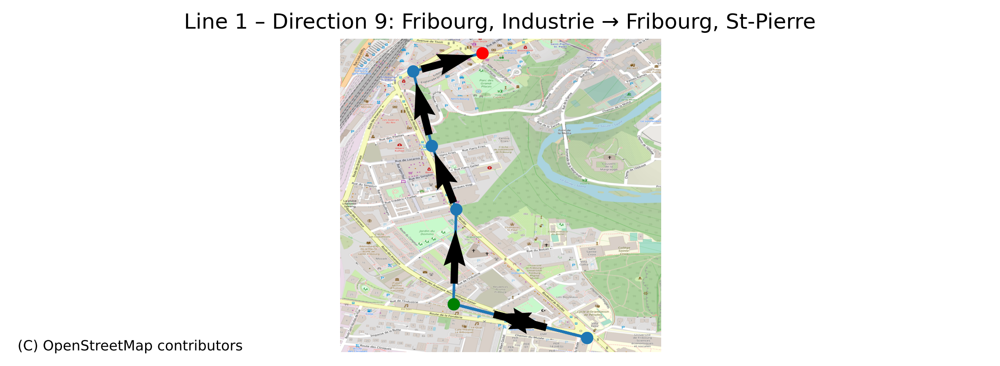

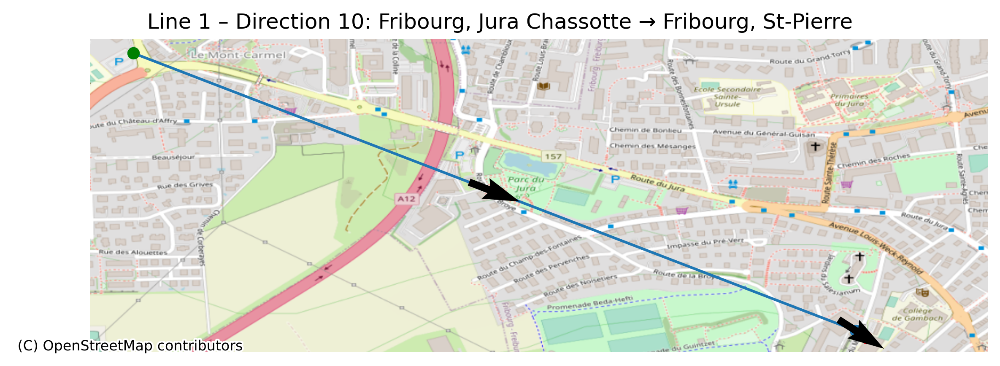

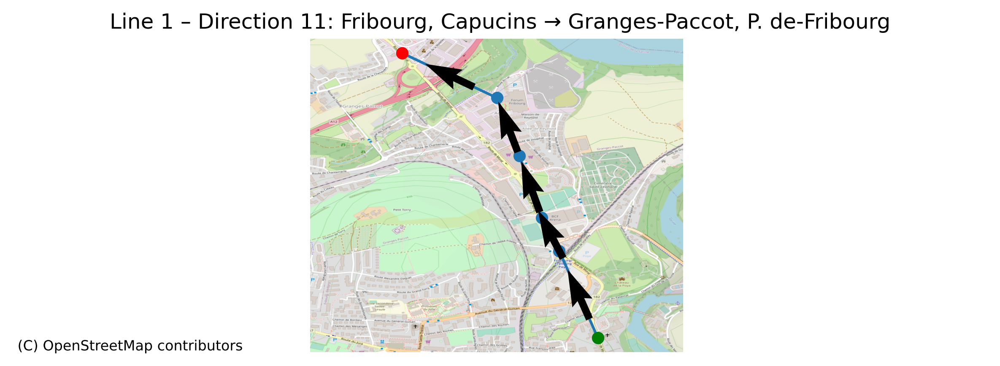

In [ ]:
line = 1
directions = sorted(stops_per_line[line].keys())
filter_line = (plcs.Line == line)

for direction in directions:
    stop_seq = stops_per_line[line][direction]
    if not stop_seq or len(stop_seq) < 2:
        continue

    filter_journeys = plcs[['Day', 'Journey']].apply(tuple, axis=1).isin(journeys_per_line[line][direction])
    x, y = [], []

    for stop in stop_seq:
        lon = plcs[filter_line & filter_journeys & (plcs.Stop == stop)].Longitude.mean()
        lat = plcs[filter_line & filter_journeys & (plcs.Stop == stop)].Latitude.mean()
        x.append(lon)
        y.append(lat)

    fig, ax = plt.subplots(figsize=(8, 3), dpi=300)

    ax.plot(x, y, zorder=2)
    ax.scatter(x, y, zorder=2)
    ax.scatter(x[0], y[0], zorder=2, c='g', label='Start')
    ax.scatter(x[-1], y[-1], zorder=2, c='r', label='End')

    u = np.diff(x)
    v = np.diff(y)
    norm = np.sqrt(u**2 + v**2)
    ax.quiver(x[:-1] + u/2, y[:-1] + v/2, u/norm, v/norm, angles="xy", zorder=3, pivot="mid")

    stop1 = stops_metadata[stops_metadata.Stop == stop_seq[0]].StopName.values[0]
    stop2 = stops_metadata[stops_metadata.Stop == stop_seq[-1]].StopName.values[0]
    ax.set_title(f"Line {int(line)} – Direction {direction}: {stop1} → {stop2}")

    ax.set_aspect('equal', adjustable='datalim')  
    ax.axis('off')

    cx.add_basemap(ax=ax, crs=epsg_proj, source=tile_provider, zorder=1)

    plt.tight_layout()
    plt.show()

In [ ]:
# Learnings

# Journey ID is not unique, it can be repeated in different days. So when filtering, it has to be done by (day, journey)
# JourneySeq refers to the Vehicle Number, so it's the trip sequence number per vehicle
# Stop Seq refers to the stop sequence in a journey

# It also seems that for each Vehicle Number, the first and the last trips start with 99, meaning empty
# Stop in plcs seems to be the quai (didok + 01/02). Stop is 9 numbers (11 char + '.0'). Didok is 7 numbers
# Stops starting with '99' are not used anymore and they have been dismantled


In [ ]:
# It seems the area around Rosé has very high average delays. And it is the area that gaelle mentioned
